In [1]:
import numpy as np
from scipy.stats import norm, uniform
from scipy.interpolate import interp1d
from matplotlib import pyplot as plt
from operator import itemgetter
from scipy.integrate import simps
import emcee 
import corner
import time
import os
from multiprocessing import Pool
from multiprocessing import cpu_count
import warnings
warnings.filterwarnings('ignore')
ncpu = cpu_count()
print(f"{ncpu} CPUs") 

16 CPUs


In [2]:
from os.path import join, abspath
import sys
from os import pardir, mkdir
import vaex

# import utils
root_dir = abspath(pardir)
sys.path.insert(0, root_dir)
root_data_dir = join(root_dir, "Data")

In [3]:
from utils import log_nu_mod

In [4]:
def plot_chain(sampler, labels, figsize=(10, 7), alpha=0.3, start=0):
    num = len(labels)
    fig, axes = plt.subplots(num, figsize=figsize, sharex=True)
    if len(labels) == 1:
      axes = [axes]
    samples = sampler.get_chain()
    for i in range(num):
        ax = axes[i]
        ax.plot(samples[start:, :, i], "k", alpha=alpha)
        ax.set_xlim(0, len(samples[start:, :, i]))
        ax.set_ylabel(labels[i])
        ax.yaxis.set_label_coords(-0.1, 0.5)
    axes[-1].set_xlabel("step number")

In [5]:
name = "Baryon"
data_dir = join(root_data_dir, name)
df_baryon = vaex.open(join(data_dir, "baryon.hdf5"))
df_baryon

#,components,rho,e_rho,sigma_z,e_sigma_z
0,Molecular gas (H2),0.0104,0.00312,3.7,0.2
1,Cold atomic gas (HI(1)),0.0277,0.00554,7.1,0.5
2,Warm atomic gas (HI(2)),0.0073,0.0007,22.1,2.4
3,Hot ionized gas (HII),0.0005,3e-05,39.0,4.0
4,Giant stars,0.0006,6e-05,15.5,1.6
...,...,...,...,...,...
7,4 < MV < 5,0.0029,0.00029,18.0,1.8
8,5 < MV < 8,0.0072,0.00072,18.5,1.9
9,MV > 8,0.0216,0.0028,18.5,4.0
10,White dwarfs,0.0056,0.001,20.0,5.0


In [6]:
rhos = df_baryon["rho"].to_numpy()  # Msun/pc^3
sigmaz = df_baryon["sigma_z"].to_numpy() # km/s
sigma_rhos = df_baryon["e_rho"].to_numpy()
sigma_sigmaz = df_baryon["e_sigma_z"].to_numpy()

# Just $\nu(z)$

In [7]:
# test the following dark values
rhoDM = 0.016 # Msun/pc^3
sigmaDD = 0 # Msun/pc^2
hDD = 20 # pc
Nu0 = np.exp(5)
zsun = 10 # kpc
sigma_w = 5 # km/s
w0 = -7 # km/s
R = 3.4E-3 # Msun/pc^3
N0 = 1

zz = np.linspace(-200, 200, 50)

theta_dict = dict(rhos=rhos, sigmaz=sigmaz, rhoDM=rhoDM, sigmaDD=7, hDD=hDD, Nu0=Nu0, zsun=zsun, R=R, sigma_w=sigma_w, w0=w0, N0=N0)
logNu_DD = log_nu_mod(zz, **theta_dict)
theta_dict['sigmaDD'] = sigmaDD
logNu = log_nu_mod(zz, **theta_dict)

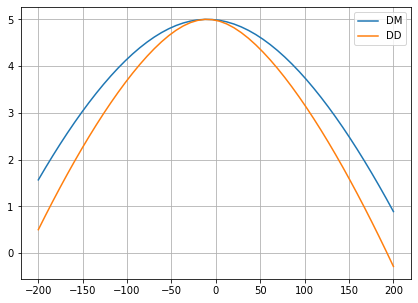

In [9]:
plt.figure(figsize=(7,5))
plt.plot(zz, logNu, label="DM")
plt.plot(zz, logNu_DD, label="DD")
plt.grid()
plt.legend()
plt.show()

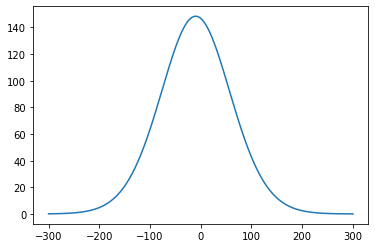

In [10]:
density = lambda z, **theta: np.exp(log_nu_mod(z, **theta))

z = np.linspace(-300, 300, 1000)
nu = density(z, **theta_dict)
plt.plot(z, nu)

Vol = 26005.87835150014


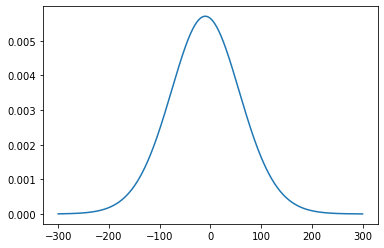

In [11]:
Vol = np.trapz(nu, z)
print("Vol = {0}".format(Vol))

density_pdf = lambda z, **theta: density(z, **theta)/Vol

nu_pdf = density_pdf(z, **theta_dict)

plt.plot(z, nu_pdf)
plt.show()

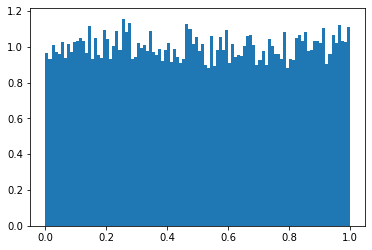

In [12]:
z_rand = np.random.rand(np.floor(Vol).astype(int))
plt.hist(z_rand, bins=100, density=True)
plt.show()

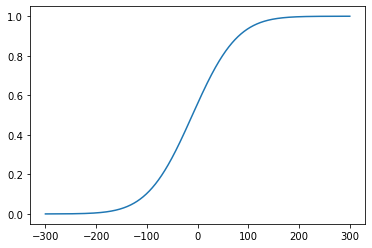

In [13]:
cdf_z = np.cumsum(nu_pdf)
cdf_z /= cdf_z[-1]
cdf_z = np.unique(cdf_z)
zz = z[:len(cdf_z)]

plt.plot(zz, cdf_z)
plt.show()

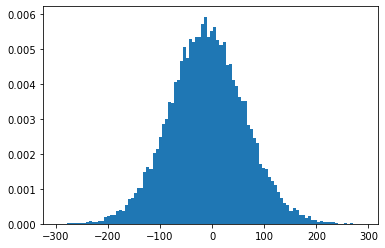

In [14]:
inverse_cdf_z = interp1d(cdf_z, zz, kind="quadratic", fill_value="extrapolate")

zs = inverse_cdf_z(z_rand)
plt.hist(zs, bins=100, density=True)
plt.show()

In [185]:
def safe_log(x):
    return np.select([x > 0, x <= 0], [np.log(x), -np.inf])

# histogram
def generate_pdf(z, theta):
  Wz = density(z, theta)
  density_z = interp1d(z, Wz)
  return density_z(z)

def log_likelihood(data, **theta):
  z = data
  znum, zedge, zerr = z
  zmid = (zedge[1:] + zedge[:-1]) / 2
  density_z = generate_pdf(zmid, theta)
  probz = np.nan_to_num(norm.logpdf(znum, loc=density_z, scale=zerr), nan=0)
  return np.sum(probz)
  

In [31]:
# inhomogenous poisson proccess
def log_likelihood(data, **theta):
  z = data
  zz = np.linspace(-350, 350, 1000)
  dz = zz[1]-zz[0]
  pdf = density(zz, **theta)
  integral = np.trapz(pdf)
  log = np.log(density(z, **theta)*dz)
  return np.sum(log) - integral
  

In [27]:
# theta_names = ['rhos', 'sigmaz', 'rhoDM', 'sigmaDD', 'hDD', 'Nu0', 'zsun', 'R', 'sigma_w', 'w0', 'N0']
theta_uniform = ['zsun', 'log_rhoDM', 'log_Nu0']
theta_gaussian = ['R']
theta_names = theta_uniform + theta_gaussian

# uniform prior
def log_prior(**pars):
  theta, loc, scale = pars['theta'], pars['loc'], pars['scale']
  uniform_args = dict(x=[], loc=[], scale=[])
  for t in theta_uniform:
    uniform_args['x'].append(theta[t])
    uniform_args['loc'].append(loc[t])
    uniform_args['scale'].append(scale[t])
  gaussian_args = dict(x=[], loc=[], scale=[])
  for t in theta_gaussian:
    gaussian_args['x'].append(theta[t])
    gaussian_args['loc'].append(loc[t])
    gaussian_args['scale'].append(scale[t])
  log_args = dict(x=[], loc=[], scale=[])

  val_uniform = np.sum(uniform.logpdf(**uniform_args))
  val_gaussian = np.sum(norm.logpdf(**gaussian_args))
  return val_uniform + val_gaussian

def log_posterior(x: np.ndarray, data: np.ndarray, priors: dict):
  theta = {t: x[i] for i, t in enumerate(theta_names)}
  pars = dict(theta=theta, **priors)
  log_prior_ = log_prior(**pars)
  if np.isinf(log_prior_) or np.isnan(log_prior_):
    return -np.inf
  theta['sigmaDD'] = 0
  theta['hDD'] = 1
  theta['sigma_w'] = sigma_w
  theta['sigmaz'] = sigmaz
  theta['rhos'] = rhos
  theta['rhoDM'] = np.exp(theta['log_rhoDM'])
  theta['Nu0'] = np.exp(theta['log_Nu0'])
  return log_prior_ + log_likelihood(data, **theta)

In [247]:
# test
# ['rhoDM', 'Nu0', 'zsun', 'R', 'sigma_w']

zedge = np.linspace(-200, 200, 50)
dz = zedge[1] - zedge[0]
znum, _ = np.histogram(zs, bins=zedge)
zerr = np.sqrt(znum)
znum, zerr = znum/dz, zerr/dz
data=(znum, zedge, zerr)

loc = dict(zsun=zsun-20, R=3.4E-3, rhoDM=0.001, Nu0=Nu0*.9)
scale = dict(zsun=40, R=0.6E-3, rhoDM=0.03, Nu0=Nu0*.2)
priors=dict(loc=loc, scale=scale)

# rhoDM = 0.016 # Msun/pc^3
# sigmaDD = 0 # Msun/pc^2
# hDD = 20 # pc
# Nu0 = np.exp(5)
# zsun = 10 # kpc
# sigma_w = 5 # km/s
# w0 = -7 # km/s
# R = 3.4E-3 #

theta = np.array([zsun, R, rhoDM, Nu0])
theta_dict = {t: theta[i] for i, t in enumerate(theta_names)}
pars = dict(theta=theta_dict, **priors)
pars

{'theta': {'zsun': 10.0,
  'R': 0.0034,
  'rhoDM': 0.016,
  'Nu0': 148.4131591025766},
 'loc': {'zsun': -10, 'R': 0.0034, 'rhoDM': 0.001, 'Nu0': 133.57184319231894},
 'scale': {'zsun': 40, 'R': 0.0006, 'rhoDM': 0.03, 'Nu0': 29.682631820515322}}

In [38]:
# test
mask = np.abs(zs) < 200
data = zs[mask]

loc = dict(zsun=zsun-20, log_rhoDM=np.log(0.001), log_Nu0=np.log(Nu0*.3), R=3.4E-3,)
scale = dict(zsun=40, log_rhoDM=np.log(0.1/0.001), log_Nu0=np.log(1.3/0.3), R=0.6E-3)
priors=dict(loc=loc, scale=scale)

theta = np.array([zsun, np.log(rhoDM), np.log(Nu0), R])
theta_dict = {t: theta[i] for i, t in enumerate(theta_names)}
pars = dict(theta=theta_dict, **priors)
pars

{'theta': {'zsun': 10.0,
  'log_rhoDM': -4.135166556742356,
  'log_Nu0': 5.0,
  'R': 0.0034},
 'loc': {'zsun': -10,
  'log_rhoDM': -6.907755278982137,
  'log_Nu0': 3.796027195674064,
  'R': 0.0034},
 'scale': {'zsun': 40,
  'log_rhoDM': 4.605170185988092,
  'log_Nu0': 1.4663370687934272,
  'R': 0.0006}}

In [39]:
log_prior(**pars)

0.9008157884428067

In [32]:
theta = np.array([zsun, np.log(rhoDM), np.log(Nu0), R])
theta_dict = {t: theta[i] for i, t in enumerate(theta_names)}
theta_dict['sigmaDD'] = 0
theta_dict['hDD'] = 1
theta_dict['sigmaz'] = sigmaz
theta_dict['rhos'] = rhos
theta_dict['sigma_w'] = sigma_w
theta_dict['rhoDM'] = np.exp(theta_dict['log_rhoDM'])
theta_dict['Nu0'] = np.exp(theta_dict['log_Nu0'])
log_likelihood(data, **theta_dict)

69792.31004130308

In [33]:
theta = np.array([zsun-5, np.log(rhoDM), np.log(Nu0), R])
theta_dict = {t: theta[i] for i, t in enumerate(theta_names)}
theta_dict['sigmaDD'] = 0
theta_dict['hDD'] = 1
theta_dict['sigmaz'] = sigmaz
theta_dict['rhos'] = rhos
theta_dict['sigma_w'] = sigma_w
theta_dict['rhoDM'] = np.exp(theta_dict['log_rhoDM'])
theta_dict['Nu0'] = np.exp(theta_dict['log_Nu0'])
log_likelihood(data, **theta_dict)

69741.94391798426

In [34]:
theta = np.array([zsun, np.log(rhoDM), np.log(Nu0), R])
log_posterior(theta, data, priors)

69795.19971463819

In [35]:
theta = np.array([zsun-5, np.log(rhoDM), np.log(Nu0), R])
log_posterior(theta, data, priors)

69744.83359131937

In [41]:
loc = priors["loc"]
scale = priors["scale"]

ndim = len(theta_names)
nwalkers = ndim*3

p0 = []
for t in theta_uniform:
  p0.append(np.random.uniform(loc[t], loc[t]+scale[t], size=nwalkers))
for t in theta_gaussian:
  p0.append(np.random.normal(loc[t], scale[t], size=nwalkers))
p0 = np.array(p0).T
p0[:3]

array([[ 2.75519114e+01, -3.30900262e+00,  4.78493177e+00,
         3.50759331e-03],
       [ 1.55971022e+01, -3.98693722e+00,  4.20272538e+00,
         2.39115430e-03],
       [ 8.34355034e+00, -6.50525675e+00,  4.74892503e+00,
         3.31112706e-03]])

100%|██████████| 500/500 [01:40<00:00,  4.99it/s]


Multiprocessing took 100.5 seconds


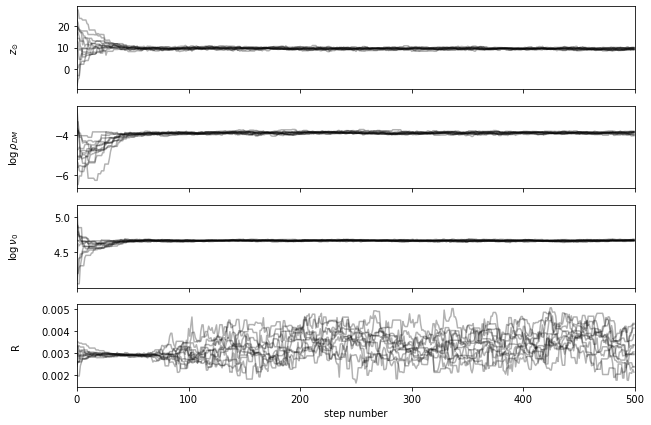

In [42]:
os.environ["OMP_NUM_THREADS"] = "16"
sampler_ = 0
labels = [r"$z_{\odot}$", r"$\log \rho_{DM}$", r"$\log \nu_0$", "R"]
with Pool() as pool:
    sampler = emcee.EnsembleSampler(nwalkers, ndim, log_posterior, args=[data, priors])
    start = time.time()
    state = sampler.run_mcmc(p0, 500, progress=True)
    end = time.time()
    multi_time = end - start
    print("Multiprocessing took {0:.1f} seconds".format(multi_time))
    plot_chain(sampler, labels)
    sampler_ = sampler

100%|██████████| 1000/1000 [01:12<00:00, 13.81it/s]


Multiprocessing took 72.5 seconds


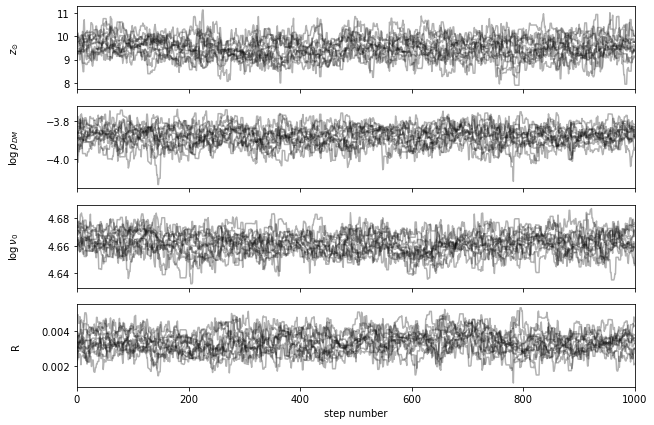

In [43]:
next_p0 = sampler_.get_chain()[-1]
with Pool() as pool:
    sampler = emcee.EnsembleSampler(
        nwalkers, 
        ndim, 
        log_posterior, 
        args=[data, priors], 
        pool=pool
    )
    start = time.time()
    state = sampler.run_mcmc(next_p0, 1000, progress=True)
    end = time.time()
    multi_time = end - start
    print("Multiprocessing took {0:.1f} seconds".format(multi_time))
    plot_chain(sampler, labels)
    sampler_ = sampler

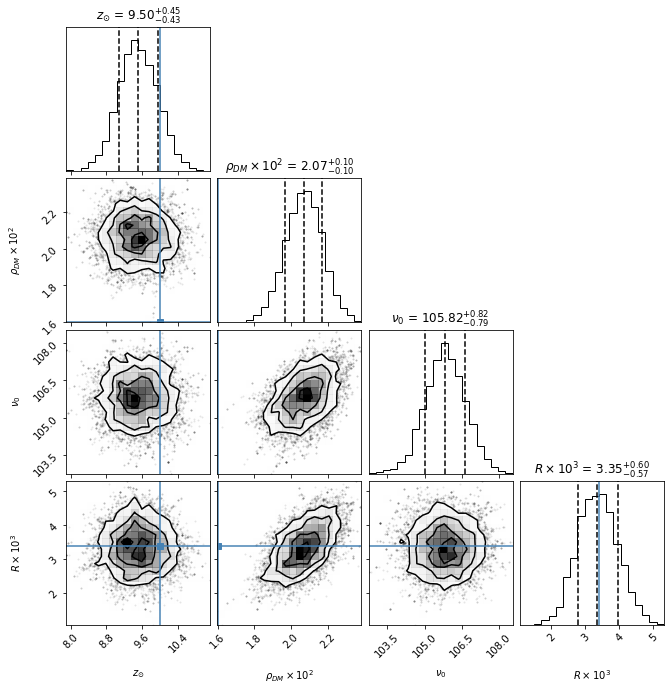

In [44]:
flat_samples = sampler.get_chain(flat=True).copy()
flat_samples[:, 1] = np.exp(flat_samples[:, 1])/1E-2
flat_samples[:, 2] = np.exp(flat_samples[:, 2])
flat_samples[:, -1] = flat_samples[:, -1]/1E-3
labels_2 = [r"$z_{\odot}$", r"$\rho_{DM}\times 10^2$", r"$\nu_0$", r"$R \times 10^3$"]
fig = corner.corner(
    flat_samples, labels=labels_2,
    truths=[zsun, rhoDM/1E-2, Nu0, R/1E-3],
    quantiles=[0.16, 0.5, 0.84],
    show_titles=True, title_kwargs={"fontsize": 12},
)

## 2D
$\nu(z)$ and $f_0(w)$

\begin{align*} 
  F(z, w) = \nu(z)\cdot \text{comp}(z)\times\mathcal{N}[w; w_0, \sigma_w(z)]
\end{align*}
Where
\begin{align*} 
  \sigma_w(z) = a(z-z_0)^2+\sigma_{w0}
\end{align*}

13291.297228263233


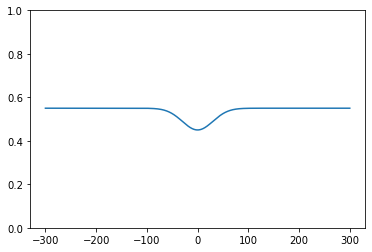

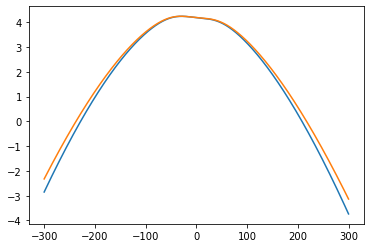

In [10]:
number_density = lambda z, **theta: np.exp(log_nu_mod(z, **theta))

rhoDM = 0.016 # Msun/pc^3
sigmaDD = 0 # Msun/pc^2
hDD = 20 # pc
# Nu0 = np.exp(6.5)
Nu0 = np.exp(5)
zsun = 10 # kpc
sigma_w = 5 # km/s, is sigma_w0
w0 = -7 # km/s
R = 3.4E-3 # Msun/pc^3
a = 2E-5

theta_dict = dict(zsun=zsun, w0=w0, a=a, R=R,  rhos=rhos, sigmaz=sigmaz, rhoDM=rhoDM, sigmaDD=sigmaDD, hDD=hDD, Nu0=Nu0, sigma_w=sigma_w)
z = np.linspace(-300, 300, 1000)
comp = lambda z: -norm.pdf(z, loc=0, scale=30)*np.sqrt(2*np.pi)*30*.1+0.55
nu = number_density(z, **theta_dict)*comp(z)
theta_dict['R'] = 10E-3
nu2 = number_density(z, **theta_dict)*comp(z)
N0 = np.trapz(nu, z)
print(N0)

plt.plot(z, comp(z))
plt.ylim(0, 1)
plt.show()

plt.plot(z, np.log(nu))
plt.plot(z, np.log(nu2))
plt.show()

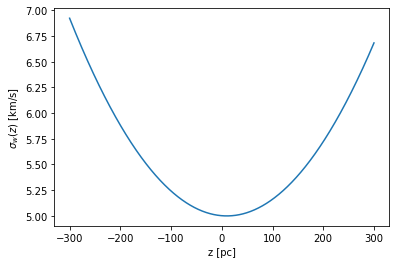

In [11]:
sigma_wz = a*(z-zsun)**2 + sigma_w

plt.plot(z, sigma_wz)
plt.xlabel("z [pc]")
plt.ylabel(r"$\sigma_w(z)$ [km/s]")
plt.show()

In [12]:
def fwz(z, w, **theta):
  sigma_w0, a, zsun, w0 = theta["sigma_w"], theta["a"], theta["zsun"], theta['w0']
  sigma_w = a*(z-zsun)**2 + sigma_w0
  return norm.pdf(w, loc=w0, scale=sigma_w)
w = np.linspace(-30, 30, 1001)
W, Z = np.meshgrid(w, z)
fwz_instance = fwz(Z, W, **theta_dict)

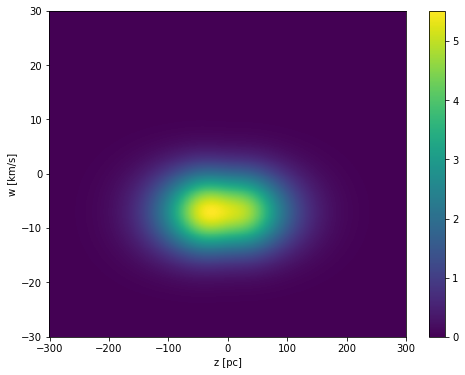

13291.234206702553

In [92]:
fnu = np.repeat(nu, len(w)).reshape(len(nu), len(w))
F = fwz_instance*fnu

# plot
fig, ax = plt.subplots(1, 1, figsize=(8, 6))
im = ax.pcolormesh(Z, W, F, cmap="viridis")
ax.set_xlabel("z [pc]")
ax.set_ylabel("w [km/s]")
fig.colorbar(im, ax=ax)
plt.show()

total = np.trapz(np.trapz(F, w), z)
total

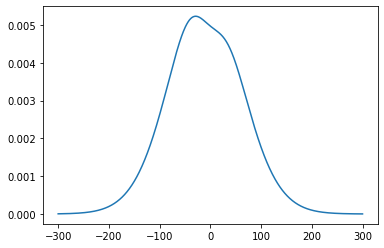

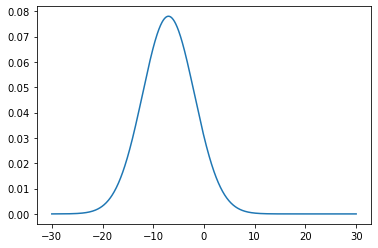

In [14]:
fnu = np.trapz(F, w, axis=1)
Area = np.trapz(fnu, z)
fnu /= Area

plt.plot(z, fnu)
plt.show()

fw = np.trapz(F, z, axis=0)
Area = np.trapz(fw, w)
fw /= Area

plt.plot(w, fw)
plt.show()

In [15]:
Vol = np.trapz(np.trapz(F, z, axis=0), w, axis=0)
print(Vol)

def density(z, w, **theta):
  fnu = number_density(z, **theta)*comp(z)
  fwz_instance = fwz(z, w, **theta)
  return fnu*fwz_instance

def density_pdf(z, w, **theta):
  return density(z,w, **theta)/Vol

13291.234206702551


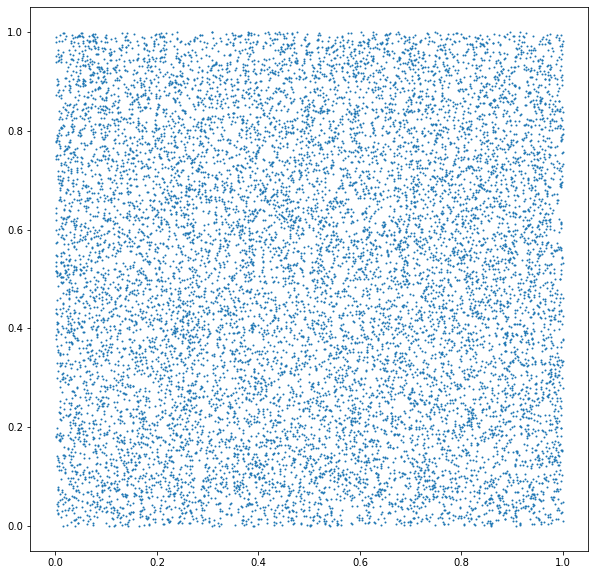

In [16]:
z_rand = np.random.rand(np.floor(Vol).astype(int))
w_rand = np.random.rand(np.floor(Vol).astype(int))

plt.figure(figsize=(10,10))
plt.scatter(z_rand, w_rand, s=1)
plt.show()

In [17]:
W, Z = np.meshgrid(w, z)
Fd = density_pdf(Z, W, **theta_dict)
Fz = np.trapz(Fd, w, axis=1)
cdf_z = np.cumsum(Fz)
cdf_z = cdf_z / cdf_z[-1]
cdf_z_unique = np.unique(cdf_z)
inverse_cdf_z = interp1d(cdf_z_unique, z[:len(cdf_z_unique)], kind='cubic', fill_value='extrapolate')

zs, ws = [], []
for i, (zz, ww) in enumerate(zip(z_rand, w_rand)):
    z_t = inverse_cdf_z(zz)
    Fw = density_pdf(z_t, w, **theta_dict)
    cdf_w = np.cumsum(Fw)
    cdf_w = cdf_w / cdf_w[-1]
    cdf_w_unique = np.unique(cdf_w)
    inverse_cdf_w = interp1d(cdf_w_unique, w[:len(cdf_w_unique)], kind='cubic', fill_value='extrapolate')
    w_t = inverse_cdf_w(ww)
    zs.append(z_t)
    ws.append(w_t)
    if i % 100 == 0:
        print(i, end=' ')
zs = np.array(zs)
ws = np.array(ws)
Fw = np.trapz(Fd, z, axis=0)

0 100 200 300 400 500 600 700 800 900 1000 1100 1200 1300 1400 1500 1600 1700 1800 1900 2000 2100 2200 2300 2400 2500 2600 2700 2800 2900 3000 3100 3200 3300 3400 3500 3600 3700 3800 3900 4000 4100 4200 4300 4400 4500 4600 4700 4800 4900 5000 5100 5200 5300 5400 5500 5600 5700 5800 5900 6000 6100 6200 6300 6400 6500 6600 6700 6800 6900 7000 7100 7200 7300 7400 7500 7600 7700 7800 7900 8000 8100 8200 8300 8400 8500 8600 8700 8800 8900 9000 9100 9200 9300 9400 9500 9600 9700 9800 9900 10000 10100 10200 10300 10400 10500 10600 10700 10800 10900 11000 11100 11200 11300 11400 11500 11600 11700 11800 11900 12000 12100 12200 12300 12400 12500 12600 12700 12800 12900 13000 13100 13200 

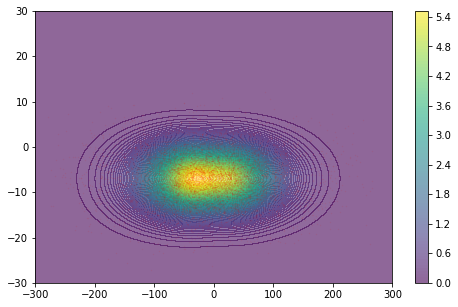

In [18]:
plt.figure(figsize=(8,5))
plt.contourf(Z, W, F, 100, alpha=0.6)
plt.colorbar()
plt.scatter(zs, ws, s=0.1, alpha=0.1, c="r")
plt.show()

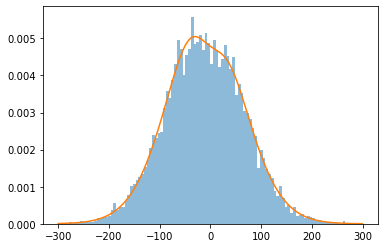

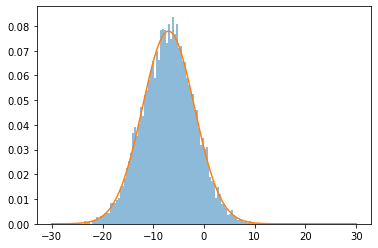

In [19]:
Area = np.trapz(Fz, z)
plt.hist(zs, bins=100, density=True, alpha=0.5)
plt.plot(z, Fz/Area)
plt.show()

Area = np.trapz(Fw, w)
plt.hist(ws, bins=100, density=True, alpha=0.5)
plt.plot(w, Fw/Area)
plt.show()

In [32]:
# histogram
def generate_pdf(x, xdir, xmax, Ntot, **theta):
  t = np.linspace(-1, 1, 1000)
  density_x = []
  for xdirr in xdir:
    z = xmax['z']*t*xdirr['z']
    w = xmax['w']*t*xdirr['w']
    fx = density_pdf(z, w, **theta)
    area = np.trapz(fx, t)
    fx /= area
    density_xx = interp1d(t, fx)
    density_x.append(density_xx(x)*Ntot)
  density_x = np.array(density_x)
  return density_x

def log_likelihood(data, **theta):
  xnum, xedge, xerr, xdir, xmax = data
  xmid = (xedge[1:] + xedge[:-1]) / 2
  dx = xedge[1] - xedge[0]
  Ntot = xnum[0].sum()*dx
  density_x = generate_pdf(xmid, xdir, xmax, Ntot, **theta)
  # for i, (xxnum, xxerr, density_xx) in enumerate(zip(xnum, xerr, density_x)):
  #   plt.bar(xmid, density_xx, width=dx)
  #   plt.errorbar(xmid, xxnum, yerr=xxerr, fmt='.', c="red")
  #   plt.title(i)
  #   plt.show()

  probx = np.nan_to_num(norm.logpdf(xnum, loc=density_x, scale=xerr), nan=0)
  return np.sum(probx)


In [287]:
# histogram

def log_likelihood(data, **theta):
  xnum, xedge, xerr = data
  zedge, wedge = xedge
  zmid = (zedge[1:] + zedge[:-1]) / 2
  wmid = (wedge[1:] + wedge[:-1]) / 2
  dz = zedge[1] - zedge[0]
  dw = wedge[1] - wedge[0]
  Ntot = xnum.sum()
  Wmid, Zmid = np.meshgrid(wmid, zmid)
  
  fx = density_pdf(Zmid, Wmid, **theta)
  fz = np.trapz(fx, wmid, axis=1)
  
  # flatten = (fx*Ntot*dw*dz-xnum).flatten()
  # plt.plot(flatten)
  
  probx = np.nan_to_num(norm.logpdf(xnum, loc=fx*Ntot*dw*dz, scale=xerr), nan=0)
  return np.sum(probx)


In [20]:
zz = np.linspace(-350, 350, 400)
ww = np.linspace(-30, 30, 400)

WW, ZZ = np.meshgrid(ww, zz)

F = density(ZZ, WW, **theta_dict)
integral = np.trapz(np.trapz(F, ww, axis=1), zz)

integral

13816.323447611676

In [256]:
# ipp
def log_likelihood(data, **theta):
  z, w = data
  
  zz = np.linspace(-350, 350, 300)
  ww = np.linspace(-30, 30, 300)
  
  WW, ZZ = np.meshgrid(ww, zz)
  
  F = density(ZZ, WW, **theta)
  integral = np.trapz(np.trapz(F, ww, axis=1), zz)

  log = np.log(density(z, w, **theta))
  return np.sum(log) - integral

In [104]:
# angled histogram
def log_likelihood(data, **theta):
  xnum, xerr, xdir, t = data
  dt=t[1]-t[0]
  probx = []
  tt = (t[:-1]+t[1:])/2
  ss = np.linspace(-1, 1, 1000)
  S, T = np.meshgrid(ss, tt)
  for xnumm, xerrr, xdirr in zip(xnum, xerr, xdir):
    ZZ = (S*xdirr[1]+T*xdirr[0])*z.max()
    WW = (T*xdirr[1]-S*xdirr[0])*w.max()
    dens = density(ZZ, WW, **theta)
    denst = np.trapz(dens, ss, axis=1)*z.max()*w.max()
    pr = np.nan_to_num(norm.logpdf(xnumm, loc=denst, scale=xerrr), nan=0)
    probx.append(pr)
    
    # plt.figure(figsize=(10,7))
    # plt.bar(tt, xnumm, width=dt)
    # plt.errorbar(tt, xnumm, yerr=xerrr, fmt=" ", c="k")
    # plt.plot(tt, denst, c='r')
    # plt.show()
  return np.sum(np.array(probx))

In [105]:
theta = np.array([zsun, w0, np.log(rhoDM), np.log(Nu0), np.log(sigma_w), np.log(a), R])
# theta = np.array([zsun, w0, np.log(a), R, rhoDM, Nu0, sigma_w])
theta_dict = {t: theta[i] for i, t in enumerate(theta_names)}
theta_dict['sigmaz'] = sigmaz
theta_dict['rhos'] = rhos
theta_dict['sigmaDD'] = 0
theta_dict['hDD'] = 1
theta_dict['rhoDM'] = np.exp(theta_dict['log_rhoDM'])
theta_dict['Nu0'] = np.exp(theta_dict['log_Nu0'])
theta_dict['a'] = np.exp(theta_dict['log_a'])
theta_dict['sigma_w'] = np.exp(theta_dict['log_sigma_w'])
log_likelihood(data, **theta_dict)

-3487.4230568632775

In [106]:
# theta_names = ['zsun', 'w0', 'log_a', 'R', 'rhoDM', 'Nu0', 'sigma_w'] # DM only
theta_uniform = ['zsun', 'w0', 'log_rhoDM', 'log_Nu0', 'log_sigma_w', 'log_a']
theta_gaussian = ['R']
theta_names = theta_uniform + theta_gaussian

# uniform prior
def log_prior(**pars):
  theta, loc, scale = pars['theta'], pars['loc'], pars['scale']
  uniform_args = dict(x=[], loc=[], scale=[])
  for t in theta_uniform:
    uniform_args['x'].append(theta[t])
    uniform_args['loc'].append(loc[t])
    uniform_args['scale'].append(scale[t])
  gaussian_args = dict(x=[], loc=[], scale=[])
  for t in theta_gaussian:
    gaussian_args['x'].append(theta[t])
    gaussian_args['loc'].append(loc[t])
    gaussian_args['scale'].append(scale[t])
  log_args = dict(x=[], loc=[], scale=[])

  val_uniform = np.sum(uniform.logpdf(**uniform_args))
  val_gaussian = np.sum(norm.logpdf(**gaussian_args))
  return val_uniform + val_gaussian

def log_posterior(x: np.ndarray, data: np.ndarray, priors: dict):
  theta = {t: x[i] for i, t in enumerate(theta_names)}
  pars = dict(theta=theta, **priors)
  log_prior_ = log_prior(**pars)
  if np.isinf(log_prior_) or np.isnan(log_prior_):
    return -np.inf
  theta['sigmaz'] = sigmaz
  theta['rhos'] = rhos
  theta['sigmaDD'] = 0
  theta['hDD'] = 1
  theta['rhoDM'] = np.exp(theta['log_rhoDM'])
  theta['Nu0'] = np.exp(theta['log_Nu0'])
  theta['a'] = np.exp(theta['log_a'])
  theta['sigma_w'] = np.exp(theta['log_sigma_w'])
  return log_prior_ + log_likelihood(data, **theta)

In [30]:
# test
# ['zsun', 'w0', 'R', 'rhoDM', 'Nu0', 'sigma_w', 'a']

xnum, xdir, xerr = [], [], []
# angles = [0, np.pi/4, np.pi/2, 3*np.pi/2]
angles = np.linspace(0, np.pi, 3)
angles = angles[:-1]
print(angles)
xedge = np.linspace(-1, 1, 100)
dx = xedge[1]-xedge[0]
print(dx)
xmid = (xedge[:-1]+xedge[1:])/2
for angle in angles:
  zdir = np.cos(angle)
  wdir = np.sin(angle)
  xdir.append(dict(z=zdir, w=wdir))
  xi = zs/z.max()*zdir+ws/w.max()*wdir
  xxnum, _ = np.histogram(xi, bins=xedge)
  xxerr = np.sqrt(xxnum)
  xxnum, xxerr = xxnum/dx, xxerr/dx
  xnum.append(xxnum)
  xerr.append(xxerr)
    
xdir = np.array(xdir)
xnum = np.array(xnum)
xerr = np.array(xerr)

xmax = dict(z=z.max(), w=w.max())

data=(xnum, xedge, xerr, xdir, xmax)

# for xxnum, angle in zip(xnum, angles):
#   plt.step(xmid, xxnum, where='mid', label=np.round(angle,2))
# plt.legend()
# plt.show()

loc = dict(zsun=zsun-20, w0=w0-sigma_w*3, log_a=np.log(a*0.01), R=3.4E-3, rhoDM=0.001, Nu0=Nu0*.9, sigma_w=sigma_w*0.9)
scale = dict(zsun=40, w0=sigma_w*6, log_a=np.log(100/0.01), R=0.6E-3, rhoDM=0.03, Nu0=Nu0*.2, sigma_w=sigma_w*0.2)
priors=dict(loc=loc, scale=scale)

theta = np.array([zsun, w0, np.log(a), R, rhoDM, Nu0, sigma_w])
theta_dict = {t: theta[i] for i, t in enumerate(theta_names)}
pars = dict(theta=theta_dict, **priors)
pars

[0.         1.57079633]
0.02020202020202022


{'theta': {'zsun': 10.0,
  'w0': -7.0,
  'log_a': -10.819778284410283,
  'R': 0.0034,
  'rhoDM': 0.016,
  'Nu0': 13291.297228263233,
  'sigma_w': 5.0},
 'loc': {'zsun': -10,
  'w0': -22,
  'log_a': -15.424948470398375,
  'R': 0.0034,
  'rhoDM': 0.001,
  'Nu0': 11962.16750543691,
  'sigma_w': 4.5},
 'scale': {'zsun': 40,
  'w0': 30,
  'log_a': 9.210340371976184,
  'R': 0.0006,
  'rhoDM': 0.03,
  'Nu0': 2658.2594456526467,
  'sigma_w': 1.0}}

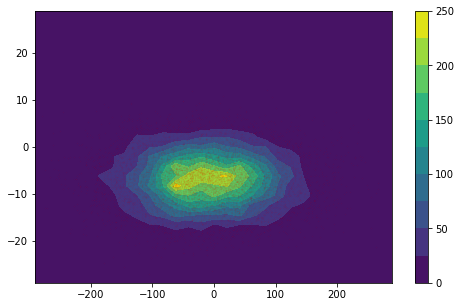

In [107]:
# test
zedge = np.linspace(z.min(), z.max(), 30)
wedge = np.linspace(w.min(), w.max(), 30)

xnum, _ = np.histogramdd((zs, ws), bins=(zedge, wedge))

zmid = (zedge[1:] + zedge[:-1]) / 2
wmid = (wedge[1:] + wedge[:-1]) / 2

Wmid, Zmid = np.meshgrid(wmid, zmid)

plt.figure(figsize=(8,5))
plt.contourf(Zmid, Wmid, xnum, 10)
plt.colorbar()
plt.scatter(zs, ws, s=0.04, alpha=0.1, c="r")
plt.show()

In [290]:
xedge = (zedge, wedge)
xerr = np.sqrt(xnum)

data=(xnum, xedge, xerr)

loc = dict(zsun=zsun-20, w0=w0-sigma_w*3, log_a=np.log(a*0.001), R=3.4E-3, rhoDM=0.0001, sigmaDD=1, hDD=hDD*0.01, Nu0=Nu0*.9, sigma_w=sigma_w*0.9)
scale = dict(zsun=40, w0=sigma_w*6, log_a=np.log(100/0.001), R=0.6E-3, rhoDM=1, sigmaDD=30, hDD=100, Nu0=Nu0*.2, sigma_w=sigma_w*0.2)
priors=dict(loc=loc, scale=scale)

theta = np.array([zsun, w0, np.log(a), R, rhoDM, sigmaDD, hDD, Nu0, sigma_w])
# theta = np.array([zsun, w0, np.log(a), R, rhoDM, 1, hDD, Nu0, sigma_w])
# theta = np.array([zsun, w0, np.log(a), R, rhoDM, Nu0, sigma_w])
theta_dict = {t: theta[i] for i, t in enumerate(theta_names)}

pars = dict(theta=theta_dict, **priors)
pars

{'theta': {'zsun': 10.0,
  'w0': -7.0,
  'log_a': -10.819778284410283,
  'R': 0.0034,
  'rhoDM': 0.016,
  'sigmaDD': 7.0,
  'hDD': 20.0,
  'Nu0': 148.4131591025766,
  'sigma_w': 5.0},
 'loc': {'zsun': -10,
  'w0': -22,
  'log_a': -17.72753356339242,
  'R': 0.0034,
  'rhoDM': 0.0001,
  'sigmaDD': 1,
  'hDD': 0.2,
  'Nu0': 133.57184319231894,
  'sigma_w': 4.5},
 'scale': {'zsun': 40,
  'w0': 30,
  'log_a': 11.512925464970229,
  'R': 0.0006,
  'rhoDM': 1,
  'sigmaDD': 30,
  'hDD': 100,
  'Nu0': 29.682631820515322,
  'sigma_w': 1.0}}

In [79]:
data=(zs, ws)

loc = dict(zsun=zsun-20, w0=w0-sigma_w*3, log_rhoDM=np.log(0.001), log_Nu0=np.log(Nu0*.5), log_sigma_w=np.log(sigma_w*0.5), log_a=np.log(a*0.001), R=3.4E-3)
scale = dict(zsun=40, w0=sigma_w*6, log_rhoDM=np.log(0.1/0.001), log_Nu0=np.log(1.5/0.5), log_sigma_w=np.log(1.5/0.5), log_a=np.log(100/0.001), R=0.6E-3)
priors=dict(loc=loc, scale=scale)

theta = np.array([zsun, w0, np.log(rhoDM), np.log(Nu0), np.log(sigma_w), np.log(a), R])
theta_dict = {t: theta[i] for i, t in enumerate(theta_names)}

pars = dict(theta=theta_dict, **priors)
pars

{'theta': {'zsun': 10.0,
  'w0': -7.0,
  'log_rhoDM': -4.135166556742356,
  'log_Nu0': 5.0,
  'log_sigma_w': 1.6094379124341003,
  'log_a': -10.819778284410283,
  'R': 0.0034},
 'loc': {'zsun': -10,
  'w0': -22,
  'log_rhoDM': -6.907755278982137,
  'log_Nu0': 4.306852819440055,
  'log_sigma_w': 0.9162907318741551,
  'log_a': -17.72753356339242,
  'R': 0.0034},
 'scale': {'zsun': 40,
  'w0': 30,
  'log_rhoDM': 4.605170185988092,
  'log_Nu0': 1.0986122886681098,
  'log_sigma_w': 1.0986122886681098,
  'log_a': 11.512925464970229,
  'R': 0.0006}}

In [189]:
t = np.linspace(-1, 1, 100)
dt = t[1]-t[0]
angles = np.linspace(0, np.pi, 7)
angles = angles[:-1]
print(np.round(angles*180/np.pi, 2))
xdir = []
xnum = []
xerr = []
for angle in angles:
  xdirr = [np.cos(angle), np.sin(angle)]
  # xd = (z_rand-0.5)*xdirr[0]/np.sqrt(2) + (w_rand-0.5)*xdirr[1]/np.sqrt(2) # box test
  xd = zs*xdirr[0]/z.max() + ws*xdirr[1]/w.max()
  xnumm, _ = np.histogram(xd, bins=t)
  xdir.append(xdirr)
  xnum.append(xnumm)
  xerr.append(np.sqrt(xnumm))

xdir = np.array(xdir)
xnum = np.array(xnum)
xerr = np.array(xerr)
xnum, xerr = xnum/dt, xerr/dt
tmid = (t[:-1]+t[1:])/2

data = (xnum, xerr, xdir, t)

[  0.  30.  60.  90. 120. 150.]


In [65]:
loc = dict(zsun=zsun-20, w0=w0-sigma_w*3, log_rhoDM=np.log(0.001), log_Nu0=np.log(Nu0*.1), log_sigma_w=np.log(sigma_w*0.5), log_a=np.log(a*0.001), R=3.4E-3)
scale = dict(zsun=40, w0=sigma_w*6, log_rhoDM=np.log(0.1/0.001), log_Nu0=np.log(10/0.1), log_sigma_w=np.log(1.5/0.5), log_a=np.log(100/0.001), R=0.6E-3)
priors=dict(loc=loc, scale=scale)

theta = np.array([zsun, w0, np.log(rhoDM), np.log(Nu0), np.log(sigma_w), np.log(a), R])
theta_dict = {t: theta[i] for i, t in enumerate(theta_names)}

pars = dict(theta=theta_dict, **priors)
pars

{'theta': {'zsun': 10.0,
  'w0': -7.0,
  'log_rhoDM': -4.135166556742356,
  'log_Nu0': 5.0,
  'log_sigma_w': 1.6094379124341003,
  'log_a': -10.819778284410283,
  'R': 0.0034},
 'loc': {'zsun': -10,
  'w0': -22,
  'log_rhoDM': -6.907755278982137,
  'log_Nu0': 2.6974149070059545,
  'log_sigma_w': 0.9162907318741551,
  'log_a': -17.72753356339242,
  'R': 0.0034},
 'scale': {'zsun': 40,
  'w0': 30,
  'log_rhoDM': 4.605170185988092,
  'log_Nu0': 4.605170185988092,
  'log_sigma_w': 1.0986122886681098,
  'log_a': 11.512925464970229,
  'R': 0.0006}}

In [190]:
for angle, xnumm, xdirr in zip(angles, xnum, xdir):
  tt = np.linspace(-1, 1, 1000)
  ss = np.linspace(-1, 1, 1000)                               
  S, T = np.meshgrid(ss, tt)
  dtt = tt[1]-tt[0]
  ZZ = (S*xdirr[1]+T*xdirr[0])*z.max()
  WW = (T*xdirr[1]-S*xdirr[0])*w.max()
  
  area = np.sum(xnumm*dt)
  Num = xnumm.sum()
  yerr = np.sqrt(xnumm)/area
  dens = density(ZZ, WW, **theta_dict)
  # print(xnumm.sum()*dt)
  # dens = uniform.pdf(ZZ, loc=-1/np.sqrt(2)/2, scale=1/np.sqrt(2))*uniform.pdf(WW, loc=-1/np.sqrt(2)/2, scale=1/np.sqrt(2))
  denst = np.trapz(dens, ss, axis=1)*z.max()*w.max()
  # integral = np.trapz(denst, tt)
  # print(integral)
  # denst = denst/integral*xnumm.sum()*dt
  plt.figure(figsize=(10,7))
  plt.bar(tmid, xnumm, width=dt)
  # plt.errorbar(tmid, xnumm, yerr=yerr, fmt=" ", c="k")
  plt.plot(tt, denst, c='r')
  plt.title(np.round(angle*180/np.pi,2))
  plt.show()
  break
  

KeyError: 'sigma_w'

In [110]:
log_prior(**pars)

-6.182311903147195

In [111]:
theta = np.array([zsun, w0, np.log(rhoDM), np.log(Nu0), np.log(sigma_w), np.log(a), R])
# theta = np.array([zsun, w0, np.log(a), R, rhoDM, Nu0, sigma_w])
theta_dict = {t: theta[i] for i, t in enumerate(theta_names)}
theta_dict['sigmaz'] = sigmaz
theta_dict['rhos'] = rhos
theta_dict['sigmaDD'] = 0
theta_dict['hDD'] = 1
theta_dict['rhoDM'] = np.exp(theta_dict['log_rhoDM'])
theta_dict['Nu0'] = np.exp(theta_dict['log_Nu0'])
theta_dict['a'] = np.exp(theta_dict['log_a'])
theta_dict['sigma_w'] = np.exp(theta_dict['log_sigma_w'])
log_likelihood(data, **theta_dict)

-3487.4230568632775

In [112]:
theta = np.array([zsun-5, w0, np.log(rhoDM), np.log(Nu0), np.log(sigma_w), np.log(a), R])
# theta = np.array([zsun, w0, np.log(a), R, rhoDM, Nu0, sigma_w])
theta_dict = {t: theta[i] for i, t in enumerate(theta_names)}
theta_dict['sigmaz'] = sigmaz
theta_dict['rhos'] = rhos
theta_dict['sigmaDD'] = 0
theta_dict['hDD'] = 1
theta_dict['rhoDM'] = np.exp(theta_dict['log_rhoDM'])
theta_dict['Nu0'] = np.exp(theta_dict['log_Nu0'])
theta_dict['a'] = np.exp(theta_dict['log_a'])
theta_dict['sigma_w'] = np.exp(theta_dict['log_sigma_w'])
log_likelihood(data, **theta_dict)

-3595.0750466117834

In [113]:
theta = np.array([zsun, w0, np.log(rhoDM), np.log(Nu0), np.log(sigma_w), np.log(a), R])
log_posterior(theta, data, priors)

-3493.605368766425

In [114]:
theta = np.array([zsun-5, w0, np.log(rhoDM), np.log(Nu0), np.log(sigma_w), np.log(a), R])
log_posterior(theta, data, priors)

-3601.2573585149307

In [115]:
loc = priors["loc"]
scale = priors["scale"]

ndim = len(theta_names)
nwalkers = ndim*2

p0 = []
for t in theta_uniform:
  p0.append(np.random.uniform(loc[t], loc[t]+scale[t], size=nwalkers))
for t in theta_gaussian:
  p0.append(np.random.normal(loc[t], scale[t], size=nwalkers))
p0 = np.array(p0).T
p0[:3]

array([[-8.93496926e+00, -2.61532130e+00, -6.04518138e+00,
         5.92878077e+00,  1.78843527e+00, -1.41263569e+01,
         3.54662819e-03],
       [-8.98927009e+00, -1.74960881e+01, -5.35210449e+00,
         3.16404358e+00,  1.46031275e+00, -1.52030786e+01,
         3.37864784e-03],
       [ 1.48631337e+00, -6.18029621e+00, -4.25228675e+00,
         3.95307916e+00,  1.99983951e+00, -1.54967103e+01,
         2.81272097e-03]])

100%|██████████| 500/500 [14:43<00:00,  1.77s/it]


Multiprocessing took 885.7 seconds


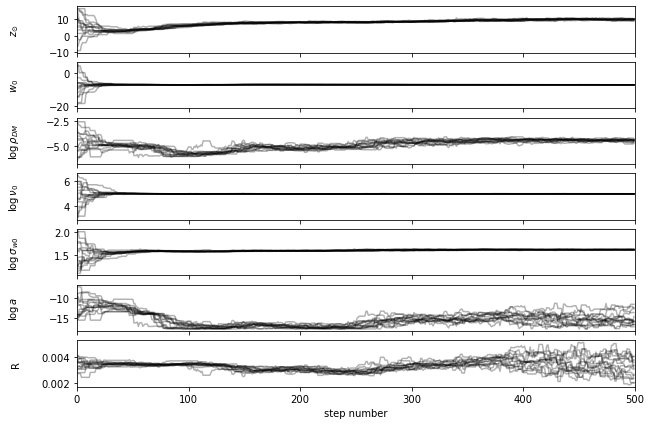

In [116]:
os.environ["OMP_NUM_THREADS"] = "16"
sampler_ = 0
# labels = [r"$z_{\odot}$", r"$w_0$", r"$\log a$", "R", r"$\rho_{DM}$", r"$\nu_0$", r"$\sigma_{w0}$"]
# labels = [r"$z_{\odot}$", r"$w_0$", r"$\log a$", "R", r"$\rho_{DM}$", r"$\sigma_{DD}$", r"$h_{DD}$", r"$\nu_0$", r"$\sigma_{w0}$"]
labels = [r"$z_{\odot}$", r"$w_0$", r"$\log \rho_{DM}$", r"$\log \nu_0$", r"$\log \sigma_{w0}$", r"$\log a$", "R",]
with Pool() as pool:
    sampler = emcee.EnsembleSampler(nwalkers, ndim, log_posterior, args=[data, priors])
    start = time.time()
    state = sampler.run_mcmc(p0, 500, progress=True)
    end = time.time()
    multi_time = end - start
    print("Multiprocessing took {0:.1f} seconds".format(multi_time))
    plot_chain(sampler, labels)
    sampler_ = sampler

100%|██████████| 1000/1000 [06:30<00:00,  2.56it/s]


Multiprocessing took 391.3 seconds


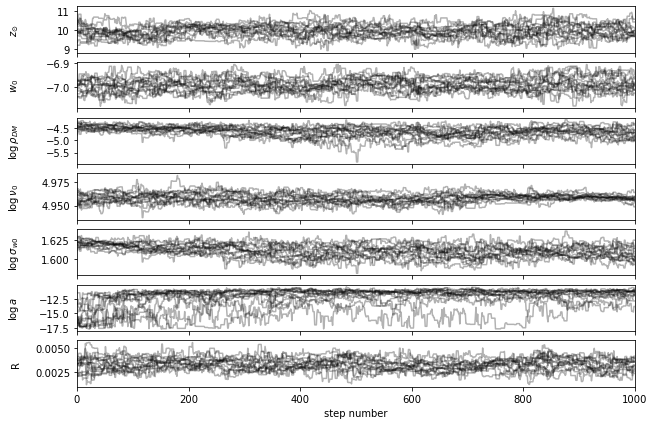

In [117]:
next_p0 = sampler_.get_chain()[-1]
with Pool() as pool:
    sampler = emcee.EnsembleSampler(
        nwalkers, 
        ndim, 
        log_posterior, 
        args=[data, priors], 
        pool=pool
    )
    start = time.time()
    state = sampler.run_mcmc(next_p0, 1000, progress=True)
    end = time.time()
    multi_time = end - start
    print("Multiprocessing took {0:.1f} seconds".format(multi_time))
    plot_chain(sampler, labels)
    sampler_ = sampler

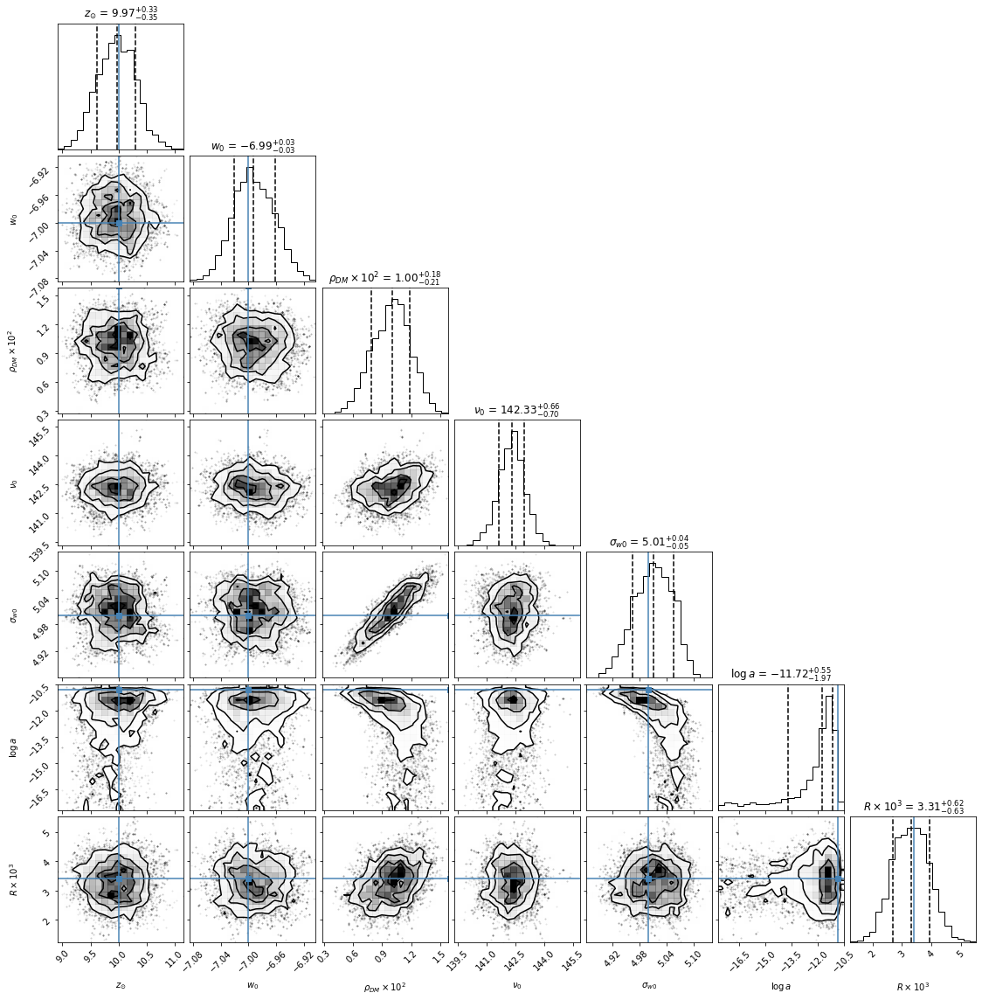

In [121]:
flat_samples = sampler.get_chain(flat=True).copy()
flat_samples[:, 2] = np.exp(flat_samples[:, 2])/1E-2
flat_samples[:, 3] = np.exp(flat_samples[:, 3])
flat_samples[:, 4] = np.exp(flat_samples[:, 4])
flat_samples[:, -1] = flat_samples[:, -1]/1E-3
labels_2 = [r"$z_{\odot}$", r"$w_0$", r"$\rho_{DM}\times 10^2$", r"$\nu_0$", r"$\sigma_{w0}$", r"$\log a$", r"$R\times 10^3$"]
fig = corner.corner(
    flat_samples, labels=labels_2,
    truths=[zsun, w0, rhoDM/1E-2, Nu0, sigma_w, np.log(a), R/1E-3],
    quantiles=[0.16, 0.5, 0.84],
    show_titles=True, title_kwargs={"fontsize": 12},
)

# 3D!

\begin{align*} 
  F(z, w, c) = \nu(z)\times\mathcal{N}[w; w_0, \sigma_w(z,c)]
\end{align*}
Where
\begin{align*} 
  \sigma_w(z,c) = a(c)(z+z_0)^2+\sigma_{w0}(c)
\end{align*}
And
\begin{align*} 
  a(c) &= m_ac+a_0 \\
  \sigma_{w0}(c) &= m_{\sigma}c+\sigma_0
\end{align*}

Also
\begin{align*} 
  \nu(z) &= \int \text{d}\nu^*(z, c) \\
  &= \nu_0\int \text{d}A(c) \int \frac{\mathcal{N}(w; w_0, m_{\sigma}c+\sigma_0)\text{ d}w}{\sqrt{w^2-\Phi(z)}}
\end{align*}
where
\begin{align*}
  A(c) = e^{bc}
\end{align*}

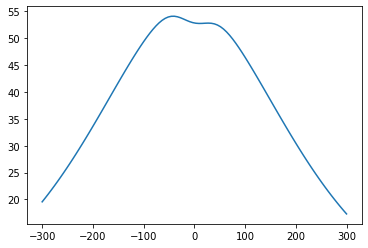

Num 23399.351697953203


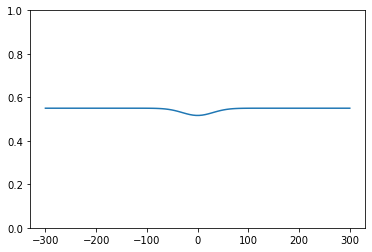

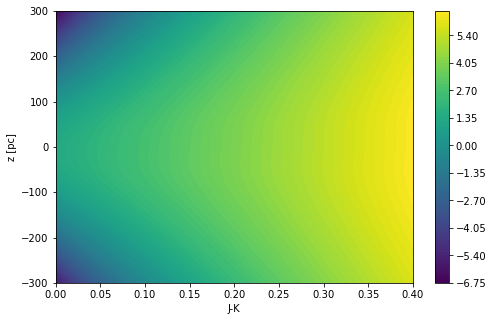

In [262]:
number_density = lambda z, **theta: np.exp(log_nu_mod(z, **theta))
Aexp = lambda b, c: np.exp(b*c)
# uniform
zsun = 10 # kpc
w0 = -7 # km/s
a0 = 2E-5
log_a = np.log(a0)
# gaussian
R = 3.4E-3 # Msun/pc^3
# log
rhoDM = 0.016 # Msun/pc^3
sigmaDD = 1E-3 # Msun/pc^2
hDD = 20 # pc
# Nu0 = np.exp(0)
Nu0 = np.exp(2.)
sigma_0 = 5 # km/s
# tan
ma = 1E-5
msigma = 25
b = 13


theta_dict = dict(zsun=zsun, w0=w0, a0=a0, R=R, rhos=rhos, sigmaz=sigmaz, rhoDM=rhoDM, sigmaDD=sigmaDD,
                  hDD=hDD, Nu0=Nu0, sigma_0=sigma_0, ma=ma, msigma=msigma, b=b)

z = np.linspace(-300, 300, 100) # height, pc
cmin, cmax = 0, 0.4
c = np.linspace(cmin, cmax, 100) # color, J-K
dc = c[1]-c[0]

CC, ZZ = np.meshgrid(c, z)
comp = lambda z: -norm.pdf(z, loc=0, scale=30)*np.sqrt(2*np.pi)*10*.1+0.55
# comp = lambda z: 1

def nu_zc(z, c, **theta):
  b = theta['b']
  theta['sigma_w'] = theta['msigma']*c+theta['sigma_0']
  # nu_z = number_density(z, **theta)*comp(z)*Aexp(b, c, cmin, cmax) 
  nu_z = number_density(z, **theta)*Aexp(b, c)*comp(z) 
  return nu_z
    
nu_zc_ins = nu_zc(ZZ, CC, **theta_dict)

nu_z = np.trapz(nu_zc_ins, c, axis=1)

plt.plot(z, nu_z)
plt.show()

N0=np.trapz(nu_z, z)
print("Num", N0)
plt.plot(z, comp(z))
plt.ylim(0, 1)
plt.show()

plt.figure(figsize=(8,5))
plt.contourf(CC.T,ZZ.T, np.log(nu_zc_ins.T), 100)
plt.ylabel('z [pc]')
plt.xlabel('J-K')
plt.colorbar()
plt.show()

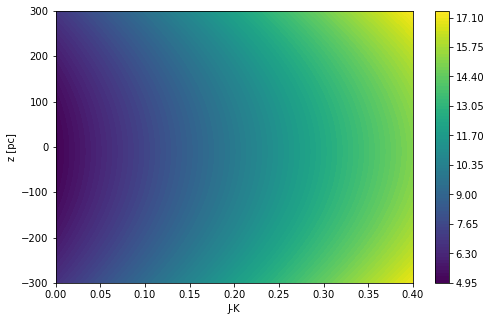

In [9]:
sigma_w = lambda c, msigma, sigma_0: msigma*c+sigma_0
a = lambda c, ma, a0: ma*c+a0

sigma_zc = a(CC, ma, a0)*(ZZ+zsun)**2 + sigma_w(CC, msigma, sigma_0)

plt.figure(figsize=(8,5))
plt.contourf(CC.T, ZZ.T, sigma_zc.T, 100)
plt.colorbar()
plt.ylabel('z [pc]')
plt.xlabel('J-K')
plt.show()

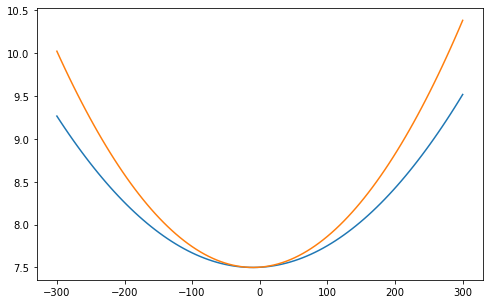

In [10]:
sigma_w = lambda c, msigma, sigma_0: msigma*c+sigma_0
a = lambda c, ma, a0: ma*c+a0

sigma_z = a(0.1, ma, a0)*(z+zsun)**2 + sigma_w(0.1, msigma, sigma_0)
sigma_z2 = a(0.1, np.tan(1E-4), a0)*(z+zsun)**2 + sigma_w(0.1, msigma, sigma_0)

plt.figure(figsize=(8,5))
plt.plot(z, sigma_z)
plt.plot(z, sigma_z2)
plt.show()

In [11]:
w = np.linspace(-50, 50, 100)
W, C, Z = np.meshgrid(w, c, z)

# zz = z[0, 0, :]
# cc = c[:, 0, 0]
sigma_w = lambda c, msigma, sigma_0: msigma*c+sigma_0
a = lambda c, ma, a0: ma*c+a0

def fzwc(z, w, c, **theta):
  theta['sigma_w'] = sigma_w(c, theta['msigma'], theta['sigma_0'])
  # for i, (cc, th) in enumerate(zip(c.flatten(), theta['sigma_w'].flatten())):
  #   if th < 0:
  #     print(i, cc, th)
    
  # print(np.unique(theta['sigma_w']))
  nu_zc_ins = nu_zc(z, c, **theta)
  sigmaw = a(c, theta['ma'], theta['a0'])*(z+zsun)**2 + theta['sigma_w']
  normmm = norm.pdf(w, loc=theta['w0'], scale=sigmaw)
  # print(np.unique(sigmaw))
  result = nu_zc_ins*normmm
  return result

In [12]:
F = fzwc(Z, W, C, **theta_dict)
Integral = np.trapz(np.trapz(np.trapz(F, z, axis=0), w, axis=0), c, axis=0)
Integral

23364.941652496378

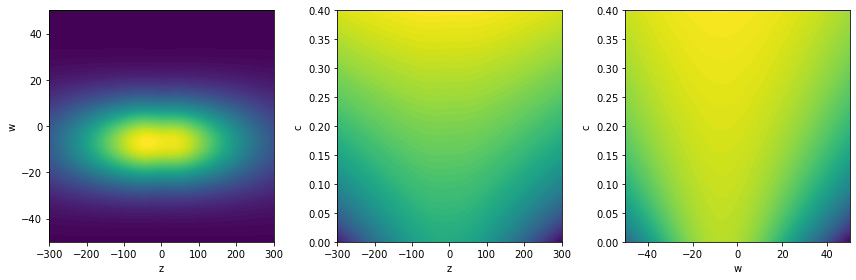

In [13]:
fig, axes = plt.subplots(1, 3, figsize=(12, 4))
Fzw = np.trapz(F, c, axis=0)
axes[0].contourf(Z[0, :, :], W[0, :, :], Fzw, 100)
axes[0].set_xlabel('z')
axes[0].set_ylabel('w')
Fzc = np.trapz(F, w, axis=1)
axes[1].contourf(Z[:, 0, :], C[:, 0, :], np.log(Fzc), 100)
axes[1].set_xlabel('z')
axes[1].set_ylabel('c')
Fwc = np.trapz(F, z, axis=2)
axes[2].contourf(W[:, :, 0], C[:, :, 0], np.log(Fwc), 100)
axes[2].set_xlabel('w')
axes[2].set_ylabel('c')
plt.tight_layout()
plt.show()

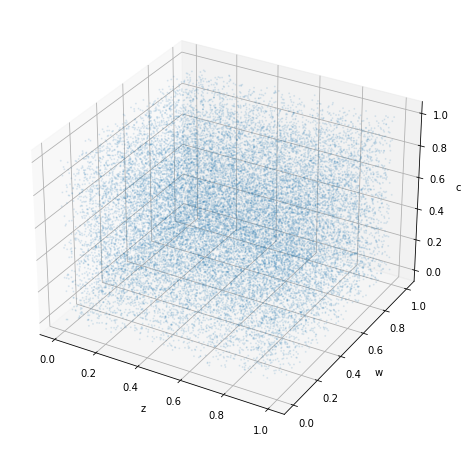

In [14]:
def density_pdf(z, w, c, **theta):
  return fzwc(z, w, c, **theta)/Integral

z_rand = np.random.rand(np.floor(N0).astype(int))
w_rand = np.random.rand(np.floor(N0).astype(int))
c_rand = np.random.rand(np.floor(N0).astype(int))

fig = plt.figure(figsize=(8,8))
ax = fig.add_subplot(111, projection='3d')
ax.scatter(z_rand, w_rand, c_rand, s=1, alpha=0.1)
ax.set_xlabel("z")
ax.set_ylabel("w")
ax.set_zlabel("c")
plt.show()

In [15]:
Fd = density_pdf(Z, W, C, **theta_dict)
Fz = np.trapz(np.trapz(Fd, c, axis=0), w, axis=0)
cdf_z = np.cumsum(Fz)
cdf_z = cdf_z / cdf_z[-1]
cdf_z_unique = np.unique(cdf_z)
inverse_cdf_z = interp1d(cdf_z_unique, z[:len(cdf_z_unique)], kind='cubic', fill_value='extrapolate')

CC, WW = np.meshgrid(c, w)

zs, ws, cs = [], [], []
for i, (zz, ww, cc) in enumerate(zip(z_rand, w_rand, c_rand)):
    z_t = inverse_cdf_z(zz)
    Fwc = density_pdf(z_t, WW, CC, **theta_dict)
    Fw = np.trapz(Fwc, c, axis=1)
    cdf_w = np.cumsum(Fw)
    cdf_w = cdf_w / cdf_w[-1]
    cdf_w_unique = np.unique(cdf_w)
    inverse_cdf_w = interp1d(cdf_w_unique, w[:len(cdf_w_unique)], kind='cubic', fill_value='extrapolate')
    w_t = inverse_cdf_w(ww)
    Fc = density_pdf(z_t, w_t, c, **theta_dict)
    cdf_c = np.cumsum(Fc)
    cdf_c = cdf_c / cdf_c[-1]
    cdf_c_unique = np.unique(cdf_c)
    inverse_cdf_c = interp1d(cdf_c_unique, c[:len(cdf_c_unique)], kind='cubic', fill_value='extrapolate')
    c_t =inverse_cdf_c(cc)
    zs.append(z_t)
    ws.append(w_t)
    cs.append(c_t)
    if i % 100 == 0: print(i, end=' ')
zs = np.array(zs)
ws = np.array(ws)
cs = np.array(cs)

0 100 200 300 400 500 600 700 800 900 1000 1100 1200 1300 1400 1500 1600 1700 1800 1900 2000 2100 2200 2300 2400 2500 2600 2700 2800 2900 3000 3100 3200 3300 3400 3500 3600 3700 3800 3900 4000 4100 4200 4300 4400 4500 4600 4700 4800 4900 5000 5100 5200 5300 5400 5500 5600 5700 5800 5900 6000 6100 6200 6300 6400 6500 6600 6700 6800 6900 7000 7100 7200 7300 7400 7500 7600 7700 7800 7900 8000 8100 8200 8300 8400 8500 8600 8700 8800 8900 9000 9100 9200 9300 9400 9500 9600 9700 9800 9900 10000 10100 10200 10300 10400 10500 10600 10700 10800 10900 11000 11100 11200 11300 11400 11500 11600 11700 11800 11900 12000 12100 12200 12300 12400 12500 12600 12700 12800 12900 13000 13100 13200 13300 13400 13500 13600 13700 13800 13900 14000 14100 14200 14300 14400 14500 14600 14700 14800 14900 15000 15100 15200 15300 15400 15500 15600 15700 15800 15900 16000 16100 16200 16300 16400 16500 16600 16700 16800 16900 17000 17100 17200 17300 17400 17500 17600 17700 17800 17900 18000 18100 18200 18300 18400 18

In [16]:
mask = (cs > 0)
zs_mask = zs[mask]
ws_mask = ws[mask]
cs_mask = cs[mask]
len(cs_mask)

23396

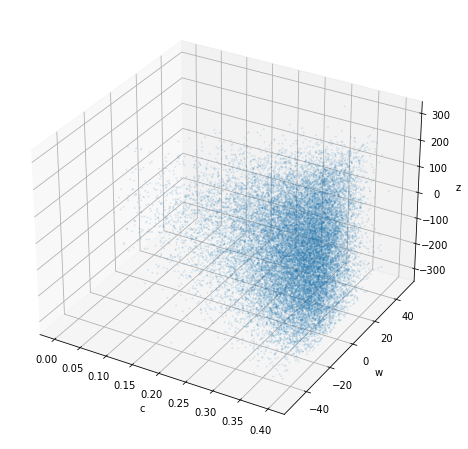

In [17]:
fig = plt.figure(figsize=(8,8))
ax = fig.add_subplot(111, projection='3d')
ax.scatter(cs_mask, ws_mask, zs_mask, s=1, alpha=0.1)
ax.set_zlabel("z")
ax.set_xlabel("c")
ax.set_ylabel("w")
plt.show()

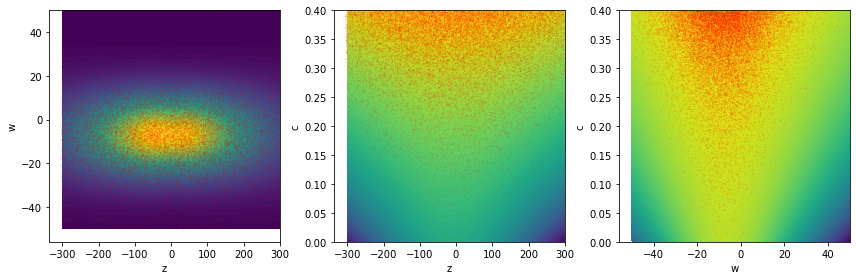

In [18]:
fig, axes = plt.subplots(1, 3, figsize=(12, 4))
Fzw = np.trapz(F, c, axis=0)
axes[0].contourf(Z[0, :, :], W[0, :, :], Fzw, 100)
axes[0].scatter(zs_mask, ws_mask, s=0.2, alpha=0.1, c="red")
axes[0].set_xlabel('z')
axes[0].set_ylabel('w')
Fzc = np.trapz(F, w, axis=1)
axes[1].contourf(Z[:, 0, :], C[:, 0, :], np.log(Fzc), 100)
axes[1].scatter(zs_mask, cs_mask, s=.2, alpha=0.1, c="red")
axes[1].set_xlabel('z')
axes[1].set_ylabel('c')
Fwc = np.trapz(F, z, axis=2)
axes[2].contourf(W[:, :, 0], C[:, :, 0], np.log(Fwc), 100)
axes[2].scatter(ws_mask, cs_mask, s=.2, alpha=0.1, c="red")
axes[2].set_xlabel('w')
axes[2].set_ylabel('c')
plt.tight_layout()
plt.show()

In [244]:
%%timeit

Fzw = np.trapz(F, c, axis=0)
Fz = np.trapz(Fzw, w, axis=0)
area = np.trapz(Fz, z)
Fz /= area
Fw = np.trapz(Fzw, z, axis=1)
area = np.trapz(Fw, w)
Fw /= area
Fc = np.trapz(np.trapz(F, z, axis=2), w, axis=1)
area = np.trapz(Fc, c)
Fc /= area
# fig, axes = plt.subplots(1, 3, figsize=(12, 4))
# axes[0].plot(z, Fz)
# axes[0].hist(zs_mask, bins=50, density=True)
# axes[0].set_yscale("log")
# axes[1].plot(w, Fw)
# axes[1].hist(ws_mask, bins=50, density=True)
# axes[2].plot(c, Fc)
# axes[2].hist(cs_mask, bins=50, density=True)
# axes[2].set_yscale("log")
# plt.show()

9.03 ms ± 126 µs per loop (mean ± std. dev. of 7 runs, 100 loops each)


In [245]:
%%timeit

Fzw = simps(F, c, axis=0)
Fz = simps(Fzw, w, axis=0)
area = simps(Fz, z)
Fz /= area
Fw = simps(Fzw, z, axis=1)
area = simps(Fw, w)
Fw /= area
Fc = simps(simps(F, z, axis=2), w, axis=1)
area = simps(Fc, c)
Fc /= area
# fig, axes = plt.subplots(1, 3, figsize=(12, 4))
# axes[0].plot(z, Fz)
# axes[0].hist(zs_mask, bins=50, density=True)
# axes[0].set_yscale("log")
# axes[1].plot(w, Fw)
# axes[1].hist(ws_mask, bins=50, density=True)
# axes[2].plot(c, Fc)
# axes[2].hist(cs_mask, bins=50, density=True)
# axes[2].set_yscale("log")
# plt.show()

14.2 ms ± 245 µs per loop (mean ± std. dev. of 7 runs, 100 loops each)


In [135]:
# histogram

def log_likelihood(data, **theta):
  xnum, xedge, xerr = data
  zedge, wedge, cedge = xedge
  zmid = (zedge[1:] + zedge[:-1]) / 2
  wmid = (wedge[1:] + wedge[:-1]) / 2
  cmid = (cedge[1:] + cedge[:-1]) / 2
  dz = zedge[1] - zedge[0]
  dw = wedge[1] - wedge[0]
  dc = cedge[1] - cedge[0]
  
  Ntot = xnum.sum()
  
  Wmid, Cmid, Zmid = np.meshgrid(wmid, cmid, zmid)
  
  F = density_pdf(Zmid, Wmid, Cmid, **theta)

  probx = np.nan_to_num(norm.logpdf(xnum, loc=F*Ntot*dw*dz*dc, scale=xerr), nan=0)
  return np.sum(probx)

In [18]:
# ipp
def log_likelihood(data, **theta):
  z, w, c = data
  
  zz = np.linspace(-300, 300, 100) # height, pc
  cc = np.linspace(0, 0.4, 100) # color, J-K
  ww = np.linspace(-50, 50, 100) # velocity
  # print(theta)
  WW, CC, ZZ = np.meshgrid(ww, cc, zz)

  F = fzwc(ZZ, WW, CC, **theta)
  integral = np.trapz(np.trapz(np.trapz(F, cc, axis=0), ww, axis=0), zz)
  # print(integral)
  log = np.log(fzwc(z, w, c, **theta))
  return np.sum(log) - integral


In [303]:
# # theta = np.array([zsun, w0, np.log(a0), np.log(rhoDM), np.log(sigmaDD), np.log(hDD), np.log(Nu0), 
# #                   np.log(sigma_0), np.arctan(ma), np.arctan(msigma), np.arctan(b), R])

# theta = np.array([zsun, w0,])
# theta_dict = {t: theta[i] for i, t in enumerate(theta_names)}
# theta_dict['sigmaz'] = sigmaz
# theta_dict['rhos'] = rhos
# theta_dict['a0'] = a0 #np.exp(theta['log_a0'])
# theta_dict['rhoDM'] = rhoDM #np.exp(theta['log_rhoDM'])
# theta_dict['sigmaDD'] = sigmaDD #np.exp(theta['log_sigmaDD'])
# theta_dict['hDD'] = hDD #np.exp(theta['log_hDD'])
# theta_dict['Nu0'] = Nu0 #np.exp(theta['log_Nu0'])
# theta_dict['sigma_0'] = sigma_0 #np.exp(theta['log_sigma_0'])
# theta_dict['ma'] = ma #np.tan(theta['atan_ma'])
# theta_dict['msigma'] = msigma #np.tan(theta['atan_msigma'])
# theta_dict['b'] = b #np.tan(theta['atan_b'])
# log_likelihood(data, **theta_dict)

-9761.912590294969

In [233]:
def density(Z, W, C, cond, **theta):
  return np.select([cond], [fzwc(Z, W, C, **theta)], default=0)

def log_likelihood(data, **theta):
  # xnum, xerr, xdir, ts, ss, rr = data
  xnum, xerr, ts, ss, rr, COORD, cond = data
  prob = np.array([])
  # for xnumm, xdirr, xerrr, ti in zip(xnum, xdir, xerr, ts):
  for xnumm, xerrr, ti, coord, mask in zip(xnum, xerr, ts, COORD, cond):
    # tdir, zdir, wdir, cdir = xdirr
    # SS, RR, TT = np.meshgrid(ss, rr, ti)
    # ZZ = (TT*zdir[0]+SS*zdir[1]+RR*zdir[2])*zmax
    # WW = (TT*wdir[0]+SS*wdir[1]+RR*wdir[2])*wmax
    # CC = (TT*cdir[0]+SS*cdir[1]+RR*cdir[2])*(cmax/2)+(cmax/2)
    # mask = (np.abs(ZZ) < 300)*(np.abs(WW)<50)*(CC< 0.4)*(CC>0)
    ZZ, WW, CC = coord
    dens = density(ZZ, WW, CC, mask, **theta)*zmax*wmax*cmax/2
    Ft = np.trapz(np.trapz(dens, rr, axis=0), ss, axis=0)
    # Ft = np.trapz(Fts, ss, axis=0)
    probx = norm.logpdf(Ft, loc=xnumm, scale=xerrr)
    prob = np.append(prob, probx)
  # print(np.array(prob))
  return np.sum(prob)
    

In [197]:
theta_uniform = ['zsun', 'w0', 'log_rhoDM', 'log_Nu0', 'log_sigma_0', 'log_a0',
                 'atan_ma', 'atan_msigma', 'atan_b']
theta_gaussian = ['R']

theta_names = theta_uniform + theta_gaussian

# uniform prior
def log_prior(**pars):
  theta, loc, scale = pars['theta'], pars['loc'], pars['scale']
  uniform_args = dict(x=[], loc=[], scale=[])
  for t in theta_uniform:
    uniform_args['x'].append(theta[t])
    uniform_args['loc'].append(loc[t])
    uniform_args['scale'].append(scale[t])
  gaussian_args = dict(x=[], loc=[], scale=[])
  for t in theta_gaussian:
    gaussian_args['x'].append(theta[t])
    gaussian_args['loc'].append(loc[t])
    gaussian_args['scale'].append(scale[t])
  val_uniform = np.sum(uniform.logpdf(**uniform_args))
  val_gaussian = np.sum(norm.logpdf(**gaussian_args))
  return val_uniform + val_gaussian 

def log_posterior(x: np.ndarray, data: np.ndarray, priors: dict):
  theta = {t: x[i] for i, t in enumerate(theta_names)}
  pars = dict(theta=theta, **priors)
  log_prior_ = log_prior(**pars)
  if np.isinf(log_prior_) or np.isnan(log_prior_):
    return -np.inf
  theta['sigmaz'] = sigmaz
  theta['rhos'] = rhos
  theta['rhoDM'] = np.exp(theta['log_rhoDM'])
  theta['sigmaDD'] = sigmaDD 
  theta['hDD'] = hDD 
  theta['Nu0'] = np.exp(theta['log_Nu0'])
  theta['sigma_0'] = np.exp(theta['log_sigma_0'])
  theta['a0'] = np.exp(theta['log_a0'])
  theta['ma'] = np.tan(theta['atan_ma'])
  theta['msigma'] = np.tan(theta['atan_msigma'])
  theta['b'] = np.tan(theta['atan_b'])
  return log_prior_ + log_likelihood(data, **theta)

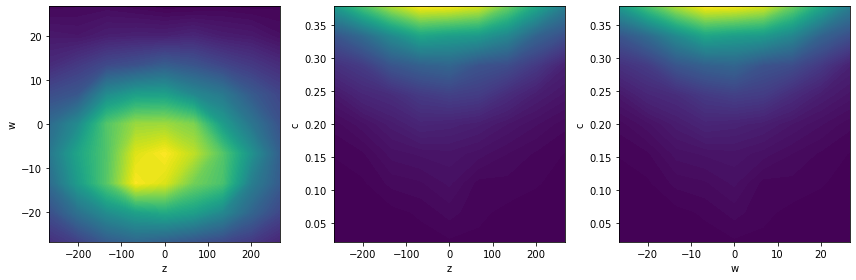

In [30]:
# test
zedge = np.linspace(z.min(), z.max(), 10)
wedge = np.linspace(w.min(), w.max(), 10)
cedge = np.linspace(c.min(), c.max(), 10)

xnum, _ = np.histogramdd((cs, ws, zs), bins=(cedge, wedge, zedge))

zmid = (zedge[1:] + zedge[:-1]) / 2
wmid = (wedge[1:] + wedge[:-1]) / 2
cmid = (cedge[1:] + cedge[:-1]) / 2

Wmid, Cmid, Zmid = np.meshgrid(wmid, cmid, zmid)

fig, axes = plt.subplots(1, 3, figsize=(12, 4))
Fzw = np.trapz(xnum, cmid, axis=0)
axes[0].contourf(Zmid[0, :, :], Wmid[0, :, :], Fzw, 100)
axes[0].set_xlabel('z')
axes[0].set_ylabel('w')
Fzc = np.trapz(xnum, wmid, axis=1)
axes[1].contourf(Zmid[:, 0, :], Cmid[:, 0, :], Fzc, 100)
axes[1].set_xlabel('z')
axes[1].set_ylabel('c')
Fwc = np.trapz(xnum, wmid, axis=1)
axes[2].contourf(Wmid[:, :, 0], Cmid[:, :, 0], Fwc, 100)
axes[2].set_xlabel('w')
axes[2].set_ylabel('c')
plt.tight_layout()
plt.show()

In [58]:
xedge = (zedge, wedge, cedge)
xerr = np.sqrt(xnum)

data=(xnum, xedge, xerr)

# loc = dict(zsun=zsun-20, w0=w0-sigma_0*9, log_a0=np.log(a0*0.001), log_rhoDM=np.log(0.0001), 
#            log_sigmaDD=np.log(sigmaDD*0.1), log_hDD=np.log(1), log_Nu0=np.log(Nu0*.1), log_sigma_0=np.log(sigma_0*.01), 
#            atan_ma=-np.pi/2, atan_msigma=-np.pi/2, atan_b=-np.pi/2, R=3.4E-3)
# scale = dict(zsun=40, w0=sigma_0*18, log_a0=np.log(1000/0.001), log_rhoDM=np.log(0.1/0.0001), 
#              log_sigmaDD=np.log(100/0.1), log_hDD=np.log(100/1), log_Nu0=np.log(10/0.1), 
#              log_sigma_0=np.log(100/0.01), atan_ma=np.pi, atan_msigma=np.pi, atan_b=np.pi, R=0.6E-3)

loc = dict(zsun=zsun-20, w0=w0-sigma_0*5, log_a0=np.log(a0*0.0001), log_rhoDM=np.log(0.001),
           log_Nu0=np.log(Nu0*.1), log_sigma_0=np.log(sigma_0*.1), atan_ma=0, 
           atan_msigma=2*np.arctan(msigma)-np.pi/2, atan_b=2*np.arctan(b)-np.pi/2, R=3.4E-3)
scale = dict(zsun=40, w0=sigma_0*10, log_a0=np.log(100/0.0001), log_rhoDM=np.log(0.1/0.001),
             log_Nu0=np.log(3/0.1), log_sigma_0=np.log(2/0.1), atan_ma=5E-4, 
             atan_msigma=2*(np.pi/2-np.arctan(msigma)), atan_b=2*(np.pi/2-np.arctan(b)), R=0.6E-3)

priors=dict(loc=loc, scale=scale)

# theta = np.array([zsun, w0, np.log(a0), np.log(rhoDM), np.log(sigmaDD), np.log(hDD), np.log(Nu0), 
#                   np.log(sigma_0), np.arctan(ma), np.arctan(msigma), np.arctan(b), R])

theta = np.array([zsun, w0, np.log(a0), np.log(rhoDM), np.log(Nu0), np.log(sigma_0), 
                  np.arctan(ma), np.arctan(msigma), np.arctan(b), R])
# theta = np.array([R])

theta_dict = {t: theta[i] for i, t in enumerate(theta_names)}

pars = dict(theta=theta_dict, **priors)
pars

{'theta': {'zsun': 10.0,
  'w0': -7.0,
  'log_a0': -10.819778284410283,
  'log_rhoDM': -4.135166556742356,
  'log_Nu0': 2.0,
  'log_sigma_0': 1.6094379124341003,
  'atan_ma': 9.999999999666668e-06,
  'atan_msigma': 1.5308176396716067,
  'atan_b': 1.4940244355251187,
  'R': 0.0034},
 'loc': {'zsun': -10,
  'w0': -32,
  'log_a0': -20.030118656386467,
  'log_rhoDM': -6.907755278982137,
  'log_Nu0': -0.3025850929940456,
  'log_sigma_0': -0.6931471805599453,
  'atan_ma': 0,
  'atan_msigma': 1.4908389525483168,
  'atan_b': 1.4172525442553408,
  'R': 0.0034},
 'scale': {'zsun': 40,
  'w0': 50,
  'log_a0': 13.815510557964274,
  'log_rhoDM': 4.605170185988092,
  'log_Nu0': 3.4011973816621555,
  'log_sigma_0': 2.995732273553991,
  'atan_ma': 0.0005,
  'atan_msigma': 0.07995737424657978,
  'atan_b': 0.1535437825395558,
  'R': 0.0006}}

In [114]:
data=(zs_mask, ws_mask, cs_mask)

# sigma_w = lambda c, msigma, sigma_0: msigma*c+sigma_0
# a = lambda c, ma, a0: ma*c+a0

loc = dict(zsun=zsun-20, w0=w0-sigma_0*5, log_rhoDM=np.log(0.001), log_Nu0=np.log(Nu0*.1), 
           log_sigma_0=np.log(sigma_0*.1), log_a0=np.log(a0*0.0001), atan_ma=1E-6, 
           atan_msigma=2*np.arctan(msigma)-np.pi/2, atan_b=2*np.arctan(b)-np.pi/2, R=3.4E-3)
scale = dict(zsun=40, w0=sigma_0*10, log_rhoDM=np.log(0.1/0.001), log_Nu0=np.log(3/0.1), 
             log_sigma_0=np.log(2/0.1), log_a0=np.log(100/0.0001),  atan_ma=5E-4, 
             atan_msigma=2*(np.pi/2-np.arctan(msigma)), atan_b=2*(np.pi/2-np.arctan(b)), R=0.6E-3)

priors=dict(loc=loc, scale=scale)

theta = np.array([zsun, w0, np.log(rhoDM), np.log(Nu0), np.log(sigma_0), np.log(a0), 
                  np.arctan(ma), np.arctan(msigma), np.arctan(b), R])
# theta = np.array([R])

theta_dict = {t: theta[i] for i, t in enumerate(theta_names)}

pars = dict(theta=theta_dict, **priors)
pars

{'theta': {'zsun': 10.0,
  'w0': -7.0,
  'log_rhoDM': -4.135166556742356,
  'log_Nu0': 2.0,
  'log_sigma_0': 1.6094379124341003,
  'log_a0': -10.819778284410283,
  'atan_ma': 9.999999999666668e-06,
  'atan_msigma': 1.5308176396716067,
  'atan_b': 1.4940244355251187,
  'R': 0.0034},
 'loc': {'zsun': -10,
  'w0': -32,
  'log_rhoDM': -6.907755278982137,
  'log_Nu0': -0.3025850929940456,
  'log_sigma_0': -0.6931471805599453,
  'log_a0': -20.030118656386467,
  'atan_ma': 1e-06,
  'atan_msigma': 1.4908389525483168,
  'atan_b': 1.4172525442553408,
  'R': 0.0034},
 'scale': {'zsun': 40,
  'w0': 50,
  'log_rhoDM': 4.605170185988092,
  'log_Nu0': 3.4011973816621555,
  'log_sigma_0': 2.995732273553991,
  'log_a0': 13.815510557964274,
  'atan_ma': 0.0005,
  'atan_msigma': 0.07995737424657978,
  'atan_b': 0.1535437825395558,
  'R': 0.0006}}

In [275]:
t = np.linspace(-1, 1, 51)
tmid = (t[:-1]+t[1:])/2
dt = t[1]-t[0]
phis = np.linspace(0, np.pi, 5)
phis = phis[:-1]
thetas = np.linspace(0, np.pi, 5)
thetas = thetas[1:-1]

ss = np.linspace(-1, 1, 100)
rr = np.linspace(-1, 1, 100)

angles = [[0., 0.]]
for th in thetas:
  for phi in phis:
    angles.append([phi, th])
angles = np.array(angles)
# angles = np.array([[np.pi/4, np.pi/4]])
xdir = []
xnum = []
xerr = []
ts = []

COORD = []
cond = []

print(len(angles))

zmax, wmax, cmax = z.max()*2, w.max()*2, c.max()*2

for angle in angles:
  tdir = np.array([np.cos(angle[0])*np.sin(angle[1]), np.sin(angle[0])*np.sin(angle[1]), np.cos(angle[1])])
  # sdir = np.array([-np.cos(angle[0])*np.cos(angle[1]), -np.sin(angle[0])*np.cos(angle[1]), np.sin(angle[1])])
  # rdir = np.array([np.sin(angle[0]), np.cos(angle[0]), 0])
  
  zdir = np.array([np.cos(angle[0])*np.sin(angle[1]), np.cos(angle[0])*np.cos(angle[1]), np.sin(angle[0])])
  wdir = np.array([np.sin(angle[0])*np.sin(angle[1]), np.sin(angle[0])*np.cos(angle[1]), -np.cos(angle[0])])
  cdir = np.array([np.cos(angle[1]), -np.sin(angle[1]), 0]) 
  
  # xdir.append((tdir, sdir, rdir, zdir, wdir, cdir))
  xdir.append((tdir, zdir, wdir, cdir))
  xd = zs*tdir[0]/(zmax) + ws*tdir[1]/(wmax) + (cs-cmax/2)*tdir[2]/(cmax/2)
  xnumm_raw, _ = np.histogram(xd, bins=t)
  mask = xnumm_raw > 0
  xnumm = xnumm_raw[mask]
  
  SS, RR, TT = np.meshgrid(ss, rr, tmid[mask])
  ZZ = (TT*zdir[0]+SS*zdir[1]+RR*zdir[2])*zmax
  WW = (TT*wdir[0]+SS*wdir[1]+RR*wdir[2])*wmax
  CC = (TT*cdir[0]+SS*cdir[1]+RR*cdir[2])*(cmax/2)+(cmax/2)
  mask2 = (np.abs(ZZ) < 300)*(np.abs(WW)<50)*(CC< 0.4)*(CC>0)
  COORD.append((ZZ, WW, CC))
  cond.append(mask2)
  ts.append(tmid[mask])
  xnum.append(xnumm)
  xerr.append(np.sqrt(xnumm))

xdir = np.array(xdir)
xnum = np.array(xnum)
xerr = np.array(xerr)
ts = np.array(ts)
# print(ts)
xnum, xerr = xnum/dt, xerr/dt
# data = (xnum, xerr, xdir, ts, ss, rr)
data = (xnum, xerr, ts, ss, rr, COORD, cond)

13


In [276]:
loc = dict(zsun=zsun-20, w0=w0-sigma_0*5, log_rhoDM=np.log(0.001),
           log_Nu0=np.log(Nu0*.1), log_sigma_0=np.log(sigma_0*.1), log_a0=np.log(a0*0.0001), atan_ma=0, 
           atan_msigma=2*np.arctan(msigma)-np.pi/2, atan_b=2*np.arctan(b)-np.pi/2, R=3.4E-3)
scale = dict(zsun=40, w0=sigma_0*10, log_rhoDM=np.log(0.1/0.001),
             log_Nu0=np.log(3/0.1), log_sigma_0=np.log(2/0.1), log_a0=np.log(100/0.0001), atan_ma=5E-4, 
             atan_msigma=2*(np.pi/2-np.arctan(msigma)), atan_b=2*(np.pi/2-np.arctan(b)), R=0.6E-3)

priors=dict(loc=loc, scale=scale)

# theta = np.array([zsun, w0, np.log(a0), np.log(rhoDM), np.log(sigmaDD), np.log(hDD), np.log(Nu0), 
#                   np.log(sigma_0), np.arctan(ma), np.arctan(msigma), np.arctan(b), R])

theta = np.array([zsun, w0, np.log(rhoDM), np.log(Nu0), np.log(sigma_0), np.log(a0),
                  np.arctan(ma), np.arctan(msigma), np.arctan(b), R])
# theta = np.array([R])

theta_dict = {t: theta[i] for i, t in enumerate(theta_names)}

pars = dict(theta=theta_dict, **priors)
pars

{'theta': {'zsun': 10.0,
  'w0': -7.0,
  'log_rhoDM': -4.135166556742356,
  'log_Nu0': 2.0,
  'log_sigma_0': 1.6094379124341003,
  'log_a0': -10.819778284410283,
  'atan_ma': 9.999999999666668e-06,
  'atan_msigma': 1.5308176396716067,
  'atan_b': 1.4940244355251187,
  'R': 0.0034},
 'loc': {'zsun': -10,
  'w0': -32,
  'log_rhoDM': -6.907755278982137,
  'log_Nu0': -0.3025850929940456,
  'log_sigma_0': -0.6931471805599453,
  'log_a0': -20.030118656386467,
  'atan_ma': 0,
  'atan_msigma': 1.4908389525483168,
  'atan_b': 1.4172525442553408,
  'R': 0.0034},
 'scale': {'zsun': 40,
  'w0': 50,
  'log_rhoDM': 4.605170185988092,
  'log_Nu0': 3.4011973816621555,
  'log_sigma_0': 2.995732273553991,
  'log_a0': 13.815510557964274,
  'atan_ma': 0.0005,
  'atan_msigma': 0.07995737424657978,
  'atan_b': 0.1535437825395558,
  'R': 0.0006}}

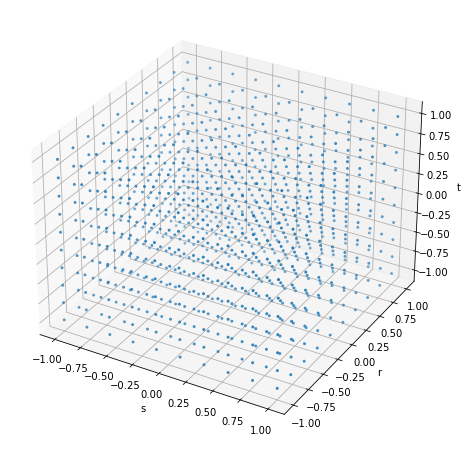

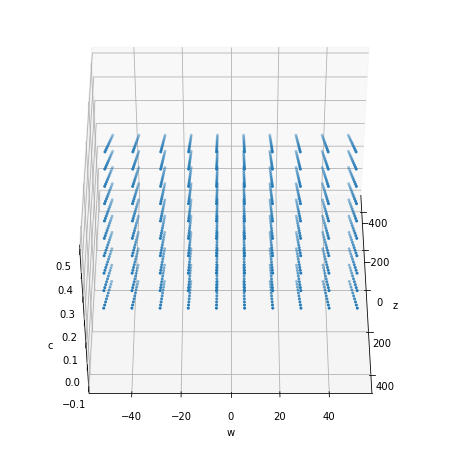

In [110]:
tt = np.linspace(-1, 1, 10)
ss = np.linspace(-1, 1, 10)
rr = np.linspace(-1, 1, 10)
dtt = tt[1]-tt[0]
S, R, T = np.meshgrid(ss, rr, tt)

ttmid = (tt[:-1] + tt[1:])/2

tss, sss, rss = [], [], []
for ti in tt:
  for si in ss:
    for ri in rr:
      tss.append(ti)
      sss.append(si)
      rss.append(ri)
tss, sss, rss = np.array(tss), np.array(sss), np.array(rss)

fig = plt.figure(figsize=(8,8))
ax = fig.add_subplot(111, projection='3d')
ax.scatter(tss, sss, rss, s=4)
ax.set_zlabel("t")
ax.set_xlabel("s")
ax.set_ylabel("r")
plt.show()

def density(Z, W, C, zmax, wmax, cmax, **theta):
  return np.select([np.abs(Z) > zmax, np.abs(W) > wmax, np.abs(C) > cmax], [0, 0, 0], default=fzwc(Z, W, C, **theta))

dtt = tt[1]-tt[0]
# print(dtt, dt, ttmid)
for angle, xnumm, xdirr, xerrr in zip(angles, xnum, xdir, xerr):
  tdir, zdir, wdir, cdir = xdirr
  # tdir = xdirr
  # xd = ZZ*tdir[0]/(zmax) + WW*tdir[1]/(wmax) + (CC-cmax/2)*tdir[2]/(cmax/2)
  # dens = fzwc(ZZ, WW, CC, **theta_dict)*dz*dw*dc
  
  # nums_raw, _ = np.histogram(xd, bins=tt, weights=dens)/dtt
  # nums_sum = np.cumsum(nums_raw)
  # plt.plot(ttmid, nums_sum)
  # print(nums_sum.shape)
  # nums = moving_average(nums_raw, window)
  
  zss = (tss*zdir[0]+sss*zdir[1]+rss*zdir[2])*zmax
  wss = (tss*wdir[0]+sss*wdir[1]+rss*wdir[2])*wmax
  css = (tss*cdir[0]+sss*cdir[1]+rss*cdir[2])*(cmax/2)+(cmax/2)
  
  fig = plt.figure(figsize=(8,8))
  ax = fig.add_subplot(111, projection='3d')
  ax.scatter(zss, wss, css, s=4)
  ax.view_init(elev=(np.pi/2-angles[0, 1])*180/np.pi, azim=angles[0,0]*180/np.pi)
  ax.set_zlabel("c")
  ax.set_xlabel("z")
  ax.set_ylabel("w")
  plt.show()
  break
  
  ZZ = (T*zdir[0]+S*zdir[1]+R*zdir[2])*zmax
  WW = (T*wdir[0]+S*wdir[1]+R*wdir[2])*wmax
  CC = (T*cdir[0]+S*cdir[1]+R*cdir[2])*(cmax/2)+(cmax/2)
  # print(np.unique(WW.flatten()))
  # print(np.unique())
  # print(ZZ.flatten())
  dens = density(ZZ, WW, CC, 300, 50, 0.4, **theta_dict)*zmax*wmax*cmax/2
  # print(dens)
  # fwz = 
  # plt.scatter(WW[:, :, 0], ZZ[:, 0, :])
  # plt.show()
  
  # print(ZZ[0, :, :])
  # print(np.unique(ZZ.flatten()))
  # denst = np.trapz(dens, tt, axis=0)
  # denst = np.trapz(dens, ss, axis=2)
  # RR, SS  = np.meshgrid(ss, rr)
  # SS, TT  = np.meshgrid(ss, rr)
  Fts = np.trapz(dens, rr, axis=0)
  Ft = np.trapz(Fts, ss, axis=0)
  # print(RR.shape, SS.shape, denst.shape)
  plt.figure(figsize=(10,7))
  plt.bar(tmid, xnumm, width=dt)
  plt.errorbar(tmid, xnumm, yerr=xerrr, fmt=" ", c="k")
  plt.plot(tt, Ft, c='r')
  plt.title(np.round(angle*180/np.pi,2))
  plt.show()
  

In [259]:
%%timeit

# tt = np.linspace(-1, 1, 100)
ss = np.linspace(-1, 1, 70)
rr = np.linspace(-1, 1, 70)
# dtt = tt[1]-tt[0]


# def density(Z, W, C, zmax, wmax, cmax, **theta):
#   return np.select([np.abs(Z) < zmax, np.abs(W) > wmax, np.abs(C) > cmax], [0, 0, 0], default=fzwc(Z, W, C, **theta))

def density(Z, W, C, cond, **theta):
  return np.select([cond], [fzwc(Z, W, C, **theta)], default=0)

theta_dict_2 = theta_dict.copy()
theta_dict_2['zsun'] = 10


for angle, xnumm, xdirr, xerrr, ti in zip(angles, xnum, xdir, xerr, ts):
  tdir, zdir, wdir, cdir = xdirr
  S, Rr, T = np.meshgrid(ss, rr, ti)
  ZZ = (T*zdir[0]+S*zdir[1]+Rr*zdir[2])*zmax
  WW = (T*wdir[0]+S*wdir[1]+Rr*wdir[2])*wmax
  CC = (T*cdir[0]+S*cdir[1]+Rr*cdir[2])*(cmax/2)+(cmax/2)
  mask = (np.abs(ZZ) < 300)*(np.abs(WW)<50)*(CC< 0.4)*(CC>0)
  # ZZ, WW, CC = ZZ[mask], WW[mask], CC[mask]
  # dens = density(ZZ, WW, CC, 300, 50, 0.4, **theta_dict_2)*zmax*wmax*cmax/2
  dens = density(ZZ, WW, CC, mask, **theta_dict_2)*zmax*wmax*cmax/2
  # print(dens)
  # print(mask)
  Ft = np.trapz(np.trapz(dens, rr, axis=0), ss, axis=0)
  # Ft = simps(simps(dens, rr, axis=0), ss, axis=0)
  # plt.figure(figsize=(10,7))
  # plt.bar(ti, xnumm, width=dt)
  # plt.errorbar(ti, xnumm, yerr=xerrr, fmt=" ", c="k")
  # plt.scatter(ti, Ft, c='r')
  # plt.title(np.round(angle*180/np.pi,2))
  # plt.show()
  # break
  

531 ms ± 11.3 ms per loop (mean ± std. dev. of 7 runs, 1 loop each)


In [33]:
tt = np.linspace(-1, 1, 100)
ss = np.linspace(-1, 1, 100)
rr = np.linspace(-1, 1, 100)

S, R, T = np.meshgrid(ss, rr, tt)

# zz = np.linspace(-zmax*2, zmax*2, 100)
# ww = np.linspace(-wmax*2, wmax*2, 100)
# cc = np.linspace(0, cmax, 100)

# dz = zz[1]-zz[0]
# dw = ww[1]-ww[0]
# dc = cc[1]-cc[0]

# WW, CC, ZZ = np.meshgrid(ww, cc, zz)
# dens = fzwc(ZZ, WW, CC,  **theta_dict)
# plt.plot(zz, density(zz, 20, 0.2, zmax, wmax, cmax, **theta_dict))
# m = 1
# tt = np.linspace(-1-dt*m, 1+dt*m, 100+m*2)
# tt = np.linspace(-1, 1, 100)
# def moving_average(x, w):
#     return np.convolve(x, np.ones(w), 'valid') / w
# window = m
# tt_mov = moving_average(tt, window)
# ttmid = (tt_mov[:-1] + tt_mov[1:])/2
ttmid = (tt[:-1] + tt[1:])/2
dtt = tt[1]-tt[0]
# print(dtt, dt, ttmid)
for angle, xnumm, xdirr, xerrr in zip(angles, xnum, xdir, xerr):
  tdir, sdir, rdir, zdir, wdir, cdir = xdirr
  # tdir = xdirr
  # xd = ZZ*tdir[0]/(zmax) + WW*tdir[1]/(wmax) + (CC-cmax/2)*tdir[2]/(cmax/2)
  # dens = fzwc(ZZ, WW, CC, **theta_dict)*dz*dw*dc
  
  # nums_raw, _ = np.histogram(xd, bins=tt, weights=dens)/dtt
  # nums_sum = np.cumsum(nums_raw)
  # plt.plot(ttmid, nums_sum)
  # print(nums_sum.shape)
  # nums = moving_average(nums_raw, window)
  ZZ = (T*zdir[0]+S*zdir[1]+R*zdir[2])#*zmax
  WW = (T*wdir[0]+S*wdir[1]+R*wdir[2])#*wmax
  CC = (T*cdir[0]+S*cdir[1]+R*cdir[2])#*(cmax/2)+(cmax/2)
  # print(np.unique(WW.flatten()))
  # print(np.unique())
  print(ZZ.flatten())
  # dens = density(ZZ, WW, CC, zmax/np.sqrt(3), wmax/np.sqrt(3), cmax/np.sqrt(3), **theta_dict)
  
  # fwz = 
  # plt.scatter(WW[:, :, 0], ZZ[:, 0, :])
  # plt.show()
  
  # print(ZZ[0, :, :])
  # print(np.unique(ZZ.flatten()))
  # denst = np.trapz(dens, tt, axis=0)
  # denst = np.trapz(dens, ss, axis=2)
  # RR, SS  = np.meshgrid(ss, rr)
  # SS, TT  = np.meshgrid(ss, rr)
  
  # print(RR.shape, SS.shape, denst.shape)
  # plt.figure(figsize=(10,7))
  # plt.bar(tmid, xnumm, width=dt)
  # plt.errorbar(tmid, xnumm, yerr=xerrr, fmt=" ", c="k")
  # plt.scatter(ttmid, nums, c='r')
  # plt.title(np.round(angle*180/np.pi,2))
  # plt.show()
  break
  

[-1.41421356 -1.39992858 -1.38564359 ...  1.38564359  1.39992858
  1.41421356]


In [277]:
log_prior(**pars)

4.425385720773114

In [278]:
# %%timeit
# theta = np.array([zsun, w0, np.log(a0), np.log(rhoDM), np.log(sigmaDD), np.log(hDD), np.log(Nu0), 
#                   np.log(sigma_0), np.arctan(ma), np.arctan(msigma), np.arctan(b), R])
theta = np.array([zsun, w0, np.log(rhoDM), np.log(Nu0), np.log(sigma_0), np.log(a0), 
                  np.arctan(ma), np.arctan(msigma), np.arctan(b), R])

theta_dict = {t: theta[i] for i, t in enumerate(theta_names)}
theta_dict['sigmaz'] = sigmaz
theta_dict['rhos'] = rhos
theta_dict['R'] = R
# theta_dict['a0'] = a0
theta_dict['a0'] = np.exp(theta_dict['log_a0'])
# theta_dict['rhoDM'] = rhoDM 
theta_dict['rhoDM'] = np.exp(theta_dict['log_rhoDM'])
theta_dict['sigmaDD'] = sigmaDD 
# theta_dict['sigmaDD'] = np.exp(theta_dict['log_sigmaDD'])
theta_dict['hDD'] = hDD 
# theta_dict['hDD'] = np.exp(theta_dict['log_hDD'])
# theta_dict['Nu0'] = Nu0
theta_dict['Nu0'] = np.exp(theta_dict['log_Nu0'])
# theta_dict['sigma_0'] = sigma_0 
theta_dict['sigma_0'] = np.exp(theta_dict['log_sigma_0'])
# theta_dict['ma'] = ma 
theta_dict['ma'] = np.tan(theta_dict['atan_ma'])
# theta_dict['msigma'] = msigma
theta_dict['msigma'] = np.tan(theta_dict['atan_msigma'])
# theta_dict['b'] = b 
theta_dict['b'] = np.tan(theta_dict['atan_b'])
log_likelihood(data, **theta_dict)

-3380.800399678645

In [279]:
theta = np.array([zsun-5, w0, np.log(rhoDM), np.log(Nu0), np.log(sigma_0), np.log(a0), 
                  np.arctan(ma), np.arctan(msigma), np.arctan(b), R])

theta_dict = {t: theta[i] for i, t in enumerate(theta_names)}
theta_dict['sigmaz'] = sigmaz
theta_dict['rhos'] = rhos
theta_dict['R'] = R
# theta_dict['a0'] = a0
theta_dict['a0'] = np.exp(theta_dict['log_a0'])
# theta_dict['rhoDM'] = rhoDM 
theta_dict['rhoDM'] = np.exp(theta_dict['log_rhoDM'])
theta_dict['sigmaDD'] = sigmaDD 
# theta_dict['sigmaDD'] = np.exp(theta_dict['log_sigmaDD'])
theta_dict['hDD'] = hDD 
# theta_dict['hDD'] = np.exp(theta_dict['log_hDD'])
# theta_dict['Nu0'] = Nu0
theta_dict['Nu0'] = np.exp(theta_dict['log_Nu0'])
# theta_dict['sigma_0'] = sigma_0 
theta_dict['sigma_0'] = np.exp(theta_dict['log_sigma_0'])
# theta_dict['ma'] = ma 
theta_dict['ma'] = np.tan(theta_dict['atan_ma'])
# theta_dict['msigma'] = msigma
theta_dict['msigma'] = np.tan(theta_dict['atan_msigma'])
# theta_dict['b'] = b 
theta_dict['b'] = np.tan(theta_dict['atan_b'])
log_likelihood(data, **theta_dict)

-3451.385917129827

In [270]:
# theta = np.array([zsun, w0, np.log(a0), np.log(rhoDM), np.log(sigmaDD), np.log(hDD), np.log(Nu0), 
#                   np.log(sigma_0), np.arctan(ma), np.arctan(msigma), np.arctan(b), R])

theta = np.array([zsun, w0, np.log(rhoDM), np.log(Nu0), np.log(sigma_0), np.log(a0), 
                  np.arctan(ma), np.arctan(msigma), np.arctan(b), R])
log_posterior(theta, data, priors)

-3517.7877859207024

In [271]:
theta = np.array([zsun-5, w0, np.log(rhoDM), np.log(Nu0), np.log(sigma_0), np.log(a0), 
                  np.arctan(ma), np.arctan(msigma), np.arctan(b), R])
log_posterior(theta, data, priors)

-3589.4136327502283

In [280]:
loc = priors["loc"]
scale = priors["scale"]

ndim = len(theta_names)
nwalkers = np.floor(ndim*2.5).astype(int)

p0 = []
for t in theta_names:
  p0.append(np.random.uniform(loc[t], loc[t]+scale[t], size=nwalkers))
p0 = np.array(p0).T
p0[:3]

array([[ 1.94456731e+00, -1.47647884e+01, -4.24103149e+00,
         2.88797859e+00, -5.33697314e-01, -1.68255494e+01,
         4.45340334e-04,  1.54426387e+00,  1.54233314e+00,
         3.99801303e-03],
       [ 4.02257372e+00, -2.56735033e+01, -6.56143946e+00,
         2.78545324e+00,  1.58868065e+00, -1.88640883e+01,
         1.60880191e-05,  1.53232092e+00,  1.43281335e+00,
         3.88439118e-03],
       [ 2.28476999e+01, -2.24165416e+01, -5.05024318e+00,
         1.10985135e+00,  5.18337738e-01, -1.28113658e+01,
         4.22114599e-04,  1.55914171e+00,  1.42599063e+00,
         3.55451970e-03]])

100%|██████████| 500/500 [1:10:40<00:00,  8.48s/it]


Multiprocessing took 4247.8 seconds


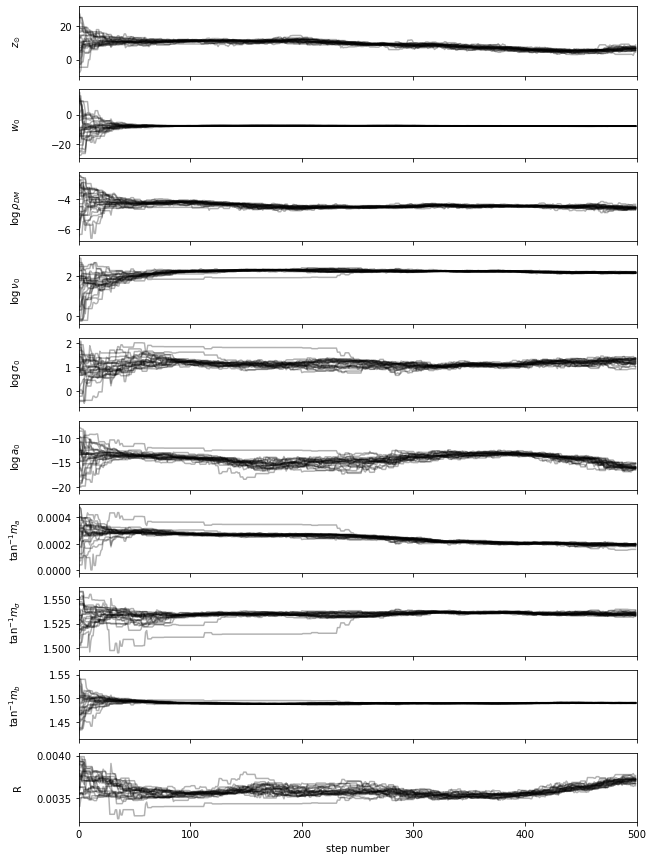

In [282]:
os.environ["OMP_NUM_THREADS"] = "16"
sampler_ = 0
# labels = [r"$z_{\odot}$", r"$w_{0}$", r"$\log a_0$", r"$\log \rho_{DM}$", r"$\log \sigma_{DD}$", 
#           r"$\log h_{DD}$", r"$\log \nu_0$", r"$\log \sigma_0$", r"$\tan^{-1} m_a$", r"$\tan^{-1} m_{\sigma}$",
#           r"$\tan^{-1} m_b$", "R"]

labels = [r"$z_{\odot}$", r"$w_{0}$", r"$\log \rho_{DM}$", r"$\log \nu_{0}$", r"$\log \sigma_{0}$", 
          r"$\log a_0$", r"$\tan^{-1} m_a$", r"$\tan^{-1} m_{\sigma}$", r"$\tan^{-1} m_b$", "R"]

with Pool() as pool:
    sampler = emcee.EnsembleSampler(
        nwalkers, 
        ndim, 
        log_posterior, 
        args=[data, priors], 
        pool=pool
    )
    start = time.time()
    state = sampler.run_mcmc(p0, 500, progress=True)
    end = time.time()
    multi_time = end - start
    plot_chain(sampler, labels, figsize=(10,15))
    print("Multiprocessing took {0:.1f} seconds".format(multi_time))
    sampler_ = sampler

100%|██████████| 1000/1000 [2:16:55<00:00,  8.22s/it] 


Multiprocessing took 8223.3 seconds


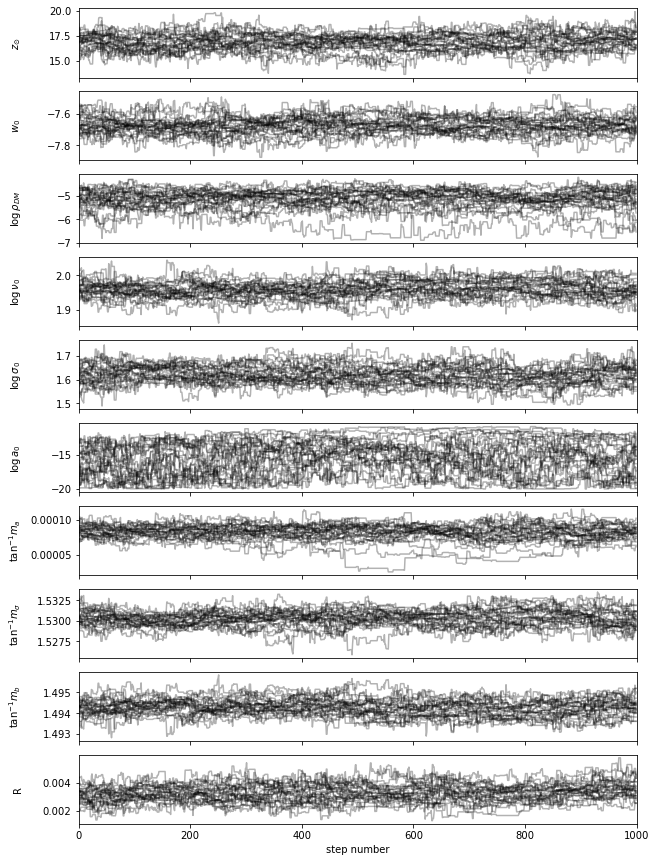

In [285]:
next_p0 = sampler_.get_chain()[-1]
with Pool() as pool:
    sampler = emcee.EnsembleSampler(
        nwalkers, 
        ndim, 
        log_posterior, 
        args=[data, priors], 
        pool=pool
    )
    start = time.time()
    state = sampler.run_mcmc(next_p0, 1000, progress=True)
    end = time.time()
    multi_time = end - start
    print("Multiprocessing took {0:.1f} seconds".format(multi_time))
    plot_chain(sampler, labels, figsize=(10,15))
    sampler_ = sampler

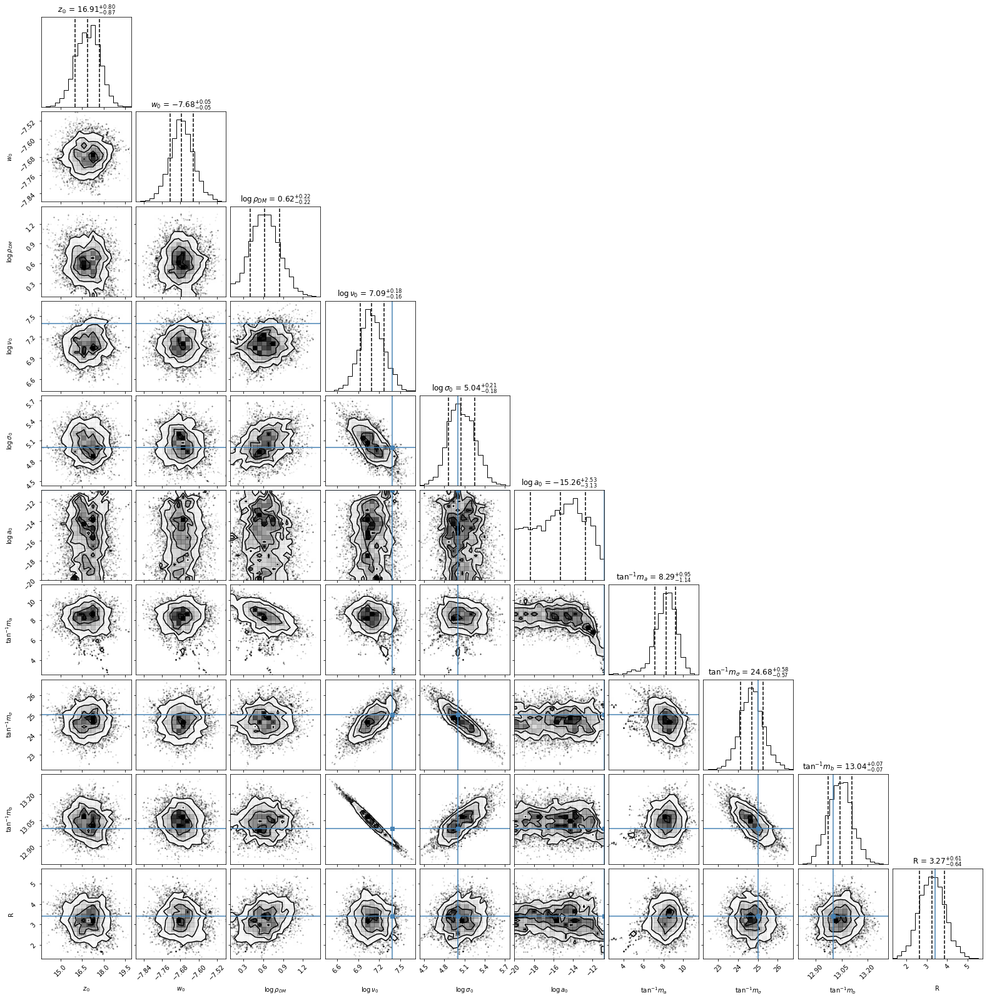

In [286]:
flat_samples = sampler_.get_chain(flat=True).copy()
flat_samples[:, 2] = np.exp(flat_samples[:, 2])/1E-2
flat_samples[:, 3:5] = np.exp(flat_samples[:, 3:5])
# flat_samples[:, 5] = np.tan(flat_samples[:, 5])
flat_samples[:, 6] = np.tan(flat_samples[:, 6])/1E-5
flat_samples[:, 7:9] = np.tan(flat_samples[:, 7:9])
flat_samples[:, 9] = np.tan(flat_samples[:, 9])/1E-3

labels_2 = [r"$z_{\odot}$", r"$w_{0}$", r"$\rho_{DM}\times 10^2$", r"$\nu_{0}$", r"$\sigma_{0}$", 
          r"$\log a_0$", r"$m_a\times 10^5$", r"$m_{\sigma}$", r"$m_b$", r"$R\times 10^3$"]
fig = corner.corner(
    flat_samples, labels=labels,
    truths=[zsun, w0, rhoDM/1E-2, Nu0, sigma_0, np.log(a0), ma/1E-5, msigma, b, R/1E-3],
    quantiles=[0.16, 0.5, 0.84],
    show_titles=True, title_kwargs={"fontsize": 12},
)

# real data 😱

In [8]:
comp_dir = join(root_data_dir, "Effective-Volume")
comp_raw = vaex.open(join(comp_dir, "comp-AG-extended-per-jk.hdf5"))
comp_raw

#,comp_per_jk,JK,z
0,3.0102919055569836e-07,-0.10790019035339356,-197.97979797979798
1,3.01611263834806e-07,-0.10790019035339356,-193.93939393939394
2,3.0213753702660635e-07,-0.10790019035339356,-189.8989898989899
3,3.024371612709229e-07,-0.10790019035339356,-185.85858585858585
4,3.0243204186622707e-07,-0.10790019035339356,-181.8181818181818
...,...,...,...
"9,994",0.00024904545005618035,0.43089966773986815,181.81818181818187
"9,995",0.00024971426288818334,0.43089966773986815,185.85858585858588
"9,996",0.00025041155651743687,0.43089966773986815,189.8989898989899
"9,997",0.0002511287778409573,0.43089966773986815,193.93939393939394


In [9]:
z_comp = comp_raw.z.to_numpy()
z_comp = np.unique(z_comp)

JK_comp = comp_raw.JK.to_numpy()
JK_comp = np.unique(JK_comp)

comp = np.zeros((len(z_comp), len(JK_comp)))
for i in range(len(z_comp)):
    comp[i] = comp_raw[comp_raw.z == z_comp[i]].comp_per_jk.to_numpy()
comp

array([[3.01029191e-07, 1.83680270e-06, 9.08514330e-06, ...,
        6.85880186e-03, 1.44929358e-03, 2.51845927e-04],
       [3.01611264e-07, 1.83824228e-06, 9.08433120e-06, ...,
        6.84125063e-03, 1.44532092e-03, 2.51128778e-04],
       [3.02137537e-07, 1.83970582e-06, 9.08402567e-06, ...,
        6.82450147e-03, 1.44144117e-03, 2.50411557e-04],
       ...,
       [3.02137537e-07, 1.83970582e-06, 9.08402567e-06, ...,
        6.82450147e-03, 1.44144117e-03, 2.50411557e-04],
       [3.01611264e-07, 1.83824228e-06, 9.08433120e-06, ...,
        6.84125063e-03, 1.44532092e-03, 2.51128778e-04],
       [3.01029191e-07, 1.83680270e-06, 9.08514330e-06, ...,
        6.85880186e-03, 1.44929358e-03, 2.51845927e-04]])

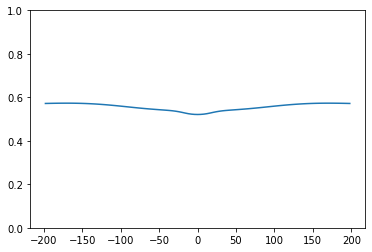

In [10]:
compz = np.trapz(comp, JK_comp)

plt.plot(z_comp, compz)
plt.ylim(0, 1)
plt.show()

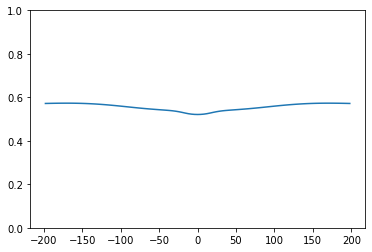

In [11]:
from scipy.interpolate import interp1d

compz_interp = interp1d(z_comp, compz, fill_value='extrapolate', kind="cubic")

plt.plot(z_comp, compz_interp(z_comp))
plt.ylim(0, 1)
plt.show()

In [12]:
data_spectral_dir = join(root_data_dir, "Spectral-Class")
data_spectral_dir

'/home2/s20321005/Thesis-Project/Data/Spectral-Class'

In [13]:
data_raw = vaex.open(join(data_spectral_dir, "thin-AG-extended-filtered.hdf5"))
data_raw

#,ra,dec,Jmag,Kmag,source_id,pm,pmra,e_pmra,pmdec,e_pmdec,parallax,e_parallax,gmag,bpmag,rpmag,GLON,GLAT,distance_gspphot,distance_gspphot_lower,distance_gspphot_upper,ag_gspphot,ag_gspphot_lower,ag_gspphot_upper,spectraltype_esphs,subclass_lamost,rv,e_rv,rv_cat,teff,e_teff_lower,e_teff_upper,teff_symmetric,teff_cat,logg,e_logg_lower,e_logg_upper,logg_symmetric,logg_cat,mh,e_mh_lower,e_mh_upper,mh_symmetric,mh_cat,alphafe,e_alphafe_lower,e_alphafe_upper,alphafe_symmetric,alphafe_cat,fem,e_fem_lower,e_fem_upper,fem_symmetric,fem_cat,feh,e_feh_lower,e_feh_upper,feh_symmetric,feh_cat,JK,M_J,Dist,z,r,pmlon,pmlat,e_pmlon,e_pmlat,vb,vphi,e_vb,e_vphi,w,e_w,v_xy,e_v_xy,v,e_v,u,e_u,M_J_lower,M_J_upper,u_LSR,v_LSR,w_LSR,f_D,f_TD,f_H,fTD_fD,fTD_fH,thin,thick,halo
0,3.83372316192759,-1.3546641595525872,7.983,7.709,5785893591413791744,52.468838,-27.305475724911407,0.013010484,-44.803907038303485,0.0125519615,10.003500713574486,0.011505191,8.828147,9.081575,8.412651,5.38788477490749,-0.2786023952335162,99.7305,99.6168,99.8465,0.0004,0.0,0.0011,F,--,16.716567993164062,0.18745452165603638,gaia,6170.4326171875,1.12109375,1.4296875,0.0,gspphot,4.239299774169922,0.0014996528625488281,0.0018000602722167969,0.0,gspphot,-0.15940000116825104,0.004700005054473877,0.005199998617172241,0.0,gspphot,0.23999999463558197,0.019999995827674866,0.01000000536441803,0.0,gspspec,nan,nan,nan,nan,--,nan,nan,nan,nan,--,0.2739997,2.983759838903925,99.96500511496205,-27.49159632329392,96.11042804623982,-43.511708623151314,-29.32081689098456,0.01293179855715879,0.012633013139513007,-13.89320359368533,-20.617332349851043,-0.017063228438634177,-0.024491251105190202,-17.954752079865358,0.05409963944417062,12.251188893990602,0.1802874939258216,23.750181221585272,0.11433970463041221,-3.3309029530010754,0.14152679531375228,1.931015012530676,3.422549281819965,-3.3309029530010754,23.750181221585272,-10.704752079865358,6.905373172511865e-07,1.2599324527838945e-07,1.242128754806905e-09,0.18245682330381394,101.43332145786746,True,False,False
1,3.827270854215892,-1.1413328443340007,9.075,8.72,5849737799294049408,33.233513,15.096121375811391,0.008829182,-29.60698601343225,0.013077091,7.761862754435309,0.013436575,10.059082,10.3660145,9.582395,5.4742000275581475,-0.0828207967040533,128.346,127.8518,128.9254,0.0692,0.0658,0.0826,G,--,68.40259552001953,0.18862959742546082,gaia,5864.75634765625,6.97265625,30.2685546875,0.0,gspphot,4.298500061035156,0.003200054168701172,0.011199951171875,0.0,gspphot,-0.34209999442100525,0.006900012493133545,0.019600003957748413,0.0,gspphot,0.18000000715255737,0.02000001072883606,0.019999995827674866,0.0,gspspec,-0.10000000149011612,0.14999999850988388,0.1100000012665987,0.0,gspspec,-0.10000000149011612,nan,nan,nan,--,0.35499954,3.5248296055634105,128.83505308420672,-10.658027575228331,128.3934474629295,2.084985296937152,-33.16804693834653,0.009625732972802784,0.012502401366350753,-20.25500159712633,1.2732549672866635,-0.035885086343476855,0.0062778765657406374,-25.844257078975943,0.039018331142753694,66.49251491416751,0.18800647404173246,44.97401889181693,0.12984776090651662,48.99197222546775,0.13610806369698816,2.4399851772656715,4.066397988698235,48.99197222546775,44.97401889181693,-18.594257078975943,1.2081950646993147e-08,2.6966985225558115e-08,6.001407660430157e-10,2.2320059081080115,44.93443330531096,True,False,False
2,3.8365084107078,-1.124264903059605,7.99,7.688,5850063632703452032,136.3025,-115.41101749515323,0.007777478,-72.5166878928762,0.013093553,9.26702172368321,0.013831709,8.920873,9.205091,8.46858,5.484650924968544,-0.06875462698467669,107.4739,107.3137,107.63,0.0004,1e-04,0.0012,F,--,-16.9925594329834,0.1674196422100067,gaia,5933.818359375,0.90869140625,1.35888671875,0.0,gspphot,4.207900047302246,0.0009002685546875,0.0008997917175292969,0.0,gspphot,-0.16369999945163727,0.0031000077724456787,0.003299996256828308,0.0,gspphot,0.10000000149011612,0.020000003278255463,0.009999997913837433,0.0,gspspec,-0.05000000074505806,0.08999999985098839

In [14]:
data = data_raw.filter("JK > 0").filter("JK < 0.32")
data = data.extract()
data

#,ra,dec,Jmag,Kmag,source_id,pm,pmra,e_pmra,pmdec,e_pmdec,parallax,e_parallax,gmag,bpmag,rpmag,GLON,GLAT,distance_gspphot,distance_gspphot_lower,distance_gspphot_upper,ag_gspphot,ag_gspphot_lower,ag_gspphot_upper,spectraltype_esphs,subclass_lamost,rv,e_rv,rv_cat,teff,e_teff_lower,e_teff_upper,teff_symmetric,teff_cat,logg,e_logg_lower,e_logg_upper,logg_symmetric,logg_cat,mh,e_mh_lower,e_mh_upper,mh_symmetric,mh_cat,alphafe,e_alphafe_lower,e_alphafe_upper,alphafe_symmetric,alphafe_cat,fem,e_fem_lower,e_fem_upper,fem_symmetric,fem_cat,feh,e_feh_lower,e_feh_upper,feh_symmetric,feh_cat,JK,M_J,Dist,z,r,pmlon,pmlat,e_pmlon,e_pmlat,vb,vphi,e_vb,e_vphi,w,e_w,v_xy,e_v_xy,v,e_v,u,e_u,M_J_lower,M_J_upper,u_LSR,v_LSR,w_LSR,f_D,f_TD,f_H,fTD_fD,fTD_fH,thin,thick,halo
0,3.83372316192759,-1.3546641595525872,7.983,7.709,5785893591413791744,52.468838,-27.305475724911407,0.013010484,-44.803907038303485,0.0125519615,10.003500713574486,0.011505191,8.828147,9.081575,8.412651,5.38788477490749,-0.2786023952335162,99.7305,99.6168,99.8465,0.0004,0.0,0.0011,F,--,16.716567993164062,0.18745452165603638,gaia,6170.4326171875,1.12109375,1.4296875,0.0,gspphot,4.239299774169922,0.0014996528625488281,0.0018000602722167969,0.0,gspphot,-0.15940000116825104,0.004700005054473877,0.005199998617172241,0.0,gspphot,0.23999999463558197,0.019999995827674866,0.01000000536441803,0.0,gspspec,nan,nan,nan,nan,--,nan,nan,nan,nan,--,0.2739997,2.983759838903925,99.96500511496205,-27.49159632329392,96.11042804623982,-43.511708623151314,-29.32081689098456,0.01293179855715879,0.012633013139513007,-13.89320359368533,-20.617332349851043,-0.017063228438634177,-0.024491251105190202,-17.954752079865358,0.05409963944417062,12.251188893990602,0.1802874939258216,23.750181221585272,0.11433970463041221,-3.3309029530010754,0.14152679531375228,1.931015012530676,3.422549281819965,-3.3309029530010754,23.750181221585272,-10.704752079865358,6.905373172511865e-07,1.2599324527838945e-07,1.242128754806905e-09,0.18245682330381394,101.43332145786746,True,False,False
1,3.8365084107078,-1.124264903059605,7.99,7.688,5850063632703452032,136.3025,-115.41101749515323,0.007777478,-72.5166878928762,0.013093553,9.26702172368321,0.013831709,8.920873,9.205091,8.46858,5.484650924968544,-0.06875462698467669,107.4739,107.3137,107.63,0.0004,1e-04,0.0012,F,--,-16.9925594329834,0.1674196422100067,gaia,5933.818359375,0.90869140625,1.35888671875,0.0,gspphot,4.207900047302246,0.0009002685546875,0.0008997917175292969,0.0,gspphot,-0.16369999945163727,0.0031000077724456787,0.003299996256828308,0.0,gspphot,0.10000000149011612,0.020000003278255463,0.009999997913837433,0.0,gspspec,-0.05000000074505806,0.08999999985098839,0.08999999985098839,1.0,gspspec,-0.05000000074505806,nan,nan,nan,--,0.30199957,2.8247006765791234,107.90953445639991,-7.41343576943442,107.65458000795614,-134.87852845762345,-19.650840779097557,0.008867571375788783,0.012381294828095314,-10.051231999907476,-68.9891794744853,-0.01628410014036548,-0.10307124821267057,-8.86008744652818,0.019905073774598003,-17.642936015281325,0.16702783167225732,37.108821789873446,0.1379640981235388,-60.775944428445264,0.1395990200188111,2.093707948627736,3.737417037516971,-60.775944428445264,37.108821789873446,-1.6100874465281798,4.192646925503346e-08,4.315075279272092e-08,7.70128373955551e-10,1.0292007306944997,56.030597303004214,True,False,False
2,3.831039194603873,-0.9514008442376365,7.186,6.977,5894221187876054656,84.86139,-77.52234794217705,0.018298868,-34.521593114845004,0.02365466,7.97013961564512,0.022740029,7.914826,8.1125,7.560436,5.551630769353478,0.09066343404984452,125.7671,125.1472,126.7522,0.0303,0.018,0.0442,F,--,-31.748979568481445,0.30476611852645874,gaia,6604.7900390625,24.5302734375,29.38427734375,0.0,gspphot,3.9031999111175537,0.004099845886230469,0.0055999755859375,0.0,gspphot,-0.9164000153541565,0.026300013065338135,0.06850004196166992,0.0,gspphot,nan,nan,nan,nan,--,nan,nan,nan,nan,--,nan,nan,nan,nan,--,0.20899963,1.69332951603442,125.46831651945382,11.359810

In [15]:
zss = data.z.to_numpy()
wss = data.w.to_numpy()
css = data.JK.to_numpy()

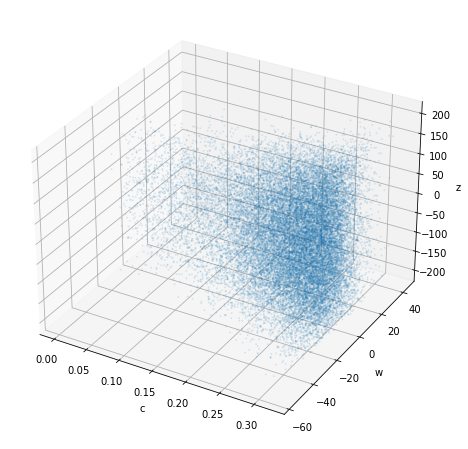

In [16]:
fig = plt.figure(figsize=(8,8))
ax = fig.add_subplot(111, projection='3d')
ax.scatter(css, wss, zss, s=1, alpha=0.1)
ax.set_zlabel("z")
ax.set_xlabel("c")
ax.set_ylabel("w")
plt.show()

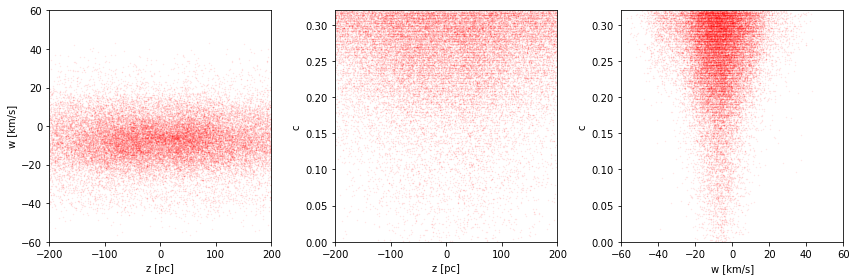

In [17]:
fig, axes = plt.subplots(1, 3, figsize=(12, 4))
# Fzw = np.trapz(F, c, axis=0)
# axes[0].contourf(Z[0, :, :], W[0, :, :], Fzw, 100)
axes[0].scatter(zss, wss, s=0.2, alpha=0.1, c="red")
axes[0].set_xlabel('z [pc]')
axes[0].set_ylabel('w [km/s]')
axes[0].set_xlim(-200,200)
axes[0].set_ylim(-60,60)
# Fzc = np.trapz(F, w, axis=1)
# axes[1].contourf(Z[:, 0, :], C[:, 0, :], np.log(Fzc), 100)
axes[1].scatter(zss, css, s=.2, alpha=0.1, c="red")
axes[1].set_xlabel('z [pc]')
axes[1].set_ylabel('c')
axes[1].set_xlim(-200,200)
axes[1].set_ylim(-0,.32)
# Fwc = np.trapz(F, w, axis=1)
# axes[2].contourf(W[:, :, 0], C[:, :, 0], np.log(Fwc), 100)
axes[2].scatter(wss, css, s=.2, alpha=0.1, c="red")
axes[2].set_xlabel('w [km/s]')
axes[2].set_ylabel('c')
axes[2].set_xlim(-60,60)
axes[2].set_ylim(-0,.32)
plt.tight_layout()
plt.title("Distribusi ")
plt.show()


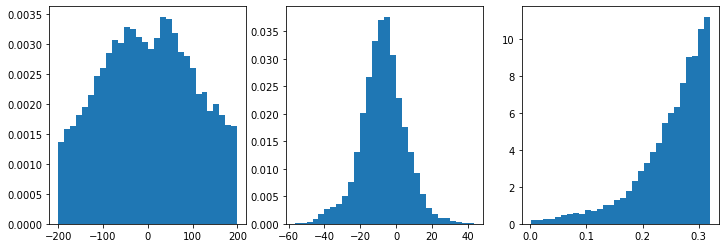

In [145]:
# Fzw = np.trapz(F, c, axis=0)
# Fz = np.trapz(Fzw, w, axis=0)
# area = np.trapz(Fz, z)
# Fz /= area
# Fw = np.trapz(Fzw, z, axis=1)
# area = np.trapz(Fw, w)
# Fw /= area
# Fc = np.trapz(np.trapz(F, z, axis=2), w, axis=1)
# area = np.trapz(Fc, c)
# Fc /= area
fig, axes = plt.subplots(1, 3, figsize=(12, 4))
# axes[0].plot(z, Fz)
axes[0].hist(zss, bins=30, density=True)
# axes[1].plot(w, Fw)
axes[1].hist(wss, bins=30, density=True)
# axes[2].plot(c, Fc)
axes[2].hist(css, bins=30, density=True)
plt.show()

In [ ]:
# test
zedge = np.linspace(-200, 200, 16)
wedge = np.linspace(-50, 50, 16)
cedge = np.linspace(0, 0.3, 16)

xnum, _ = np.histogramdd((css, wss, zss), bins=(cedge, wedge, zedge))

zmid = (zedge[1:] + zedge[:-1]) / 2
wmid = (wedge[1:] + wedge[:-1]) / 2
cmid = (cedge[1:] + cedge[:-1]) / 2

Wmid, Cmid, Zmid = np.meshgrid(wmid, cmid, zmid)

fig, axes = plt.subplots(1, 3, figsize=(12, 4))
Fzw = np.trapz(xnum, cmid, axis=0)
axes[0].contourf(Zmid[0, :, :], Wmid[0, :, :], Fzw, 100)
axes[0].set_xlabel('z')
axes[0].set_ylabel('w')
Fzc = np.trapz(xnum, wmid, axis=1)
axes[1].contourf(Zmid[:, 0, :], Cmid[:, 0, :], Fzc, 100)
axes[1].set_xlabel('z')
axes[1].set_ylabel('c')
Fwc = np.trapz(xnum, cmid, axis=2)
axes[2].contourf(Wmid[:, :, 0], Cmid[:, :, 0], Fwc, 100)
axes[2].set_xlabel('w')
axes[2].set_ylabel('c')
plt.tight_layout()
plt.show()

In [146]:
np.log(Nu0*.1)

-0.3025850929940456

In [238]:
data=(zss, wss, css)

# loc = dict(zsun=-50, w0=-15, log_a0=-30, log_rhoDM=np.log(0.001),
#            log_Nu0=np.log(1), log_sigma_0=np.log(1), atan_ma=0, 
#            atan_msigma=2*np.arctan(25)-np.pi/2, atan_b=2*np.arctan(13)-np.pi/2, R=3.4E-3)
# scale = dict(zsun=100, w0=10, log_a0=25, log_rhoDM=np.log(0.1/0.001),
#              log_Nu0=np.log(100/1), log_sigma_0=np.log(20/1), atan_ma=5E-4, 
#              atan_msigma=2*(np.pi/2-np.arctan(25)), atan_b=2*(np.pi/2-np.arctan(13)), R=0.6E-3)

loc = dict(zsun=-20, w0=-15, log_rhoDM=np.log(0.001), log_Nu0=np.log(1), 
           log_sigma_0=np.log(1), log_a0=-20, atan_ma=0, 
           atan_msigma=1.4, atan_b=1., R=3.4E-3)
scale = dict(zsun=40, w0=15, log_rhoDM=np.log(1/0.001), log_Nu0=np.log(1000/1), 
             log_sigma_0=np.log(20/1), log_a0=15,  atan_ma=5E-3, 
             atan_msigma=np.pi/2-1.40, atan_b=np.pi/2-1.0, R=0.6E-3)

priors=dict(loc=loc, scale=scale)

theta = np.array([zsun, w0, np.log(rhoDM), np.log(Nu0), np.log(sigma_0), np.log(a0), 
                  np.arctan(ma), np.arctan(msigma), np.arctan(b), R])
# theta = np.array([R])

theta_dict = {t: theta[i] for i, t in enumerate(theta_names)}

pars = dict(theta=theta_dict, **priors)
pars

{'theta': {'zsun': 10.0,
  'w0': -7.0,
  'log_rhoDM': -4.135166556742356,
  'log_Nu0': 2.0,
  'log_sigma_0': 1.6094379124341003,
  'log_a0': -10.819778284410283,
  'atan_ma': 9.999999999666668e-06,
  'atan_msigma': 1.5308176396716067,
  'atan_b': 1.4940244355251187,
  'R': 0.0034},
 'loc': {'zsun': -20,
  'w0': -15,
  'log_rhoDM': -6.907755278982137,
  'log_Nu0': 0.0,
  'log_sigma_0': 0.0,
  'log_a0': -20,
  'atan_ma': 0,
  'atan_msigma': 1.4,
  'atan_b': 1.0,
  'R': 0.0034},
 'scale': {'zsun': 40,
  'w0': 15,
  'log_rhoDM': 6.907755278982137,
  'log_Nu0': 6.907755278982137,
  'log_sigma_0': 2.995732273553991,
  'log_a0': 15,
  'atan_ma': 0.005,
  'atan_msigma': 0.17079632679489665,
  'atan_b': 0.5707963267948966,
  'R': 0.0006}}

In [229]:
# modify the compz

def nu_zc(z, c, **theta):
  b = theta['b']
  theta['sigma_w'] = theta['msigma']*c+theta['sigma_0']
  # nu_z = number_density(z, **theta)*comp(z)*Aexp(b, c, cmin, cmax) 
  nu_z = number_density(z, **theta)*Aexp(b, c)*compz_interp(z) 
  return nu_z

In [239]:
log_prior(**pars)

0.05850804390745701

In [240]:
theta = np.array([zsun, w0, np.log(rhoDM), np.log(Nu0), np.log(sigma_0), np.log(a0), 
                  np.arctan(ma), np.arctan(msigma), np.arctan(b), R])

theta_dict = {t: theta[i] for i, t in enumerate(theta_names)}
theta_dict['sigmaz'] = sigmaz
theta_dict['rhos'] = rhos
theta_dict['R'] = R
# theta_dict['a0'] = a0
theta_dict['a0'] = np.exp(theta_dict['log_a0'])
# theta_dict['rhoDM'] = rhoDM 
theta_dict['rhoDM'] = np.exp(theta_dict['log_rhoDM'])
theta_dict['sigmaDD'] = sigmaDD 
# theta_dict['sigmaDD'] = np.exp(theta_dict['log_sigmaDD'])
theta_dict['hDD'] = hDD 
# theta_dict['hDD'] = np.exp(theta_dict['log_hDD'])
# theta_dict['Nu0'] = Nu0
theta_dict['Nu0'] = np.exp(theta_dict['log_Nu0'])
# theta_dict['sigma_0'] = sigma_0 
theta_dict['sigma_0'] = np.exp(theta_dict['log_sigma_0'])
# theta_dict['ma'] = ma 
theta_dict['ma'] = np.tan(theta_dict['atan_ma'])
# theta_dict['msigma'] = msigma
theta_dict['msigma'] = np.tan(theta_dict['atan_msigma'])
# theta_dict['b'] = b 
theta_dict['b'] = np.tan(theta_dict['atan_b'])
log_likelihood(data, **theta_dict)

-8733.830383611206

In [222]:
theta = np.array([zsun-5, w0, np.log(rhoDM), np.log(Nu0), np.log(sigma_0), np.log(a0), 
                  np.arctan(ma), np.arctan(msigma), np.arctan(b), R])

theta_dict = {t: theta[i] for i, t in enumerate(theta_names)}
theta_dict['sigmaz'] = sigmaz
theta_dict['rhos'] = rhos
theta_dict['R'] = R
# theta_dict['a0'] = a0
theta_dict['a0'] = np.exp(theta_dict['log_a0'])
# theta_dict['rhoDM'] = rhoDM 
theta_dict['rhoDM'] = np.exp(theta_dict['log_rhoDM'])
theta_dict['sigmaDD'] = sigmaDD 
# theta_dict['sigmaDD'] = np.exp(theta_dict['log_sigmaDD'])
theta_dict['hDD'] = hDD 
# theta_dict['hDD'] = np.exp(theta_dict['log_hDD'])
# theta_dict['Nu0'] = Nu0
theta_dict['Nu0'] = np.exp(theta_dict['log_Nu0'])
# theta_dict['sigma_0'] = sigma_0 
theta_dict['sigma_0'] = np.exp(theta_dict['log_sigma_0'])
# theta_dict['ma'] = ma 
theta_dict['ma'] = np.tan(theta_dict['atan_ma'])
# theta_dict['msigma'] = msigma
theta_dict['msigma'] = np.tan(theta_dict['atan_msigma'])
# theta_dict['b'] = b 
theta_dict['b'] = np.tan(theta_dict['atan_b'])
log_likelihood(data, **theta_dict)

-8690.616418126654

In [241]:
theta = np.array([zsun, w0, np.log(rhoDM), np.log(Nu0), np.log(sigma_0), np.log(a0), 
                  np.arctan(ma), np.arctan(msigma), np.arctan(b), R])
log_posterior(theta, data, priors)

-8733.7718755673

In [224]:
theta = np.array([zsun-5, w0, np.log(rhoDM), np.log(Nu0), np.log(sigma_0), np.log(a0), 
                  np.arctan(ma), np.arctan(msigma), np.arctan(b), R])
log_posterior(theta, data, priors)

-8688.898497489454

In [242]:
loc = priors["loc"]
scale = priors["scale"]

ndim = len(theta_names)
nwalkers = np.floor(ndim*2.5).astype(int)

p0 = []
for t in theta_names:
  p0.append(np.random.uniform(loc[t], loc[t]+scale[t], size=nwalkers))
p0 = np.array(p0).T
p0[:3]

array([[ 1.38272107e+01, -8.63891635e+00, -5.56869496e+00,
         2.51204689e+00,  2.03443830e+00, -1.01948480e+01,
         1.99715485e-03,  1.49860874e+00,  1.40978168e+00,
         3.80674516e-03],
       [-1.47102442e+01, -1.31556641e+01, -4.51370284e+00,
         3.35956869e+00,  1.37292260e+00, -1.02427194e+01,
         2.52881458e-03,  1.43507594e+00,  1.18126873e+00,
         3.43817356e-03],
       [ 4.60845427e+00, -2.96632983e+00, -5.71419770e+00,
         6.19920440e+00,  2.57247479e+00, -1.06296584e+01,
         2.44609177e-03,  1.49967034e+00,  1.03508934e+00,
         3.83794107e-03]])

100%|██████████| 1000/1000 [21:54<00:00,  1.31s/it]


Multiprocessing took 1316.0 seconds


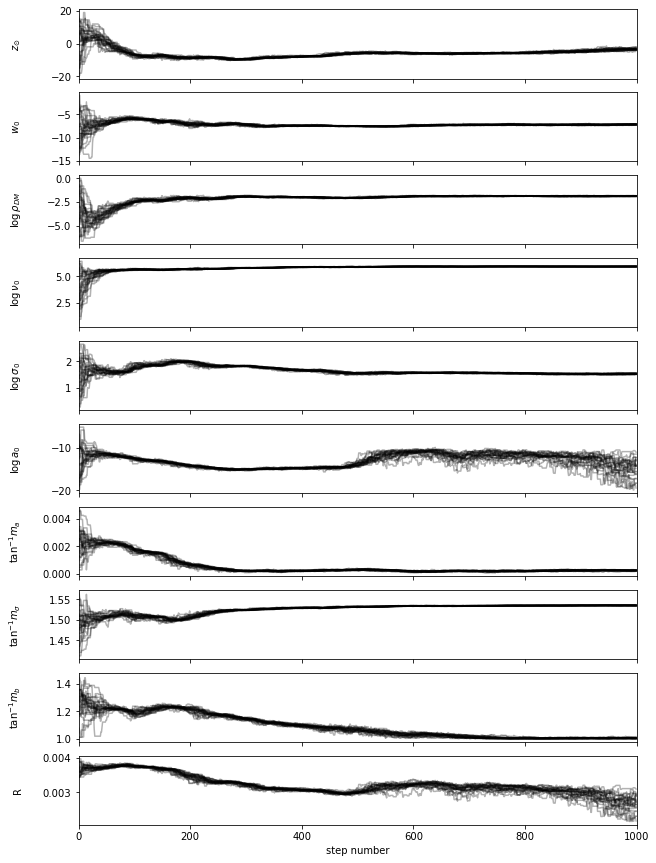

In [243]:
os.environ["OMP_NUM_THREADS"] = "16"
sampler_ = 0
labels = [r"$z_{\odot}$", r"$w_{0}$", r"$\log \rho_{DM}$", r"$\log \nu_{0}$", r"$\log \sigma_{0}$", 
          r"$\log a_0$", r"$\tan^{-1} m_a$", r"$\tan^{-1} m_{\sigma}$", r"$\tan^{-1} m_b$", "R"]

with Pool() as pool:
    sampler = emcee.EnsembleSampler(
        nwalkers, 
        ndim, 
        log_posterior, 
        args=[data, priors], 
        pool=pool
    )
    start = time.time()
    state = sampler.run_mcmc(p0, 1000, progress=True)
    end = time.time()
    multi_time = end - start
    plot_chain(sampler, labels, figsize=(10,15))
    print("Multiprocessing took {0:.1f} seconds".format(multi_time))
    sampler_ = sampler

In [176]:
samples = sampler.get_chain().copy()
samples[50:, :, :]

array([[[-1.58749114e+01, -5.94201852e+00, -6.44456403e+00, ...,
          1.54089211e+00,  1.43256860e+00,  3.83941834e-03],
        [-1.08853531e+01, -6.14544145e+00, -6.24550712e+00, ...,
          1.54059217e+00,  1.44093322e+00,  3.90371489e-03],
        [-5.43625136e+00, -5.29460251e+00, -2.96051083e+00, ...,
          1.51010694e+00,  1.47692507e+00,  3.68474528e-03],
        ...,
        [-9.26512908e+00, -4.97721898e+00, -3.10804444e+00, ...,
          1.52036354e+00,  1.46260306e+00,  3.74505124e-03],
        [-1.75125534e+01, -6.45577910e+00, -3.85460182e+00, ...,
          1.53665412e+00,  1.45231261e+00,  3.79415746e-03],
        [-1.26458623e+01, -5.81216328e+00, -4.26022146e+00, ...,
          1.53617949e+00,  1.45788708e+00,  3.82756408e-03]],

       [[-1.58749114e+01, -5.94201852e+00, -6.44456403e+00, ...,
          1.54089211e+00,  1.43256860e+00,  3.83941834e-03],
        [-1.08853531e+01, -6.14544145e+00, -6.24550712e+00, ...,
          1.54059217e+00,  1.44093322e

In [233]:
np.exp(-1.75)

0.17377394345044514

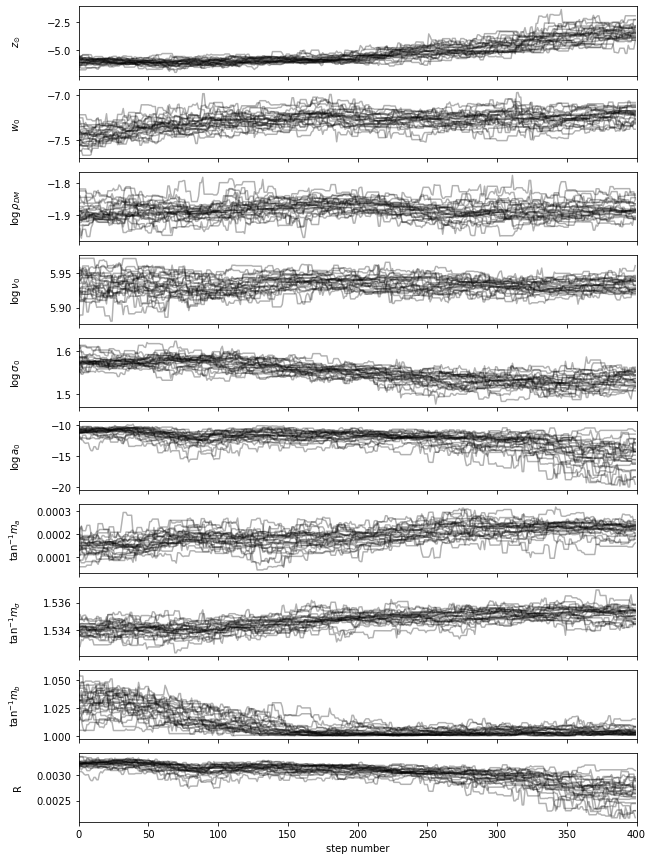

In [244]:
plot_chain(sampler, labels, figsize=(10,15), start=600)

100%|██████████| 5000/5000 [03:15<00:00, 25.59it/s]


Multiprocessing took 195.5 seconds


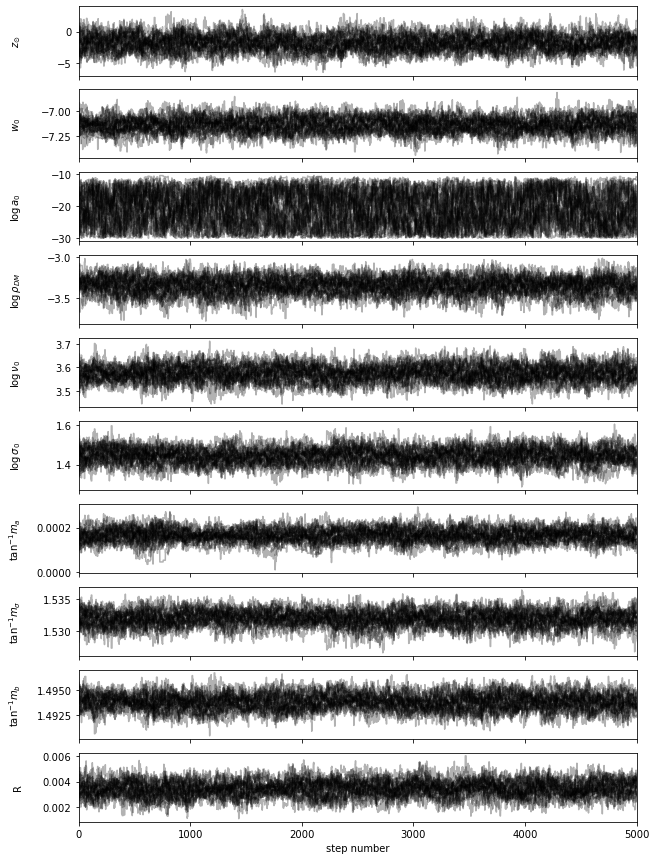

In [120]:
next_p0 = sampler_.get_chain()[-1]
with Pool() as pool:
    sampler = emcee.EnsembleSampler(
        nwalkers, 
        ndim, 
        log_posterior, 
        args=[data, priors], 
        pool=pool
    )
    start = time.time()
    state = sampler.run_mcmc(next_p0, 5000, progress=True)
    end = time.time()
    multi_time = end - start
    print("Multiprocessing took {0:.1f} seconds".format(multi_time))
    plot_chain(sampler, labels, figsize=(10,15), alpha=0.1)
    sampler_ = sampler

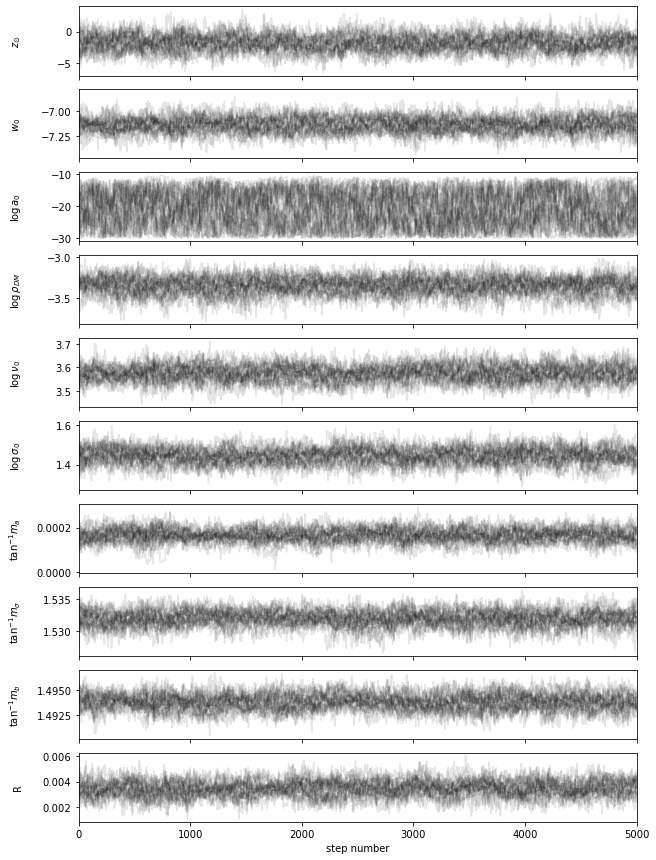

Text(0.5, 0.98, 'This is a somewhat long figure title')

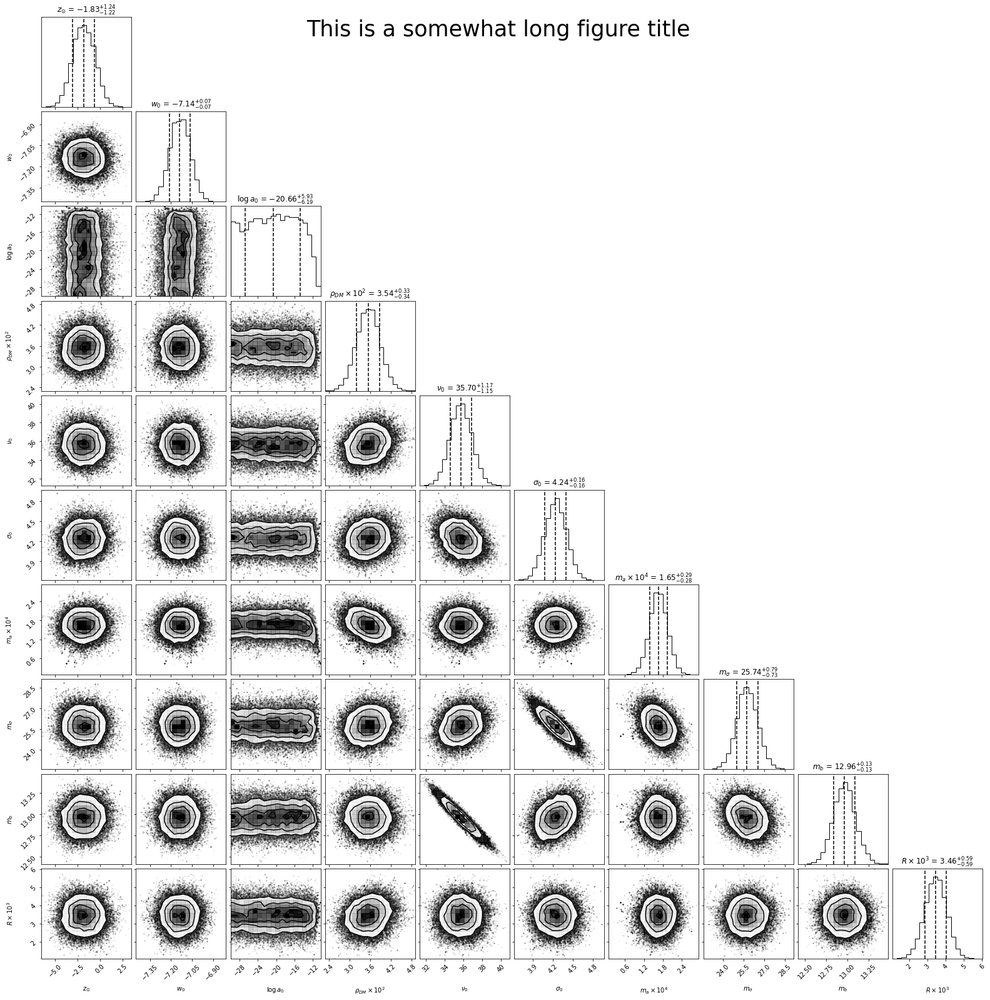

In [148]:
flat_samples = sampler_.get_chain(flat=True).copy()
flat_samples[:, 3:-4] = np.exp(flat_samples[:, 3:-4])
flat_samples[:, -4:-1] = np.tan(flat_samples[:, -4:-1])
# flat_samples[:, 2] = flat_samples[:, 2]/1E-5 # a0
flat_samples[:, 3] = flat_samples[:, 3]/1E-2 # rhoDM
flat_samples[:, -1] = flat_samples[:, -1]/1E-3 # R
flat_samples[:, 6] = flat_samples[:, 6]/1E-4 # ma

labels_2 = [r"$z_{\odot}$", r"$w_{0}$", r"$\log a_0$", r"$\rho_{DM}\times 10^{2}$", r"$\nu_{0}$", 
          r"$\sigma_{0}$", r"$m_a\times 10^{4}$", r"$m_{\sigma}$", r"$m_b$", r"$R \times 10^{3}$"]
fig = corner.corner(
  flat_samples, labels=labels_2,
  quantiles=[0.16, 0.5, 0.84],
  show_titles=True, 
  title_kwargs={"fontsize": 12},
)
fig.suptitle('This is a somewhat long figure title', fontsize=35)
# fig.savefig("corner.png", dpi=70)

In [124]:
chain = sampler_.get_chain()
# labels_2 = [r"$z_{\odot}$", r"$w_{0}$", r"$a_0 \times 10^{5}$", r"$\rho_{DM}\times 10^{2}$", r"$\nu_{0}$", 
#           r"$\sigma_{0}$", r"$m_a$", r"$m_{\sigma}$", r"$m_b$", r"$R \times 10^{3}$"]

# labels = [r"$z_{\odot}$", r"$w_{0}$", r"$\log a_0$", r"$\log \rho_{DM}$", r"$\log \nu_{0}$", 
#           r"$\log \sigma_{0}$", r"$\tan^{-1} m_a$", r"$\tan^{-1} m_{\sigma}$", r"$\tan^{-1} m_b$", "R"]
df = []
for i in range(nwalkers):
    df_new = vaex.from_dict({
        'zsun': chain[:, i, 0],
        'w0': chain[:, i, 1],
        'log_a0': chain[:, i, 2],
        'rhoDM': np.exp(chain[:, i, 3]),
        'Nu0': np.exp(chain[:, i, 4]),
        'sigma_0': np.exp(chain[:, i, 5]),
        'ma': np.tan(chain[:, i, 6]),
        'msigma': np.tan(chain[:, i, 7]),
        'mb': np.tan(chain[:, i, 8]),
        'walker': np.repeat(i, len(chain))
    })
    if len(df) == 0:
        df = df_new
    else:
        df = df.concat(df_new)

data_mcmc_dir = join(root_data_dir, "MCMC")
name = f"mcmc-AG-filtered-extended-real.hdf5"
df.export(join(data_mcmc_dir, name), progress=True)
print(name)
df

export(hdf5) [########################################] 100.00% elapsed time  :     0.07s =  0.0m =  0.0h
 mcmc-AG-filtered-extended-real.hdf5


#,zsun,w0,log_a0,rhoDM,Nu0,sigma_0,ma,msigma,mb,walker
0,-3.659038907568925,-7.0636476854713175,-22.99952844667422,0.03700071472622765,36.76501450520704,4.126518631814983,0.00011210488029689825,26.763572113986417,12.822667681577746,0
1,-3.659038907568925,-7.0636476854713175,-22.99952844667422,0.03700071472622765,36.76501450520704,4.126518631814983,0.00011210488029689825,26.763572113986417,12.822667681577746,0
2,-3.6514865430944075,-7.0468214089111285,-22.90136576227494,0.03689298211843312,37.16907765023857,4.12101201278561,0.00010563182319152794,26.80555123696992,12.781321854732955,0
3,-3.6514865430944075,-7.0468214089111285,-22.90136576227494,0.03689298211843312,37.16907765023857,4.12101201278561,0.00010563182319152794,26.80555123696992,12.781321854732955,0
4,-3.6514865430944075,-7.0468214089111285,-22.90136576227494,0.03689298211843312,37.16907765023857,4.12101201278561,0.00010563182319152794,26.80555123696992,12.781321854732955,0
...,...,...,...,...,...,...,...,...,...,...
"124,995",-3.1472349673690143,-7.0224647255190416,-20.83337044039386,0.029356808205947438,35.66638058272375,4.450442229160712,0.00019399530067366018,24.441487285907467,12.948371442972315,24
"124,996",-3.1472349673690143,-7.0224647255190416,-20.83337044039386,0.029356808205947438,35.66638058272375,4.450442229160712,0.00019399530067366018,24.441487285907467,12.948371442972315,24
"124,997",-2.1398751273297973,-7.074660267916721,-20.313388163261425,0.034195628965239484,36.062212805581865,4.392782521334455,0.00018996804694806316,25.021428635018854,12.91806019405036,24
"124,998",-2.062095494762354,-7.061143086408709,-20.918064607506956,0.03421568962207815,35.82556242676934,4.447411460501696,0.0001956231253217799,24.818640238988532,12.943258844303193,24


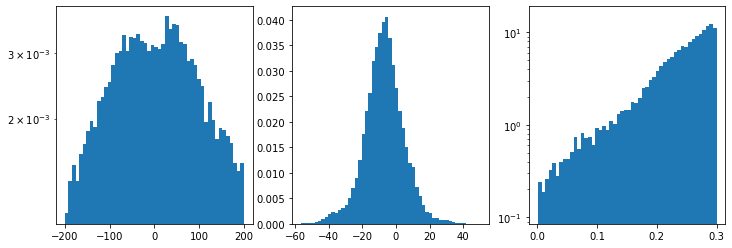

In [141]:
# TODO: overplot
z = np.linspace(-200, 200, 100)
w = np.linspace(-50, 50, 100)
c = np.linspace(0, 0.3, 100)

W, C, Z = np.meshgrid(w, c, z)

thetas = sampler_.get_chain(flat=True).copy()

fig, axes = plt.subplots(1, 3, figsize=(12, 4))
for i in range(1000):
  index = np.random.randint(0, len(thetas))
  theta_dict = {t: thetas[index][i] for i, t in enumerate(theta_names)}
  theta_dict['sigmaz'] = sigmaz
  theta_dict['rhos'] = rhos
  theta_dict['a0'] = np.exp(theta_dict['log_a0'])
  theta_dict['rhoDM'] = np.exp(theta_dict['log_rhoDM'])
  theta_dict['sigmaDD'] = 0 
  theta_dict['hDD'] = hDD 
  theta_dict['Nu0'] = np.exp(theta_dict['log_Nu0'])
  theta_dict['sigma_0'] = np.exp(theta_dict['log_sigma_0'])
  theta_dict['ma'] = np.tan(theta_dict['atan_ma'])
  theta_dict['msigma'] = np.tan(theta_dict['atan_msigma'])
  theta_dict['b'] = np.tan(theta_dict['atan_b'])
  F = density_pdf(Z, W, C, **theta_dict)
  Fzw = np.trapz(F, c, axis=0)
  Fz = np.trapz(Fzw, w, axis=0)
  area = np.trapz(Fz, z)
  Fz /= area
  Fw = np.trapz(Fzw, z, axis=1)
  area = np.trapz(Fw, w)
  Fw /= area
  Fc = np.trapz(np.trapz(F, z, axis=2), w, axis=1)
  area = np.trapz(Fc, c)
  Fc /= area
  axes[0].plot(z, Fz, alpha=0.001, c='r')
  axes[1].plot(w, Fw, alpha=0.001, c='r')
  axes[2].plot(c, Fc, alpha=0.001, c='r')
  
axes[0].hist(zss, bins=50, density=True)  
axes[0].set_yscale('log')
axes[1].hist(wss, bins=50, density=True)
axes[2].hist(css, bins=50, density=True)
axes[2].set_yscale('log')
plt.show()

BIN =  7


100%|██████████| 1000/1000 [00:33<00:00, 29.57it/s]


Multiprocessing took 33.9 seconds


100%|██████████| 5000/5000 [02:46<00:00, 29.96it/s]


Multiprocessing took 33.9 seconds
export(hdf5) [########################################] 100.00% elapsed time  :     0.12s =  0.0m =  0.0h
 mcmc-AG-filtered-extended-7.hdf5
BIN =  8


100%|██████████| 1000/1000 [00:33<00:00, 29.73it/s]


Multiprocessing took 33.7 seconds


100%|██████████| 5000/5000 [02:49<00:00, 29.44it/s]


Multiprocessing took 33.7 seconds
export(hdf5) [########################################] 100.00% elapsed time  :     0.11s =  0.0m =  0.0h
 mcmc-AG-filtered-extended-8.hdf5
BIN =  9


100%|██████████| 1000/1000 [00:34<00:00, 29.12it/s]


Multiprocessing took 34.4 seconds


100%|██████████| 5000/5000 [02:50<00:00, 29.29it/s]


Multiprocessing took 34.4 seconds
export(hdf5) [########################################] 100.00% elapsed time  :     0.10s =  0.0m =  0.0h
 mcmc-AG-filtered-extended-9.hdf5
BIN =  10


100%|██████████| 1000/1000 [00:35<00:00, 28.53it/s]


Multiprocessing took 35.1 seconds


100%|██████████| 5000/5000 [02:54<00:00, 28.67it/s]


Multiprocessing took 35.1 seconds
export(hdf5) [########################################] 100.00% elapsed time  :     0.08s =  0.0m =  0.0h
 mcmc-AG-filtered-extended-10.hdf5
BIN =  11


100%|██████████| 1000/1000 [00:35<00:00, 27.93it/s]


Multiprocessing took 35.9 seconds


100%|██████████| 5000/5000 [02:59<00:00, 27.86it/s]


Multiprocessing took 35.9 seconds
export(hdf5) [########################################] 100.00% elapsed time  :     0.11s =  0.0m =  0.0h
 mcmc-AG-filtered-extended-11.hdf5
BIN =  12


100%|██████████| 1000/1000 [00:37<00:00, 26.88it/s]


Multiprocessing took 37.3 seconds


100%|██████████| 5000/5000 [03:03<00:00, 27.29it/s]


Multiprocessing took 37.3 seconds
export(hdf5) [########################################] 100.00% elapsed time  :     0.10s =  0.0m =  0.0h
 mcmc-AG-filtered-extended-12.hdf5
BIN =  13


100%|██████████| 1000/1000 [00:37<00:00, 26.69it/s]


Multiprocessing took 37.6 seconds


100%|██████████| 5000/5000 [03:06<00:00, 26.75it/s]


Multiprocessing took 37.6 seconds
export(hdf5) [########################################] 100.00% elapsed time  :     0.10s =  0.0m =  0.0h
 mcmc-AG-filtered-extended-13.hdf5
BIN =  14


100%|██████████| 1000/1000 [00:39<00:00, 25.60it/s]


Multiprocessing took 39.2 seconds


100%|██████████| 5000/5000 [03:14<00:00, 25.66it/s]


Multiprocessing took 39.2 seconds
export(hdf5) [########################################] 100.00% elapsed time  :     0.08s =  0.0m =  0.0h
 mcmc-AG-filtered-extended-14.hdf5


BIN =  15


100%|██████████| 1000/1000 [00:39<00:00, 25.20it/s]


Multiprocessing took 39.8 seconds


100%|██████████| 5000/5000 [03:18<00:00, 25.19it/s]


Multiprocessing took 39.8 seconds
export(hdf5) [########################################] 100.00% elapsed time  :     0.12s =  0.0m =  0.0h
 mcmc-AG-filtered-extended-15.hdf5


BIN =  16


100%|██████████| 1000/1000 [00:41<00:00, 24.39it/s]


Multiprocessing took 41.1 seconds


100%|██████████| 5000/5000 [03:24<00:00, 24.48it/s]


Multiprocessing took 41.1 seconds
export(hdf5) [########################################] 100.00% elapsed time  :     0.11s =  0.0m =  0.0h
 mcmc-AG-filtered-extended-16.hdf5
BIN =  17


100%|██████████| 1000/1000 [00:43<00:00, 23.09it/s]


Multiprocessing took 43.4 seconds


100%|██████████| 5000/5000 [03:35<00:00, 23.22it/s]


Multiprocessing took 43.4 seconds
export(hdf5) [########################################] 100.00% elapsed time  :     0.10s =  0.0m =  0.0h
 mcmc-AG-filtered-extended-17.hdf5
BIN =  18


100%|██████████| 1000/1000 [00:45<00:00, 22.17it/s]


Multiprocessing took 45.2 seconds


100%|██████████| 5000/5000 [03:44<00:00, 22.29it/s]


Multiprocessing took 45.2 seconds
export(hdf5) [########################################] 100.00% elapsed time  :     0.10s =  0.0m =  0.0h
 mcmc-AG-filtered-extended-18.hdf5
BIN =  19


100%|██████████| 1000/1000 [00:47<00:00, 21.25it/s]


Multiprocessing took 47.2 seconds


100%|██████████| 5000/5000 [03:52<00:00, 21.46it/s]


Multiprocessing took 47.2 seconds
export(hdf5) [########################################] 100.00% elapsed time  :     0.10s =  0.0m =  0.0h
 mcmc-AG-filtered-extended-19.hdf5


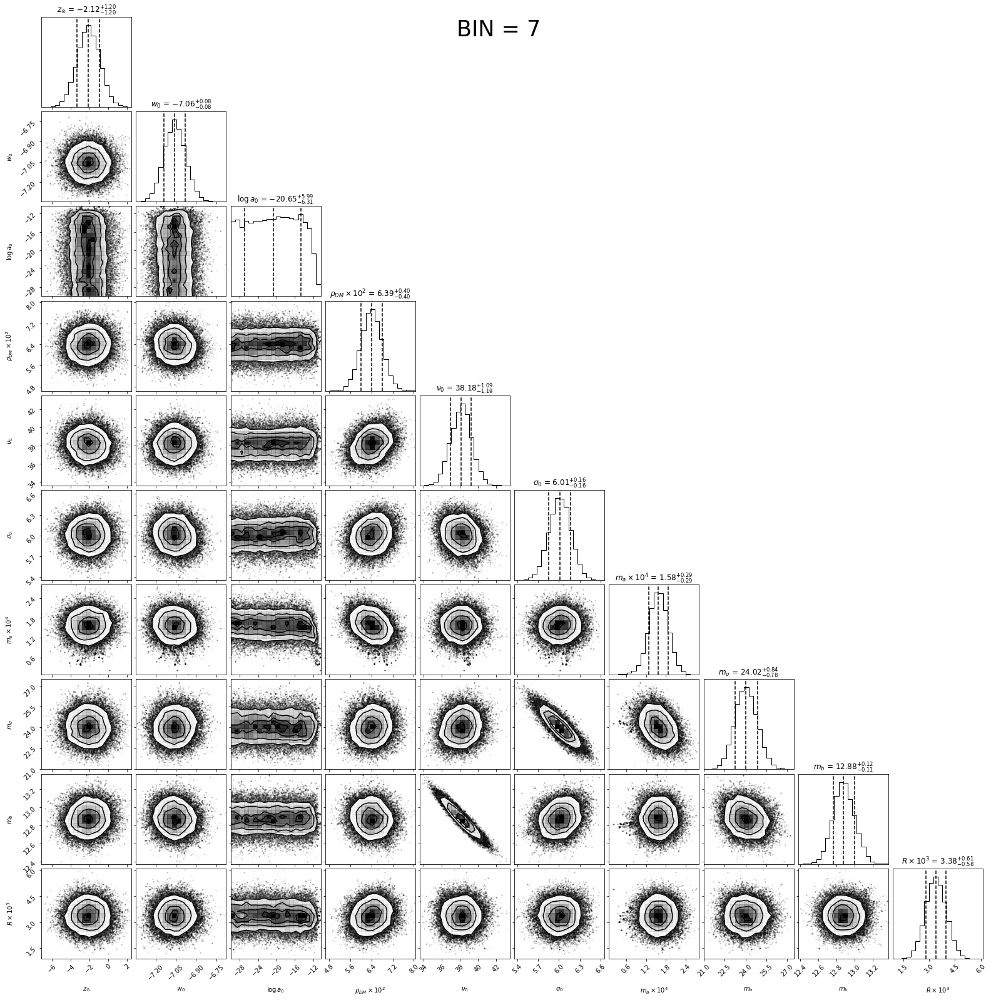

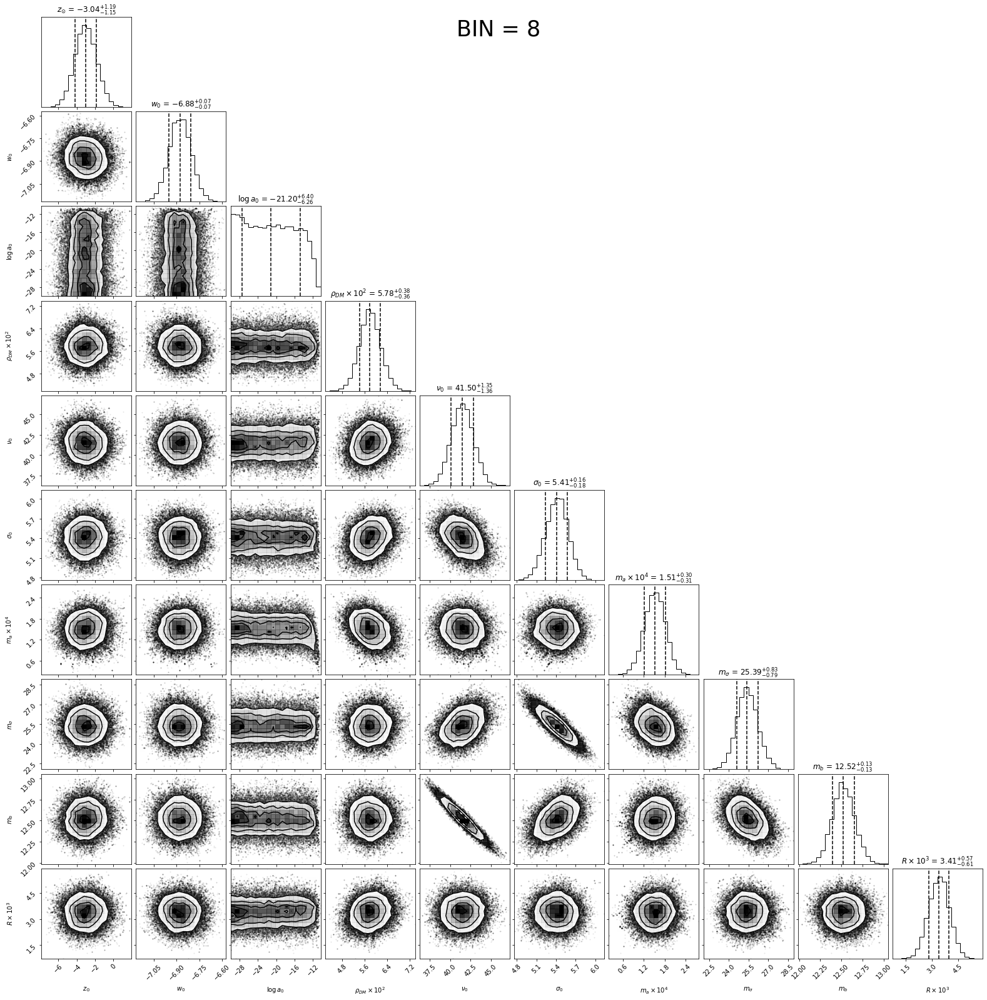

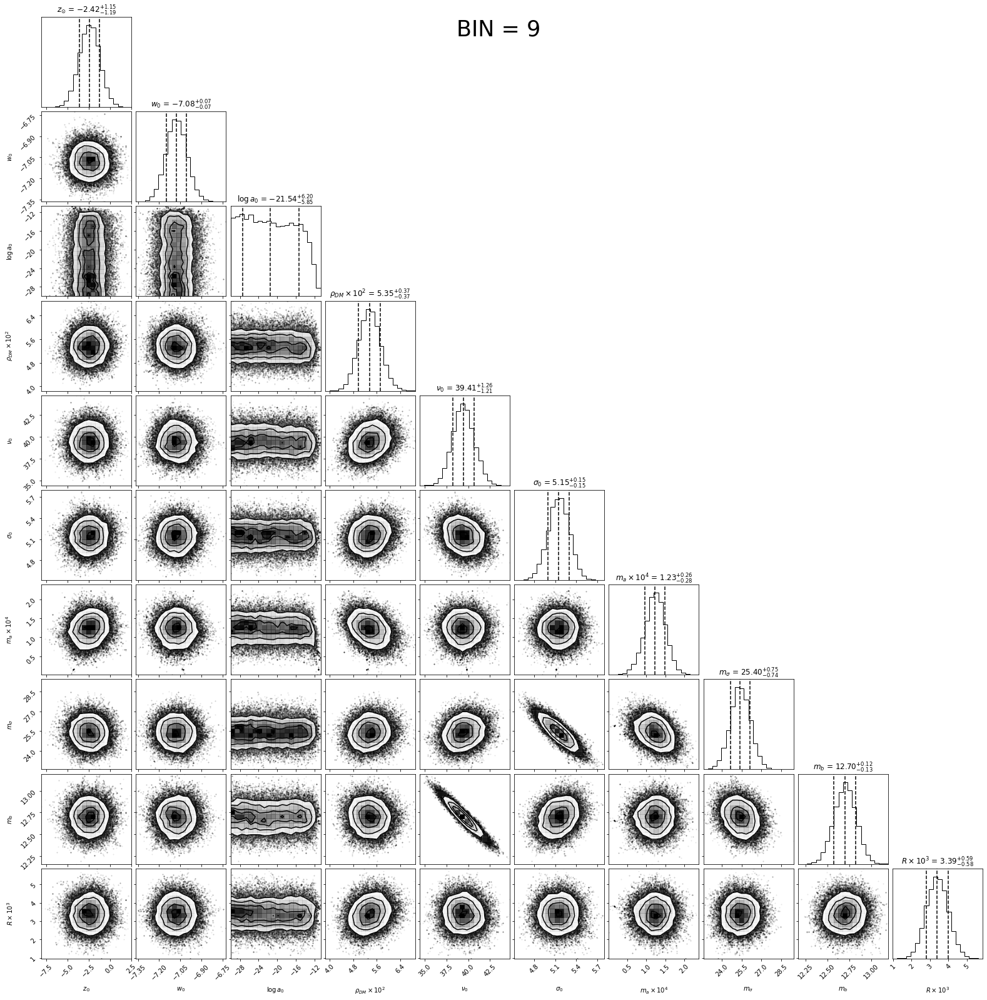

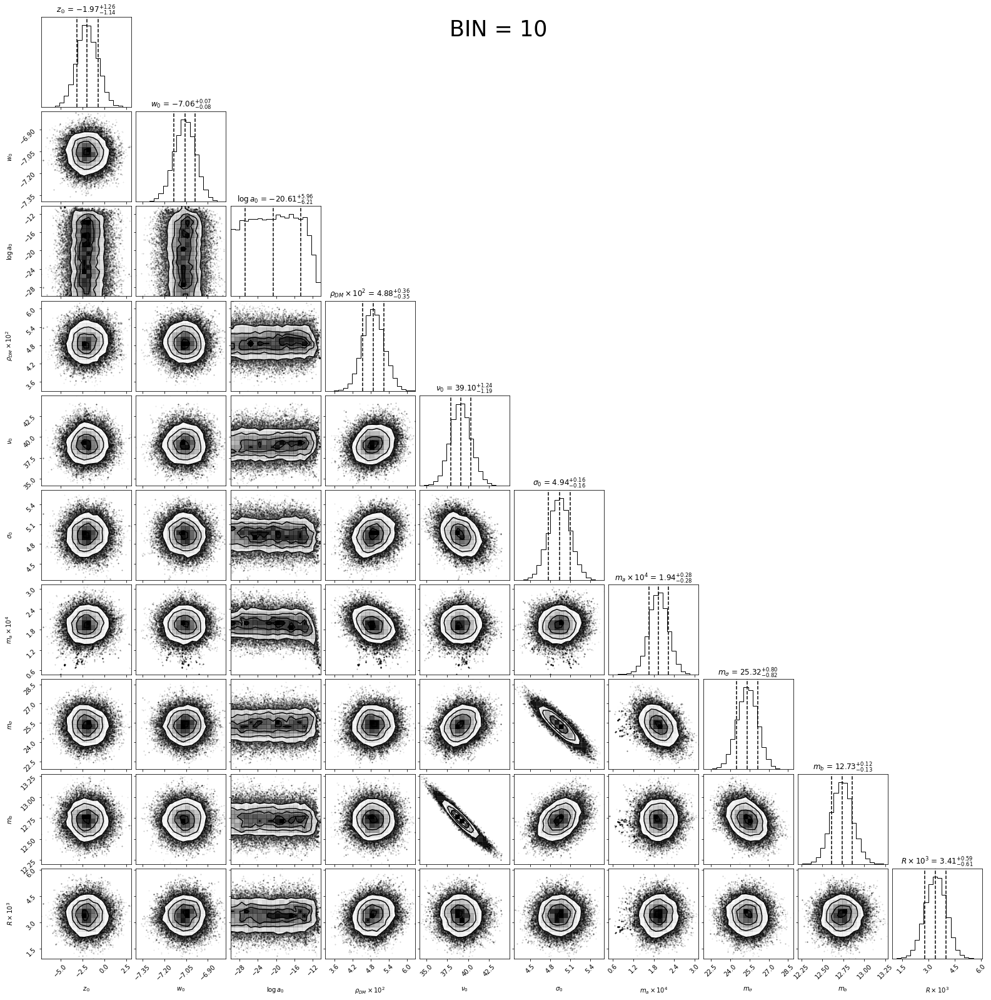

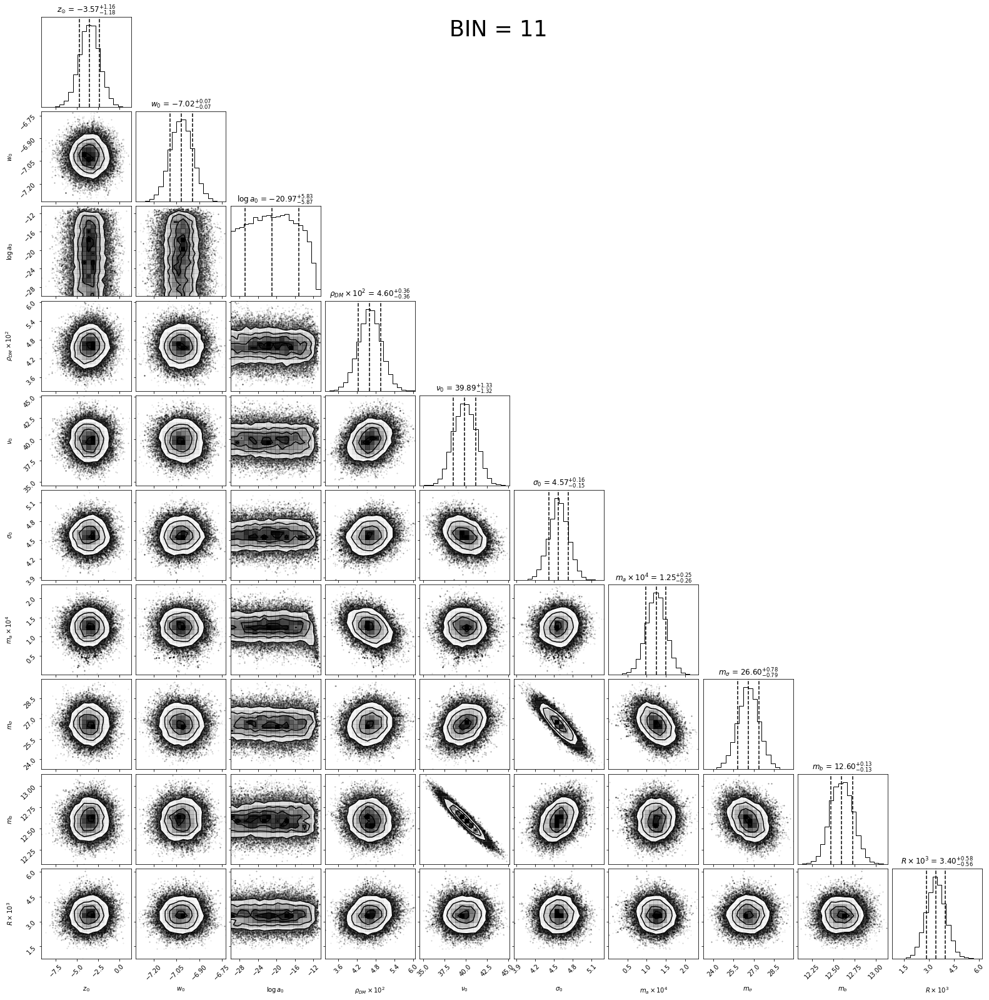

...

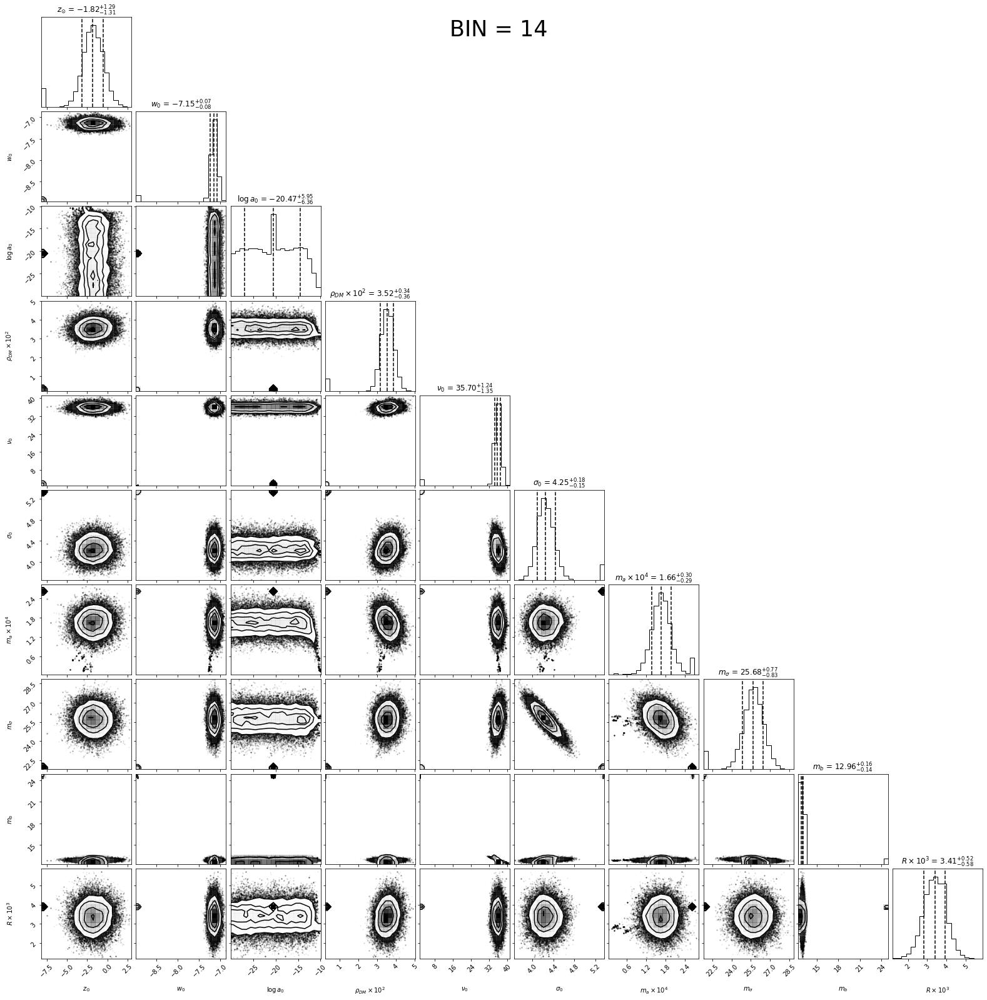

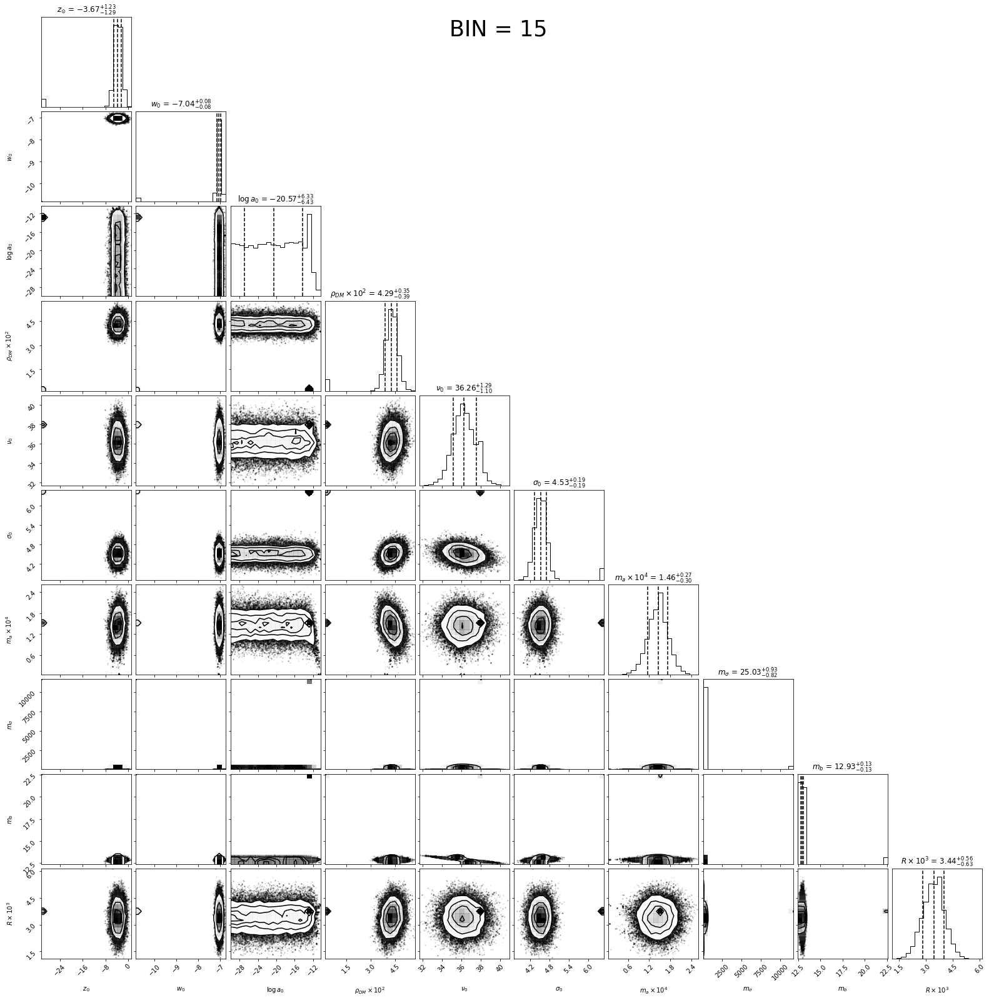

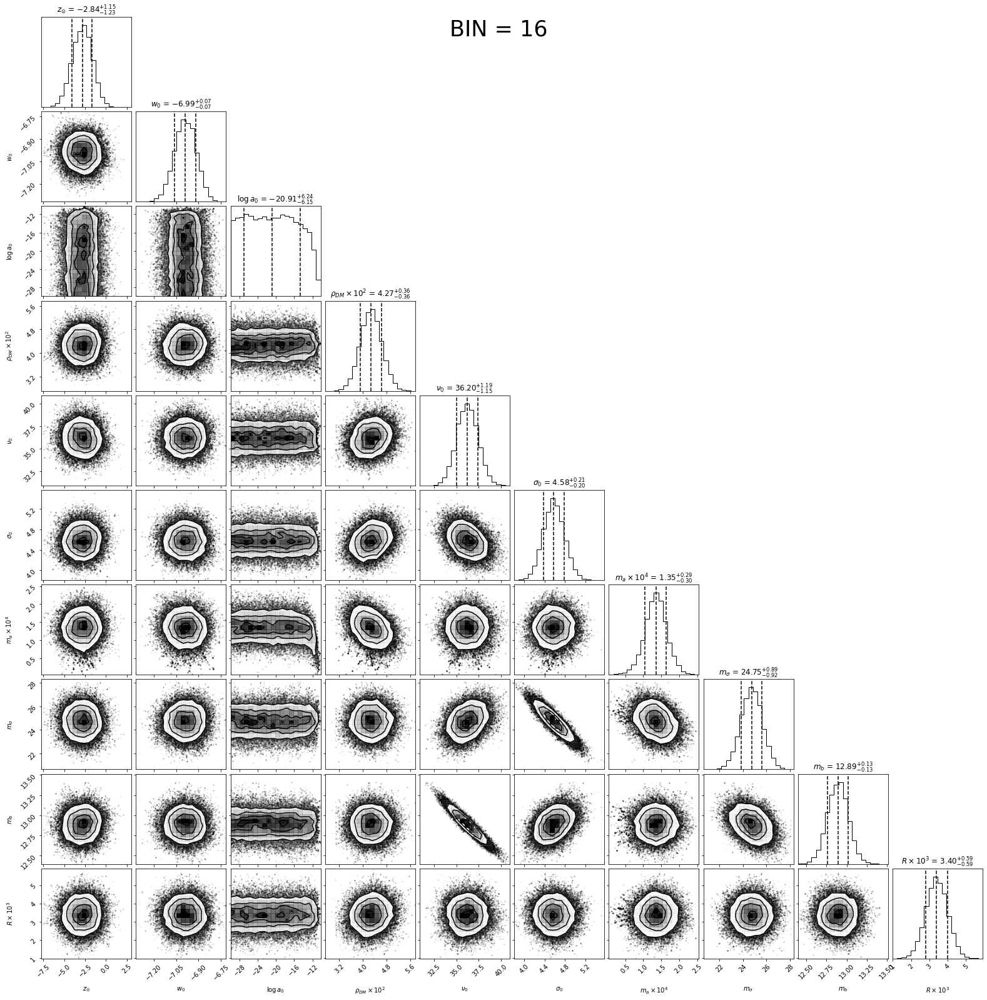

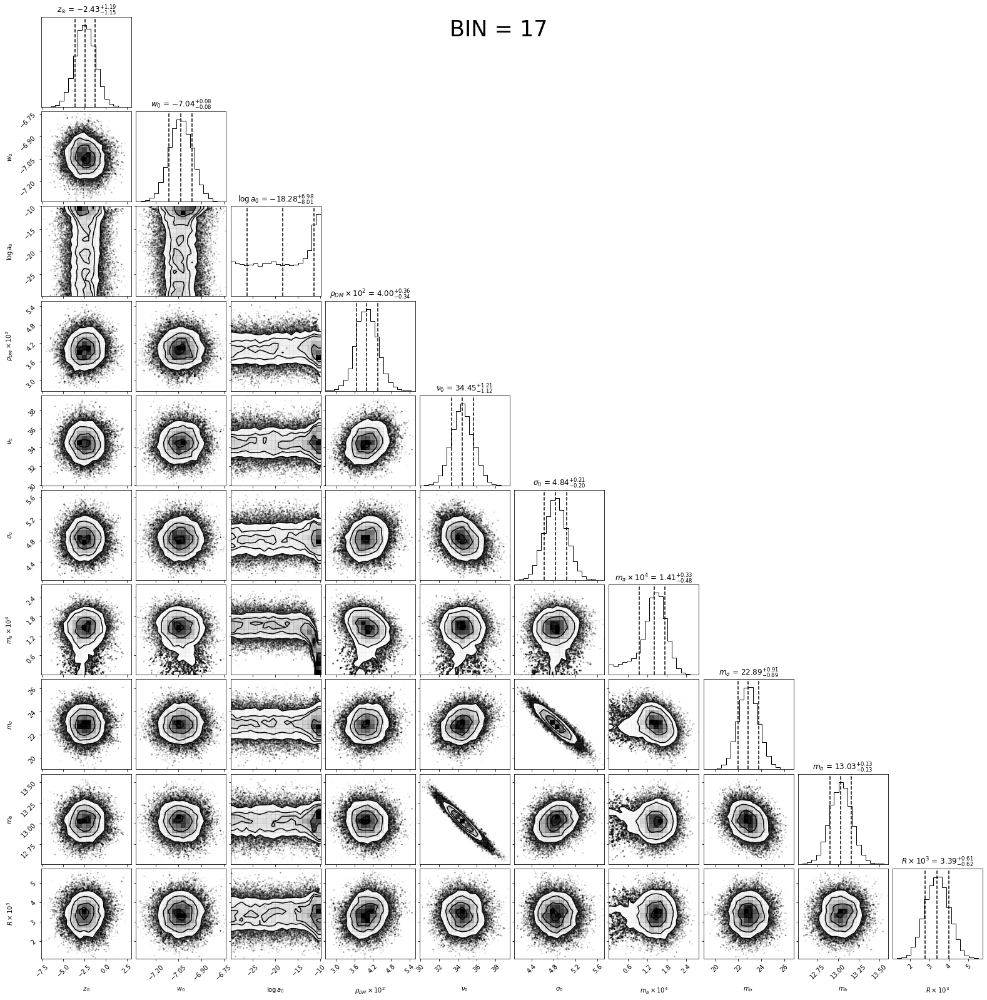

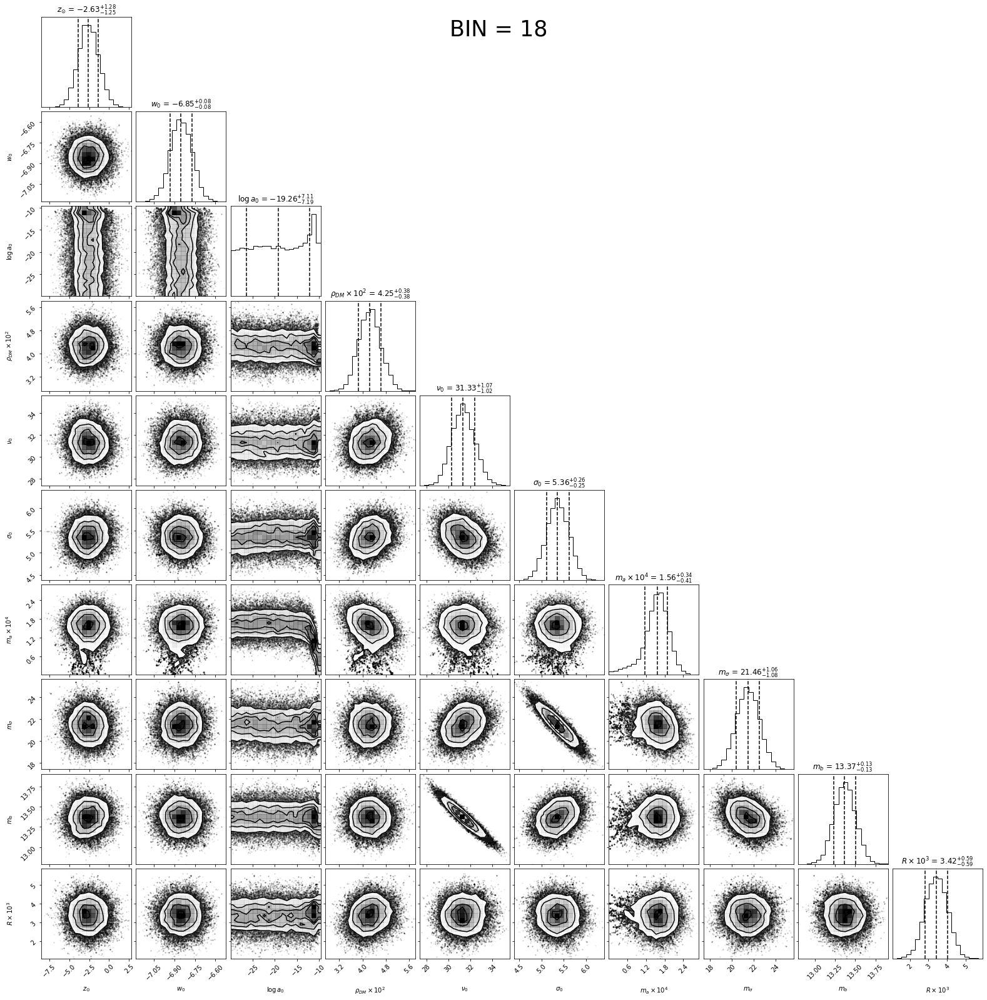

In [ ]:
# test for bin size
os.environ["OMP_NUM_THREADS"] = "16"
data_mcmc_dir = join(root_data_dir, "MCMC")
for BIN in range(7, 20):
  zedge = np.linspace(-200, 200, BIN)
  wedge = np.linspace(-50, 50, BIN)
  cedge = np.linspace(0, 0.3, BIN)

  xnum, _ = np.histogramdd((css, wss, zss), bins=(cedge, wedge, zedge))
  xedge = (zedge, wedge, cedge)
  xerr = np.sqrt(xnum)

  data=(xnum, xedge, xerr)

  loc = dict(zsun=-50, w0=-15, log_a0=-30, log_rhoDM=np.log(0.001),
             log_Nu0=np.log(1), log_sigma_0=np.log(1), atan_ma=0, 
             atan_msigma=2*np.arctan(25)-np.pi/2, atan_b=2*np.arctan(13)-np.pi/2, R=3.4E-3)
  scale = dict(zsun=100, w0=10, log_a0=25, log_rhoDM=np.log(0.1/0.001),
               log_Nu0=np.log(100/1), log_sigma_0=np.log(20/1), atan_ma=5E-4, 
               atan_msigma=2*(np.pi/2-np.arctan(25)), atan_b=2*(np.pi/2-np.arctan(13)), R=0.6E-3)

  priors=dict(loc=loc, scale=scale)

  theta = np.array([zsun, w0, np.log(a0), np.log(rhoDM), np.log(Nu0), np.log(sigma_0), 
                    np.arctan(ma), np.arctan(msigma), np.arctan(b), R])

  theta_dict = {t: theta[i] for i, t in enumerate(theta_names)}
  
  loc = priors["loc"]
  scale = priors["scale"]

  ndim = len(theta_names)
  nwalkers = np.floor(ndim*2.5).astype(int)

  p0 = []
  for t in theta_names: p0.append(np.random.uniform(loc[t], loc[t]+scale[t], size=nwalkers))
  p0 = np.array(p0).T
  
  sampler_ = 0
  print("BIN = ", BIN)
  with Pool() as pool:
    sampler = emcee.EnsembleSampler(
        nwalkers, 
        ndim, 
        log_posterior, 
        args=[data, priors], 
        pool=pool
    )
    start = time.time()
    state = sampler.run_mcmc(p0, 1000, progress=True)
    end = time.time()
    multi_time = end - start
    print("Multiprocessing took {0:.1f} seconds".format(multi_time))
    sampler.reset()
    start = time.time()
    sampler.run_mcmc(state, 5000, progress=True)
    end = time.time()
    print("Multiprocessing took {0:.1f} seconds".format(multi_time))
    multi_time = end - start
    sampler_ = sampler
  # SAVE
  chain = sampler_.get_chain()
  df = []
  for i in range(nwalkers):
      df_new = vaex.from_dict({
          'zsun': chain[:, i, 0],
          'w0': chain[:, i, 1],
          'log_a0': chain[:, i, 2],
          'rhoDM': np.exp(chain[:, i, 3]),
          'Nu0': np.exp(chain[:, i, 4]),
          'sigma_0': np.exp(chain[:, i, 5]),
          'ma': np.tan(chain[:, i, 6]),
          'msigma': np.tan(chain[:, i, 7]),
          'mb': np.tan(chain[:, i, 8]),
          'walker': np.repeat(i, len(chain))
      })
      if len(df) == 0:
          df = df_new
      else:
          df = df.concat(df_new)
  name = f"mcmc-AG-filtered-extended-{BIN}.hdf5"
  df.export(join(data_mcmc_dir, name), progress=True)
  print(name)
  # PLOT  
  flat_samples = sampler_.get_chain(flat=True)
  flat_samples[:, 3:-4] = np.exp(flat_samples[:, 3:-4])
  flat_samples[:, -4:-1] = np.tan(flat_samples[:, -4:-1])
  flat_samples[:, 3] = flat_samples[:, 3]/1E-2 # rhoDM
  flat_samples[:, -1] = flat_samples[:, -1]/1E-3 # R
  flat_samples[:, 6] = flat_samples[:, 6]/1E-4 # ma

  labels_2 = [r"$z_{\odot}$", r"$w_{0}$", r"$\log a_0$", r"$\rho_{DM}\times 10^{2}$", r"$\nu_{0}$", 
            r"$\sigma_{0}$", r"$m_a\times 10^{4}$", r"$m_{\sigma}$", r"$m_b$", r"$R \times 10^{3}$"]
  fig = corner.corner(
    flat_samples, labels=labels_2,
    quantiles=[0.16, 0.5, 0.84],
    show_titles=True, 
    title_kwargs={"fontsize": 12},
  )
  fig.suptitle(f'BIN = {BIN}', fontsize=35)